# Imports and Settings

The following cell **imports the needed functions, models and packages**

In order to run the code, please substitute:
```
project_root = r'C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code'
```
with your absolute path to the code folder


In [2]:
import sys
import os

project_root = r'C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code'
if project_root not in sys.path:
    sys.path.insert(0, project_root)

# Now you can do an absolute import (no relative)
from models import *
from models import SRYOLO
import yaml
import torch.multiprocessing as mp
import pandas as pd
import matplotlib.pyplot as plt
# wandb config
import wandb
from dotenv import load_dotenv
load_dotenv()
from wandb.integration.ultralytics import add_wandb_callback
from ultralytics import YOLO
from collections import Counter

from evaluation import detect_images

# Initialize your Weights & Biases environment
!yolo settings wandb=True

cwd = os.getcwd()
dataset_root_folder = os.path.join(cwd, "../../dataset")
images_to_test_path = os.path.join(dataset_root_folder, "yolov9", "qualitative_analysis", "input")

# Function to plot losses and metrics
def plot_metrics(data, figsize=(12, 10), cls_weight=0.5, box_weight=7.5, dfl_weight=1.5):
    """
    Funzione per creare un plot delle perdite (Losses) di training e validazione su una griglia 2x2.

    Args:
        data (DataFrame): Un DataFrame contenente i dati da plottare.
        figsize (tuple): Dimensione della figura (larghezza, altezza).
        title (str): Titolo principale della figura.
    """
    # Graphs configuration

    train_loss = box_weight * data['train/box_loss'] + cls_weight * data['train/cls_loss'] + dfl_weight * data['train/dfl_loss']
    val_loss = box_weight * data['val/box_loss'] + cls_weight * data['val/cls_loss'] + dfl_weight * data['val/dfl_loss']
    map50 = data['metrics/mAP50(B)']

    fig, axes = plt.subplots(2, 1, figsize=figsize)

    # Plot training and validation losses
    axes[0].plot(data['epoch'], train_loss, label='Train Loss', color='blue')
    axes[0].plot(data['epoch'], val_loss, label='Validation Loss', color='red')
    axes[0].set_title('Training and Validation Losses')
    axes[0].set_xlabel('Epoch')
    axes[0].set_ylabel('Loss')
    axes[0].legend()
    axes[0].grid(True)
    
    # Plot mAP50
    axes[1].plot(data['epoch'], map50, label='mAP50', color='green')
    axes[1].set_title('mAP50')
    axes[1].set_xlabel('Epoch')
    axes[1].set_ylabel('mAP50')
    axes[1].legend()
    axes[1].grid(True)
    axes[1].set_ylim(0, 1)  


    # Layout
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

def plot_dataset(dataset_root):
    """
    Analyzes a YOLO dataset and plots the image distribution per split (train, valid, test)
    and the class distribution.

    Args:
        dataset_root (str): Path to the root of the YOLO dataset (should include 'train', 'valid', and 'test').
    """
    # Path to the YAML file
    yaml_path = os.path.join(dataset_root, "data.yaml")

    # Check if YAML file exists
    if not os.path.exists(yaml_path):
        raise FileNotFoundError(f"'data.yaml' file not found in {dataset_root}")

    # Read class names from the YAML file
    with open(yaml_path, 'r') as file:
        data_config = yaml.safe_load(file)
        class_names = data_config['names']

    # Subdirectories for train, valid, and test
    splits = ['train', 'valid', 'test']

    # Image distribution and class counts
    image_distribution = {}
    class_counts = Counter()

    for split in splits:
        labels_dir = os.path.join(dataset_root, split, "labels")

        # Count images
        if os.path.exists(labels_dir):
            num_images = len([f for f in os.listdir(labels_dir) if os.path.isfile(os.path.join(labels_dir, f))])
            image_distribution[split] = num_images

        # Count classes
        if os.path.exists(labels_dir):
            for label_file in os.listdir(labels_dir):
                label_path = os.path.join(labels_dir, label_file)
                try:
                    with open(label_path, 'r') as file:
                        for line in file:
                            class_id = line.split()[0]
                            class_counts[class_id] += 1
                except PermissionError:
                    print(f"Permission denied for file: {label_path}")
                except Exception as e:
                    print(f"Error with file {label_path}: {e}")

    # Plot image distribution
    plt.figure(figsize=(10, 5))
    plt.bar(image_distribution.keys(), image_distribution.values(), color='skyblue')
    plt.title("Image Distribution per Split")
    plt.xlabel("Split")
    plt.ylabel("Number of Images")
    plt.show()

    # Plot class distribution
    plt.figure(figsize=(10, 5))
    class_ids = [int(cid) for cid in class_counts.keys()]
    frequencies = [class_counts[cid] for cid in class_counts.keys()]
    class_labels = [class_names[cid] for cid in class_ids]

    # Add value frequency on top of each bar
    bars = plt.bar(class_labels, frequencies, color='salmon')
    for bar, freq in zip(bars, frequencies):
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), str(freq),
                ha='center', va='bottom', fontsize=10)

    plt.title("Class Distribution")
    plt.xlabel("Classes")
    plt.ylabel("Frequency")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

def plot_confusion_matrix(matrix_path):
    matrix = plt.imread(matrix_path)
    plt.figure(figsize=(10, 10))
    plt.imshow(matrix)
    plt.axis('off')
    plt.show()



C:\Users\siani\AppData\Roaming\Python\Python310\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
wandb: WARNING This integration is tested and supported for ultralytics v8.0.238 and below.
wandb: WARNING             Please report any issues to https://github.com/wandb/wandb/issues with the tag `yolov8`.


JSONDict("C:\Users\siani\AppData\Roaming\Ultralytics\settings.json"):
{
  "settings_version": "0.0.6",
  "datasets_dir": "C:\\Users\\siani\\PycharmProjects\\AIxFootballAnalysis\\src\\training\\datasets",
  "weights_dir": "weights",
  "runs_dir": "runs",
  "uuid": "4164f6bf860d8010f015d455e8afd5ad6b00d6918e89b195fad8e40aabf4e174",
  "sync": true,
  "api_key": "",
  "openai_api_key": "",
  "clearml": true,
  "comet": true,
  "dvc": true,
  "hub": true,
  "mlflow": true,
  "neptune": true,
  "raytune": true,
  "tensorboard": true,
  "wandb": true,
  "vscode_msg": true
}
💡 Learn more about Ultralytics Settings at https://docs.ultralytics.com/quickstart/#ultralytics-settings


# Dataset Description

The dataset used in this project consists of images captured by a _VIP Tactical Camera_. These images are taken from a fixed point of view — the VIP grandstand — which provides a comprehensive view of both teams on the field. This vantage point is particularly valuable for in-depth soccer match analysis.

Due to their strategic importance, such images are typically not publicly available, making datasets of this kind quite rare and difficult to obtain.

Throughout the notebook, we will refer to two different versions of the dataset:

1. **Baseline**: A manually annotated version of the dataset created by us, with no offline augmentations applied. However, online augmentations will be performed during training.
2. **Copy-paste Augmented**: An enhanced version of the baseline dataset where offline copy-paste augmentation has been applied to increase data variability (detailed description in the specific section)

## Baseline Version


The **Baseline** version consists of **645** raw images. Approximately half of these images were sourced from the publicly available dataset at:  
[https://universe.roboflow.com/project/football-players-detection-3zvbc/dataset/2](https://universe.roboflow.com/project/football-players-detection-3zvbc/dataset/2)  
The remaining images were manually annotated by us to enrich and balance the dataset.

Our curated dataset can be accessed here:  
[https://app.roboflow.com/emasengineeringworkspace/aixfootballanalysis/6](https://app.roboflow.com/emasengineeringworkspace/aixfootballanalysis/6)

### Dataset Split

The dataset is divided as follows:
- **Training**: 510 images  
- **Validation**: 75 images  
- **Test**: 60 images


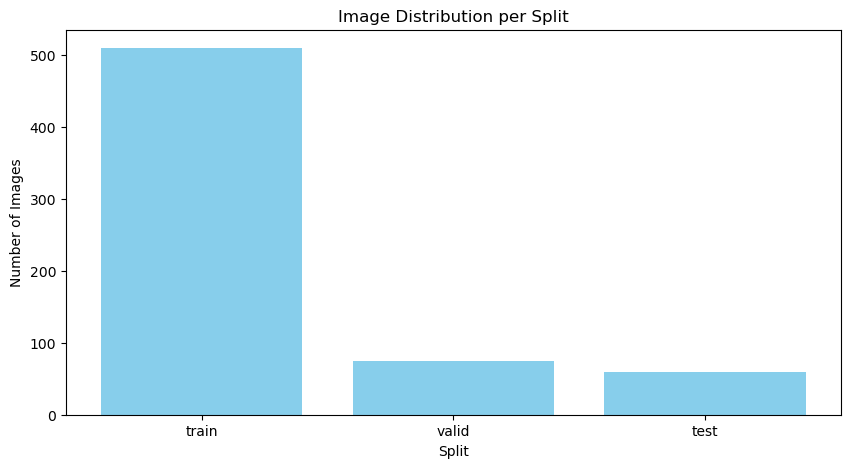

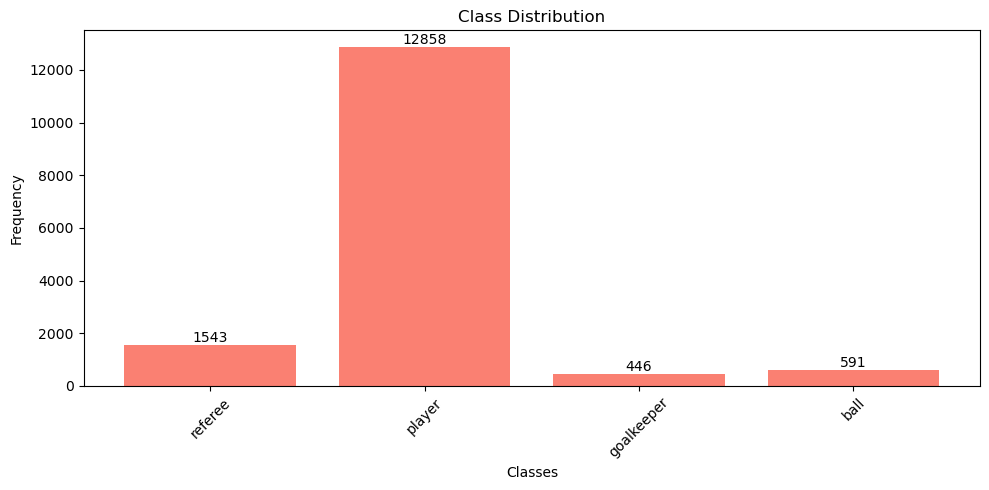

In [2]:
dataset_path = os.path.join(dataset_root_folder, "yolov9", "baseline")
plot_dataset(dataset_path)

## Copy-paste-augmented Version

The **Copy-paste-augmented** version is created by applying a custom copy-paste augmentation to the baseline dataset.  
*This augmentation works by extracting segmented ball objects from annotated images and randomly pasting them into new images with alpha blending. To each augmented sample, 3 to 6 balls are pasted*.

Code to run the copy-paste augmentation can be found at:
```
code/utils/copy_paste_segmentation_utils.py
```

while the dataset is located at:
```
dataset/yolov9/copy-paste-augmented
```

**N.B.:** In the dataset folder you can also find a `segmented_dataset`. This is not used for training; it is only needed to generate the copy-paste augmented version, as it contains a subset of training images from the baseline dataset in which only the balls have been labeled to be later extracted for augmentation.

### Dataset Split

The dataset is divided as follows:
- **Training**: 1530 images  
- **Validation**: 75 images (same as baseline, no augmentation applied)  
- **Test**: 60 images (same as baseline, no augmentation applied)

**Example of the resulting augmentation**

![Image 1](../../dataset\yolov9\copy-paste-augmented\train\images\573e61_5_9_png_jpg.rf.74635905a76827536d69ac2eec02a6fb.jpg)

![Image 2](../../dataset\yolov9\copy-paste-augmented\train\images\aug_1_573e61_5_9_png_jpg.rf.74635905a76827536d69ac2eec02a6fb.jpg)




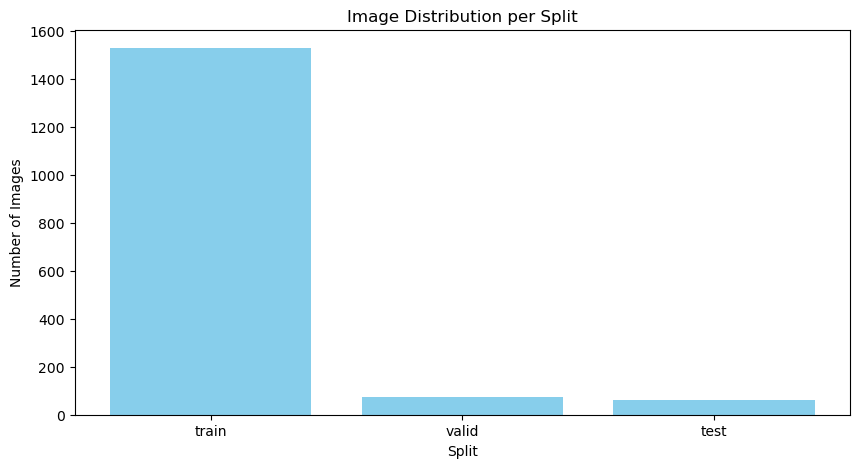

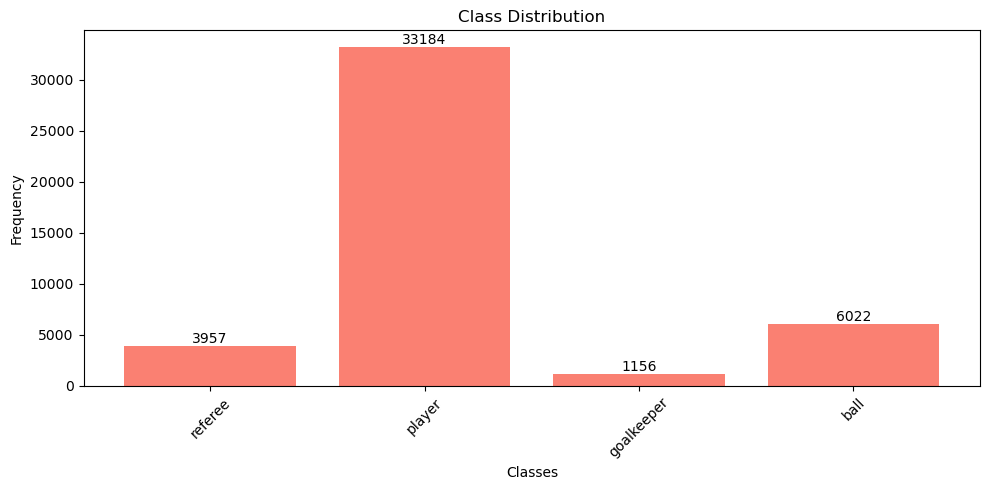

In [3]:
mp.freeze_support()  # Necessario su Windows
dataset_path = os.path.join(dataset_root_folder, "yolov9", "copy-paste-augmented")
plot_dataset(dataset_path)


# YOLO Version Comparison on Baseline Dataset

As the initial step of our analysis, we evaluate the performance of different YOLO versions on the baseline dataset.  
We consider the following YOLO models, each trained using their default settings and hyperparameters:

1. YOLO8L  
2. YOLO9c  
3. YOLO5L  

Quantitative results are assessed on the test split, while qualitative analysis is performed on 3 representative samples selected from the test set.

## YOLO v8L

In [ ]:
mp.freeze_support()  # Necessario su Windows
model = YOLO("yolov8l.pt")
model = model.cuda()
# print current path
dataset_path = os.path.join(dataset_root_folder, "yolov8", "baseline")

c:\Users\siani\.conda\envs\torch_gpu_clone\lib\site-packages\torch\nn\modules\module.py:1050: UserWarning: expandable_segments not supported on this platform (Triggered internally at C:\cb\pytorch_1000000000000\work\c10/cuda/CUDAAllocatorConfig.h:28.)
  return self._apply(lambda t: t.cuda(device))


In [ ]:
model.train(data=os.path.join(dataset_path, "data.yaml"), epochs=50, imgsz=640, save=True, project="yolo_football_analysis", name="yolo8L_dataset_baseline")

New https://pypi.org/project/ultralytics/8.3.78 available  Update with 'pip install -U ultralytics'
engine\trainer: task=detect, mode=train, model=yolov8l.pt, data=c:\Users\siani\PycharmProjects\AIxFootballAnalysis\src\training\../../dataset\yolov8\v0\data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda:0, workers=8, project=yolo_football_analysis, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save

wandb: Currently logged in as: sianiemanuele (sianiemanuele_07) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed 


train: Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov8\v0\train\labels.cache... 510 images, 0 backgrounds, 0 corrupt: 100%|██████████| 510/510 [00:00<?, ?it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov8\v0\train\labels.cache... 510 images, 0 backgrounds, 0 corrupt: 100%|██████████| 510/510 [00:00<?, ?it/s]
val: Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov8\v0\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov8\v0\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]


Plotting labels to yolo_football_analysis\train\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0005), 103 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to yolo_football_analysis\train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      10.4G      1.379      1.838     0.8405        613        640: 100%|██████████| 32/32 [08:31<00:00, 15.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.98s/it]


                   all         75       1796      0.245      0.308      0.209      0.125

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      10.1G      1.339     0.9143     0.8262        720        640: 100%|██████████| 32/32 [09:32<00:00, 17.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:17<00:00,  5.88s/it]


                   all         75       1796      0.245      0.308      0.209      0.125

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      10.3G       1.38     0.8181       0.83        532        640: 100%|██████████| 32/32 [08:29<00:00, 15.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:17<00:00,  5.90s/it]


                   all         75       1796      0.238       0.02     0.0202     0.0123

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      10.2G      1.325     0.7318     0.8214        550        640: 100%|██████████| 32/32 [08:04<00:00, 15.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:17<00:00,  5.85s/it]


                   all         75       1796      0.371      0.349      0.149     0.0727

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      10.1G      1.262     0.6651     0.8171        511        640: 100%|██████████| 32/32 [08:02<00:00, 15.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.51s/it]


                   all         75       1796      0.801      0.578      0.613      0.381

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      10.2G      1.245     0.6275     0.8153        520        640: 100%|██████████| 32/32 [08:33<00:00, 16.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:17<00:00,  5.89s/it]


                   all         75       1796      0.716       0.59      0.622      0.382

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      10.2G      1.281     0.6346     0.8197        586        640: 100%|██████████| 32/32 [07:48<00:00, 14.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.53s/it]


                   all         75       1796      0.798      0.589      0.646      0.383

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      10.2G      1.327     0.6804     0.8189        459        640: 100%|██████████| 32/32 [07:37<00:00, 14.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.43s/it]


                   all         75       1796      0.877      0.607      0.678      0.417

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      10.2G      1.203     0.6086      0.812        543        640: 100%|██████████| 32/32 [08:04<00:00, 15.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.25s/it]


                   all         75       1796      0.846      0.641      0.705      0.445

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      10.2G      1.161     0.5833     0.8088        652        640: 100%|██████████| 32/32 [08:39<00:00, 16.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.32s/it]


                   all         75       1796       0.86      0.626      0.693      0.421

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      10.1G      1.134     0.5562     0.8071        671        640: 100%|██████████| 32/32 [09:02<00:00, 16.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.57s/it]


                   all         75       1796       0.86      0.649      0.701      0.437

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      10.2G      1.154     0.5703     0.8086        689        640: 100%|██████████| 32/32 [08:43<00:00, 16.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.61s/it]


                   all         75       1796      0.844      0.629      0.692      0.387

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      10.1G      1.147     0.5637      0.806        548        640: 100%|██████████| 32/32 [08:59<00:00, 16.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:17<00:00,  5.68s/it]


                   all         75       1796      0.867      0.688      0.742      0.452

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      10.2G        1.1     0.5357     0.8025        552        640: 100%|██████████| 32/32 [08:20<00:00, 15.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.58s/it]


                   all         75       1796       0.94      0.674      0.734      0.468

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      10.1G      1.139     0.5435     0.8034        471        640: 100%|██████████| 32/32 [08:08<00:00, 15.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.61s/it]


                   all         75       1796      0.869      0.671      0.729      0.452

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      10.2G      1.101     0.5306     0.8039        702        640: 100%|██████████| 32/32 [09:09<00:00, 17.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.57s/it]


                   all         75       1796      0.813      0.713      0.748       0.46

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      10.2G      1.072     0.5149     0.8001        490        640: 100%|██████████| 32/32 [08:14<00:00, 15.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.11s/it]


                   all         75       1796      0.839        0.7      0.748      0.468

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      10.2G      1.057     0.5011     0.8004        751        640: 100%|██████████| 32/32 [08:10<00:00, 15.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.09s/it]


                   all         75       1796      0.811      0.694      0.729       0.46

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      10.1G      1.061     0.5061     0.7986        578        640: 100%|██████████| 32/32 [08:20<00:00, 15.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.56s/it]


                   all         75       1796       0.79      0.658      0.706      0.425

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      10.1G      1.044     0.4993     0.7974        580        640: 100%|██████████| 32/32 [07:34<00:00, 14.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.29s/it]


                   all         75       1796      0.913      0.678      0.757      0.478

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      10.1G      1.053     0.4958     0.7982        690        640: 100%|██████████| 32/32 [07:36<00:00, 14.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.35s/it]


                   all         75       1796      0.865      0.717      0.756      0.468

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      10.2G      1.105     0.5213     0.7995        610        640: 100%|██████████| 32/32 [07:28<00:00, 14.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.47s/it]


                   all         75       1796      0.889      0.699      0.758      0.476

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      10.3G      1.017     0.4838     0.7956        465        640: 100%|██████████| 32/32 [07:45<00:00, 14.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.38s/it]


                   all         75       1796      0.862      0.724      0.778      0.508

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      10.2G      1.021     0.4796     0.7942        694        640: 100%|██████████| 32/32 [07:31<00:00, 14.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.54s/it]


                   all         75       1796      0.904      0.686      0.747      0.471

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      10.1G     0.9932     0.4695     0.7971        530        640: 100%|██████████| 32/32 [07:53<00:00, 14.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.17s/it]


                   all         75       1796      0.862      0.714      0.758      0.492

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      10.1G      1.015     0.4721     0.7959        447        640: 100%|██████████| 32/32 [08:03<00:00, 15.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.23s/it]


                   all         75       1796      0.952      0.708      0.767      0.504

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      10.3G     0.9856     0.4616     0.7948        503        640: 100%|██████████| 32/32 [07:44<00:00, 14.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.18s/it]


                   all         75       1796      0.928      0.722      0.779      0.505

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      10.2G      0.994     0.4618     0.7944        527        640: 100%|██████████| 32/32 [06:57<00:00, 13.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.95s/it]


                   all         75       1796       0.92      0.715      0.782      0.498

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      10.2G     0.9788     0.4535     0.7934        520        640: 100%|██████████| 32/32 [08:07<00:00, 15.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.64s/it]


                   all         75       1796      0.878      0.744      0.788      0.496

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      10.1G     0.9899     0.4569     0.7941        494        640: 100%|██████████| 32/32 [07:43<00:00, 14.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.05s/it]


                   all         75       1796      0.873      0.701      0.764      0.487

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      10.2G     0.9881     0.4569     0.7952        545        640: 100%|██████████| 32/32 [08:32<00:00, 16.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.86s/it]


                   all         75       1796      0.857      0.745      0.788        0.5

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      10.2G     0.9602     0.4449     0.7914        681        640: 100%|██████████| 32/32 [07:38<00:00, 14.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.24s/it]


                   all         75       1796      0.877      0.718      0.767      0.503

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      10.2G     0.9774     0.4485     0.7921        539        640: 100%|██████████| 32/32 [06:14<00:00, 11.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.41s/it]


                   all         75       1796      0.938      0.704       0.79      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      10.2G     0.9761     0.4488     0.7909        589        640: 100%|██████████| 32/32 [06:10<00:00, 11.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.44s/it]


                   all         75       1796      0.911      0.729      0.779      0.512

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      10.2G      0.953      0.434     0.7899        490        640: 100%|██████████| 32/32 [07:19<00:00, 13.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.23s/it]


                   all         75       1796      0.866      0.733       0.79      0.508

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      10.2G     0.9474     0.4342     0.7919        587        640: 100%|██████████| 32/32 [07:14<00:00, 13.59s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.91s/it]


                   all         75       1796      0.941       0.72      0.787      0.526

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      10.2G     0.9374     0.4281     0.7913        523        640: 100%|██████████| 32/32 [07:13<00:00, 13.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.51s/it]


                   all         75       1796      0.912      0.728      0.796      0.514

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      10.1G     0.9165     0.4197     0.7909        606        640: 100%|██████████| 32/32 [07:13<00:00, 13.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.67s/it]


                   all         75       1796      0.917      0.729      0.797      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      10.2G     0.9247     0.4188     0.7919        502        640: 100%|██████████| 32/32 [07:29<00:00, 14.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.09s/it]


                   all         75       1796      0.915      0.721      0.795      0.518

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      10.2G      0.944     0.4253     0.7904        640        640: 100%|██████████| 32/32 [06:53<00:00, 12.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.35s/it]


                   all         75       1796      0.902      0.724        0.8      0.532
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      10.1G      0.914     0.4193     0.7924        325        640: 100%|██████████| 32/32 [06:22<00:00, 11.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.59s/it]


                   all         75       1796      0.866      0.742      0.801      0.536

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      10.1G     0.8732      0.409      0.789        313        640: 100%|██████████| 32/32 [07:12<00:00, 13.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.09s/it]


                   all         75       1796      0.913      0.725      0.783      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      10.1G     0.8579      0.398     0.7926        329        640: 100%|██████████| 32/32 [07:59<00:00, 14.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.14s/it]


                   all         75       1796      0.841       0.71      0.768      0.509

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      10.2G     0.8688     0.4008     0.7911        318        640: 100%|██████████| 32/32 [06:41<00:00, 12.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.86s/it]


                   all         75       1796      0.905      0.733      0.802      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50        10G     0.8371     0.3869     0.7859        326        640: 100%|██████████| 32/32 [08:30<00:00, 15.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.52s/it]


                   all         75       1796      0.942      0.725      0.796      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      10.1G     0.8363      0.385     0.7904        327        640: 100%|██████████| 32/32 [07:49<00:00, 14.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.88s/it]


                   all         75       1796      0.921      0.743      0.803      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      10.2G     0.8365     0.3898     0.7865        332        640: 100%|██████████| 32/32 [07:53<00:00, 14.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.68s/it]


                   all         75       1796        0.9      0.737      0.789       0.52

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      10.1G     0.8323     0.3804     0.7857        332        640: 100%|██████████| 32/32 [07:35<00:00, 14.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.53s/it]


                   all         75       1796      0.899      0.743      0.799      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50        10G     0.8339     0.3811      0.789        320        640: 100%|██████████| 32/32 [07:03<00:00, 13.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.75s/it]


                   all         75       1796      0.891      0.735      0.803      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      10.1G      0.809     0.3697     0.7877        321        640: 100%|██████████| 32/32 [07:46<00:00, 14.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.55s/it]


                   all         75       1796      0.895       0.74      0.808      0.545

50 epochs completed in 6.793 hours.
Optimizer stripped from yolo_football_analysis\train\weights\last.pt, 87.6MB
Optimizer stripped from yolo_football_analysis\train\weights\best.pt, 87.6MB

Validating yolo_football_analysis\train\weights\best.pt...
Ultralytics 8.3.28  Python-3.10.0 torch-2.5.0 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
Model summary (fused): 268 layers, 43,609,692 parameters, 0 gradients, 164.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.59it/s]


                   all         75       1796      0.895       0.74      0.808      0.544
                  ball         73         73      0.849      0.231      0.375      0.134
            goalkeeper         50         50      0.849       0.82      0.888      0.613
                player         75       1493       0.95       0.97       0.99       0.75
               referee         75        180       0.93      0.939       0.98      0.678
Speed: 0.8ms preprocess, 10.0ms inference, 0.0ms loss, 5.2ms postprocess per image
Results saved to yolo_football_analysis\train


lr/pg0,▃▆████▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁
lr/pg1,▃▆████▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁
lr/pg2,▃▆████▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁
metrics/mAP50(B),▃▃▁▂▆▇▇▇▇▇▇▇▇▇▇█████████████████████████
metrics/mAP50-95(B),▂▂▁▂▆▆▆▇▆▇▇▇▇▇▇▇▇▇█▇▇▇▇▇▇▇██████████████
metrics/precision(B),▁▁▁▇▆▇▇▇▇▇█▇▇▇▇█▇▇▇████▇▇██▇████▇█▇██▇▇▇
metrics/recall(B),▄▁▄▆▆▇▇▇▇▇▇▇███▇███▇████████████████████
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,▇█▇▇▆▇▆▅▅▅▅▅▄▄▄▄▅▄▄▃▃▃▃▃▃▃▃▃▃▃▂▃▂▂▂▁▁▁▁▁


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000026AE607A920>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

In [ ]:
wandb.finish()

Ultralytics 8.3.28  Python-3.10.0 torch-2.5.0 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
Model summary (fused): 268 layers, 43,609,692 parameters, 0 gradients, 164.8 GFLOPs


val: Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov8\v0\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov8\v0\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.08it/s]


                   all         75       1796      0.883      0.738      0.802      0.552
                  ball         73         73      0.799      0.218      0.348      0.134
            goalkeeper         50         50      0.849       0.82      0.889      0.639
                player         75       1493       0.95      0.971       0.99      0.758
               referee         75        180      0.936      0.944      0.982      0.679
Speed: 1.0ms preprocess, 15.1ms inference, 0.0ms loss, 4.9ms postprocess per image
Results saved to yolo_football_analysis\train2


### Plots

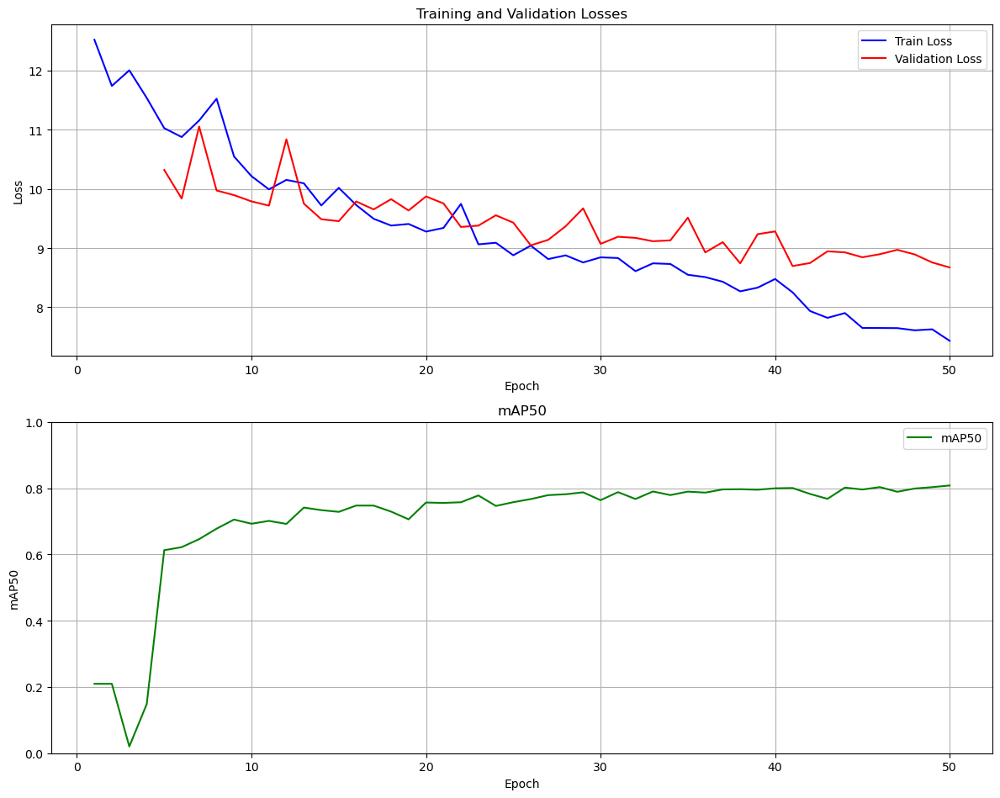

In [26]:
results_path = os.path.join(cwd, "yolo_football_analysis", "yolo8L_dataset_baseline", "results.csv")
data = pd.read_csv(results_path)
plot_metrics(data)

### Quantitative Test

In [ ]:
model = YOLO(r"yolo_football_analysis\yolo8L_dataset_baseline\weights\best.pt")
model = model.cuda()
model.val(data=os.path.join(dataset_path, "data.yaml"), split="test", project="yolo_football_test", name="yolo8L_dataset_baseline")

Model summary (fused): 268 layers, 43,609,692 parameters, 0 gradients, 164.8 GFLOPs


val: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov8\baseline\test\labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:06<00:00,  1.54s/it]


                   all         60       1452      0.876      0.771      0.819      0.574
                  ball         52         53      0.772      0.226      0.342       0.11
            goalkeeper         40         41      0.913      0.951      0.983      0.738
                player         60       1202      0.948      0.966      0.987      0.766
               referee         60        156      0.869      0.942      0.965      0.684
Speed: 1.3ms preprocess, 21.1ms inference, 0.0ms loss, 6.2ms postprocess per image
Results saved to yolo_football_test\yolo8L_dataset_baseline2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000002715D31DE70>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

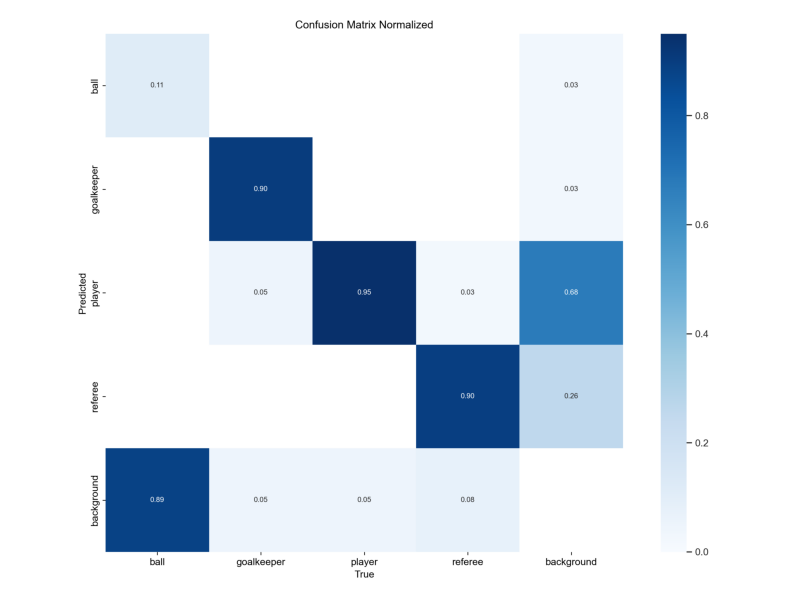

In [2]:
# load and show confusion matrix
matrix_path = os.path.join(cwd, "yolo_football_test", "yolo8L_dataset_baseline", "confusion_matrix_normalized.png")
plot_confusion_matrix(matrix_path)

### Qualitative Analysis on Challenging Samples

The qualitative analysis is based on three distinct samples:  
1. The first shows a stretched ball.  
2. The second features the ball under dim lighting conditions.  
3. The third depicts the ball partially occluded by a player.  

The purpose of this qualitative test is to assess the model’s performance under difficult conditions.



image 1/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\538438_1_10_png_jpg.rf.f0585e46a9ae3f1d0f64c24aaf7704b8.jpg: 384x640 20 players, 1 referee, 168.5ms
image 2/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\Screenshot-2025-01-03-112748_png.rf.763a7d889601c8b79d673b84cdc4ae64.jpg: 384x640 1 goalkeeper, 18 players, 2 referees, 67.9ms
image 3/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\c01561_1_6_png_jpg.rf.260b489d60904fa09f43dfb8daa38056.jpg: 384x640 1 goalkeeper, 21 players, 2 referees, 64.0ms
Speed: 6.6ms preprocess, 100.2ms inference, 76.1ms postprocess per image at shape (1, 3, 384, 640)


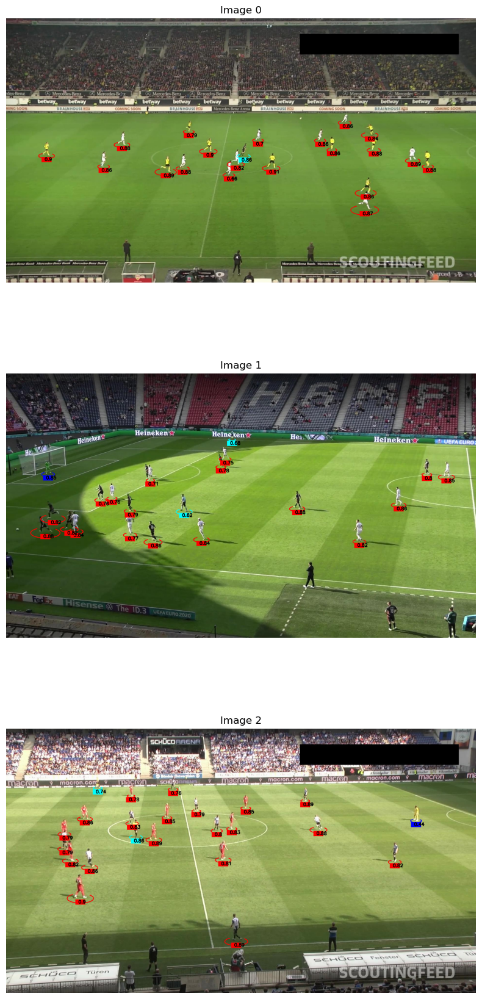

In [2]:
model_name = "yolo8L_dataset_baseline"
detect_images(images_to_test_path, r"yolo_football_analysis\yolo8L_dataset_baseline\weights\best.pt")

**Result:** <span style="color: red;">No ball was detected</span>


## YOLO v5Lu

In [ ]:
mp.freeze_support()  # Necessario su Windows
model = YOLO("yolov5lu.pt")
model = model.cuda()
# print current path
dataset_path = os.path.join(dataset_root_folder, "yolov5", "baseline")


c:\Users\siani\.conda\envs\torch_gpu_clone\lib\site-packages\torch\nn\modules\module.py:1050: UserWarning: expandable_segments not supported on this platform (Triggered internally at C:\cb\pytorch_1000000000000\work\c10/cuda/CUDAAllocatorConfig.h:28.)
  return self._apply(lambda t: t.cuda(device))


In [ ]:
model.train(data=os.path.join(dataset_path, "data.yaml"), epochs=50, imgsz=640, save=True, project="yolo_football_analysis", name="yolo5L_dataset_baseline")
model.val(data=os.path.join(dataset_path, "data.yaml"), epochs=20, imgsz=640, save=True, save_dir="yolov5", project="yolo_football_analysis")
wandb.finish()

New https://pypi.org/project/ultralytics/8.3.78 available  Update with 'pip install -U ultralytics'
engine\trainer: task=detect, mode=train, model=yolov5lu.pt, data=c:\Users\siani\PycharmProjects\AIxFootballAnalysis\src\training\../../dataset\yolov5\v0\data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda:0, workers=8, project=yolo_football_analysis, name=yolo5L_dataset_v0, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, sho

wandb: Currently logged in as: sianiemanuele (sianiemanuele_07) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.


Freezing layer 'model.24.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed 


train: Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov5\v0\train\labels...:   0%|          | 0/510 [00:00<?, ?it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov5\v0\train\labels... 57 images, 0 backgrounds, 0 corrupt:  11%|█         | 57/510 [00:00<00:00, 566.28it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov5\v0\train\labels... 130 images, 0 backgrounds, 0 corrupt:  25%|██▌       | 130/510 [00:00<00:00, 624.54it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov5\v0\train\labels... 210 images, 0 backgrounds, 0 corrupt:  41%|████      | 210/510 [00:00<00:00, 686.08it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov5\v0\train\labels... 279 images, 0 backgrounds, 0 corrupt:  55%|█████▍    | 279/510 [00:00<00:00, 681.22it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov5\v0\train\labels... 351 images, 0 backgrounds, 0 corrupt:  

train: New cache created: C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov5\v0\train\labels.cache


val: Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov5\v0\valid\labels...:   0%|          | 0/75 [00:00<?, ?it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov5\v0\valid\labels... 33 images, 0 backgrounds, 0 corrupt:  44%|████▍     | 33/75 [00:00<00:00, 325.17it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov5\v0\valid\labels... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<00:00, 428.79it/s]


val: New cache created: C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov5\v0\valid\labels.cache
Plotting labels to yolo_football_analysis\yolo5L_dataset_v0\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0005), 119 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to yolo_football_analysis\yolo5L_dataset_v0
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50        11G      1.337      1.649     0.8379        613        640: 100%|██████████| 32/32 [07:35<00:00, 14.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:11<00:00,  3.89s/it]


                   all         75       1796      0.494      0.305      0.259       0.12

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      10.6G      1.303     0.8391     0.8233        720        640: 100%|██████████| 32/32 [06:29<00:00, 12.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.94s/it]


                   all         75       1796      0.773      0.544       0.59      0.341

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      10.6G       1.38     0.7907     0.8301        532        640: 100%|██████████| 32/32 [06:00<00:00, 11.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.16s/it]


                   all         75       1796      0.746      0.472      0.534      0.273

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      10.7G      1.319     0.6935      0.822        550        640: 100%|██████████| 32/32 [05:56<00:00, 11.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.61s/it]


                   all         75       1796       0.81       0.59       0.66      0.388

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      10.6G      1.257     0.6728       0.82        511        640: 100%|██████████| 32/32 [05:41<00:00, 10.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.43s/it]


                   all         75       1796      0.786      0.616      0.679      0.392

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      10.7G      1.186     0.6327     0.8151        520        640: 100%|██████████| 32/32 [05:49<00:00, 10.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.66s/it]


                   all         75       1796      0.779      0.685      0.707      0.415

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      10.7G      1.165     0.5994      0.814        586        640: 100%|██████████| 32/32 [05:35<00:00, 10.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.61s/it]


                   all         75       1796      0.891      0.641      0.719      0.443

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      10.7G      1.154     0.5775     0.8087        459        640: 100%|██████████| 32/32 [05:42<00:00, 10.71s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.37s/it]


                   all         75       1796      0.925      0.627      0.715      0.421

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      10.7G      1.214     0.6084     0.8131        543        640: 100%|██████████| 32/32 [05:12<00:00,  9.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.51s/it]


                   all         75       1796        0.9        0.6      0.692      0.414

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      10.7G      1.153     0.5762      0.811        652        640: 100%|██████████| 32/32 [05:31<00:00, 10.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.61s/it]


                   all         75       1796      0.884      0.643      0.718      0.416

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      10.6G      1.087      0.556     0.8047        671        640: 100%|██████████| 32/32 [06:05<00:00, 11.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:12<00:00,  4.16s/it]


                   all         75       1796       0.73      0.568      0.597      0.312

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      10.7G      1.138     0.5639     0.8092        689        640: 100%|██████████| 32/32 [05:28<00:00, 10.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.58s/it]


                   all         75       1796      0.816      0.657      0.745      0.448

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      10.7G      1.135     0.5481     0.8069        548        640: 100%|██████████| 32/32 [05:49<00:00, 10.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.81s/it]


                   all         75       1796       0.89        0.7      0.767      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      10.7G       1.08     0.5195      0.804        552        640: 100%|██████████| 32/32 [06:48<00:00, 12.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.69s/it]


                   all         75       1796      0.862      0.683      0.745       0.47

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      10.7G      1.098     0.5395     0.8044        471        640: 100%|██████████| 32/32 [05:53<00:00, 11.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.36s/it]


                   all         75       1796      0.919      0.668      0.745      0.469

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      10.7G      1.076      0.537     0.8052        702        640: 100%|██████████| 32/32 [05:46<00:00, 10.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.54s/it]


                   all         75       1796       0.81      0.697      0.739      0.438

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      10.7G      1.062     0.5133     0.8024        490        640: 100%|██████████| 32/32 [05:37<00:00, 10.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.38s/it]


                   all         75       1796      0.834      0.703      0.771      0.489

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      10.7G      1.062      0.506     0.8024        751        640: 100%|██████████| 32/32 [05:37<00:00, 10.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.36s/it]


                   all         75       1796      0.834      0.724      0.788      0.493

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      10.6G      1.052     0.4972     0.7995        578        640: 100%|██████████| 32/32 [05:41<00:00, 10.67s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.96s/it]


                   all         75       1796      0.914      0.698       0.76      0.491

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      10.6G      1.029      0.486     0.7998        580        640: 100%|██████████| 32/32 [05:48<00:00, 10.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.32s/it]


                   all         75       1796      0.859      0.701      0.769      0.492

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      10.7G      1.048     0.4912        0.8        690        640: 100%|██████████| 32/32 [05:49<00:00, 10.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:12<00:00,  4.21s/it]


                   all         75       1796      0.889      0.706      0.757      0.479

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      10.7G      1.022     0.4849     0.7987        610        640: 100%|██████████| 32/32 [05:53<00:00, 11.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.66s/it]


                   all         75       1796      0.884      0.727      0.777      0.495

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      10.7G      1.011     0.4742     0.7983        465        640: 100%|██████████| 32/32 [05:53<00:00, 11.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.61s/it]


                   all         75       1796      0.795       0.72      0.774      0.484

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      10.5G      1.038     0.4924     0.7982        694        640: 100%|██████████| 32/32 [05:28<00:00, 10.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.69s/it]


                   all         75       1796      0.814      0.717      0.759      0.466

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      10.6G      1.025     0.4808     0.8013        530        640: 100%|██████████| 32/32 [05:09<00:00,  9.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:12<00:00,  4.22s/it]


                   all         75       1796      0.847      0.747      0.793       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      10.6G      1.015     0.4734     0.7991        447        640: 100%|██████████| 32/32 [06:29<00:00, 12.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.14s/it]


                   all         75       1796      0.918       0.71      0.788      0.505

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      10.6G     0.9805     0.4641     0.7971        503        640: 100%|██████████| 32/32 [05:17<00:00,  9.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:12<00:00,  4.28s/it]


                   all         75       1796      0.897      0.746      0.799      0.509

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      10.7G     0.9715      0.459     0.7965        527        640: 100%|██████████| 32/32 [05:25<00:00, 10.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.91s/it]


                   all         75       1796      0.841      0.721      0.774      0.502

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      10.6G     0.9924     0.4645     0.7976        520        640: 100%|██████████| 32/32 [05:27<00:00, 10.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.12s/it]


                   all         75       1796      0.845      0.716      0.769      0.489

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      10.7G     0.9945     0.4642     0.7987        494        640: 100%|██████████| 32/32 [06:02<00:00, 11.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.73s/it]


                   all         75       1796       0.87      0.691      0.773      0.494

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      10.7G     0.9816     0.4579     0.7979        545        640: 100%|██████████| 32/32 [05:55<00:00, 11.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.76s/it]


                   all         75       1796      0.855      0.735      0.778       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      10.7G     0.9476     0.4408     0.7932        681        640: 100%|██████████| 32/32 [05:59<00:00, 11.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.69s/it]


                   all         75       1796      0.838      0.728      0.783      0.516

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      10.7G     0.9592     0.4391     0.7925        539        640: 100%|██████████| 32/32 [05:50<00:00, 10.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:12<00:00,  4.25s/it]


                   all         75       1796      0.855      0.742      0.795      0.514

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      10.7G     0.9575     0.4407      0.792        589        640: 100%|██████████| 32/32 [05:44<00:00, 10.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.39s/it]


                   all         75       1796      0.826      0.743      0.784       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      10.7G     0.9448     0.4319     0.7912        490        640: 100%|██████████| 32/32 [05:25<00:00, 10.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.35s/it]


                   all         75       1796      0.875      0.733      0.781      0.515

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      10.6G     0.9267     0.4314     0.7927        587        640: 100%|██████████| 32/32 [05:24<00:00, 10.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.51s/it]


                   all         75       1796       0.92       0.73      0.801      0.514

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      10.7G     0.9244     0.4241     0.7919        523        640: 100%|██████████| 32/32 [05:23<00:00, 10.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.49s/it]


                   all         75       1796      0.862      0.738      0.794      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      10.6G     0.9197     0.4238     0.7927        606        640: 100%|██████████| 32/32 [05:26<00:00, 10.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.45s/it]


                   all         75       1796      0.871       0.73      0.789      0.526

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      10.7G     0.9233     0.4178     0.7947        502        640: 100%|██████████| 32/32 [05:26<00:00, 10.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.50s/it]


                   all         75       1796      0.866      0.744      0.786      0.516

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      10.7G     0.9415     0.4257     0.7925        640        640: 100%|██████████| 32/32 [05:25<00:00, 10.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.72s/it]


                   all         75       1796      0.864      0.752      0.796       0.52
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      10.7G     0.8792     0.4115     0.7922        325        640: 100%|██████████| 32/32 [06:08<00:00, 11.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.48s/it]


                   all         75       1796      0.909      0.705      0.784      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      10.7G     0.8563     0.4064     0.7895        313        640: 100%|██████████| 32/32 [05:43<00:00, 10.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.68s/it]


                   all         75       1796      0.901      0.724      0.793      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      10.7G     0.8538     0.3987     0.7926        329        640: 100%|██████████| 32/32 [05:19<00:00,  9.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.59s/it]


                   all         75       1796       0.88      0.726      0.785       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      10.7G     0.8635     0.4005     0.7919        318        640: 100%|██████████| 32/32 [06:32<00:00, 12.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.59s/it]


                   all         75       1796      0.835      0.726      0.777      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      10.7G     0.8505     0.3939      0.788        326        640: 100%|██████████| 32/32 [05:13<00:00,  9.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.89s/it]


                   all         75       1796       0.88      0.731      0.783      0.512

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      10.7G     0.8356     0.3861     0.7917        327        640: 100%|██████████| 32/32 [05:19<00:00,  9.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.99s/it]


                   all         75       1796      0.874      0.731      0.793      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      10.7G     0.8355     0.3885     0.7879        332        640: 100%|██████████| 32/32 [06:03<00:00, 11.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.62s/it]


                   all         75       1796      0.851       0.74       0.79      0.538

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      10.7G     0.8308      0.379     0.7866        332        640: 100%|██████████| 32/32 [06:12<00:00, 11.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.77s/it]


                   all         75       1796      0.846      0.735      0.786      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      10.7G     0.8331     0.3799     0.7905        320        640: 100%|██████████| 32/32 [05:20<00:00, 10.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.69s/it]


                   all         75       1796      0.839      0.756      0.793      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      10.7G     0.8089     0.3719     0.7885        321        640: 100%|██████████| 32/32 [07:01<00:00, 13.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.70s/it]


                   all         75       1796      0.841       0.75      0.792      0.544

50 epochs completed in 5.074 hours.
Optimizer stripped from yolo_football_analysis\yolo5L_dataset_v0\weights\last.pt, 106.8MB
Optimizer stripped from yolo_football_analysis\yolo5L_dataset_v0\weights\best.pt, 106.8MB

Validating yolo_football_analysis\yolo5L_dataset_v0\weights\best.pt...
Ultralytics 8.3.28  Python-3.10.0 torch-2.5.0 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv5l summary (fused): 303 layers, 53,134,492 parameters, 0 gradients, 134.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.56it/s]


                   all         75       1796      0.841       0.75      0.792      0.543
                  ball         73         73      0.692      0.246      0.319      0.143
            goalkeeper         50         50        0.8       0.84      0.882      0.609
                player         75       1493      0.958      0.957      0.989      0.756
               referee         75        180      0.915      0.956      0.977      0.665
Speed: 0.6ms preprocess, 8.1ms inference, 0.0ms loss, 2.8ms postprocess per image
Results saved to yolo_football_analysis\yolo5L_dataset_v0


lr/pg0,▃▆████▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg1,▃▆████▇▇▇▇▆▆▆▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg2,▃▆███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
metrics/mAP50(B),▁▅▅▆▆▇▇▇▇▅▇▇▇███▇██▇████████████████████
metrics/mAP50-95(B),▁▅▄▅▅▆▆▆▄▆▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇█▇███████▇▇████
metrics/precision(B),▁▆▅▆▆▇██▇▅▇▇█▆▇▇▇▇▆▆██▇▇▇▇▆▇█▇▇▇██▇▇▇▇▇▇
metrics/recall(B),▁▅▄▅▆▆▆▆▆▅▇▇▇▇▇▇▇▇█▇█▇██▇████████▇██████
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,▇▇█▇▆▅▅▆▅▄▅▄▅▄▄▄▄▄▄▃▄▄▃▃▃▃▃▃▃▂▂▂▃▂▂▂▁▁▁▁


Ultralytics 8.3.28  Python-3.10.0 torch-2.5.0 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv5l summary (fused): 303 layers, 53,134,492 parameters, 0 gradients, 134.7 GFLOPs


val: Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov5\v0\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov5\v0\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.92it/s]


                   all         75       1796      0.853      0.754      0.801      0.548
                  ball         73         73      0.728      0.257      0.351      0.147
            goalkeeper         50         50      0.802       0.84      0.883      0.607
                player         75       1493       0.96      0.957      0.989      0.765
               referee         75        180      0.921      0.961      0.982      0.674
Speed: 0.8ms preprocess, 13.9ms inference, 0.0ms loss, 7.4ms postprocess per image
Results saved to yolo_football_analysis\yolo5L_dataset_v02


### Plots

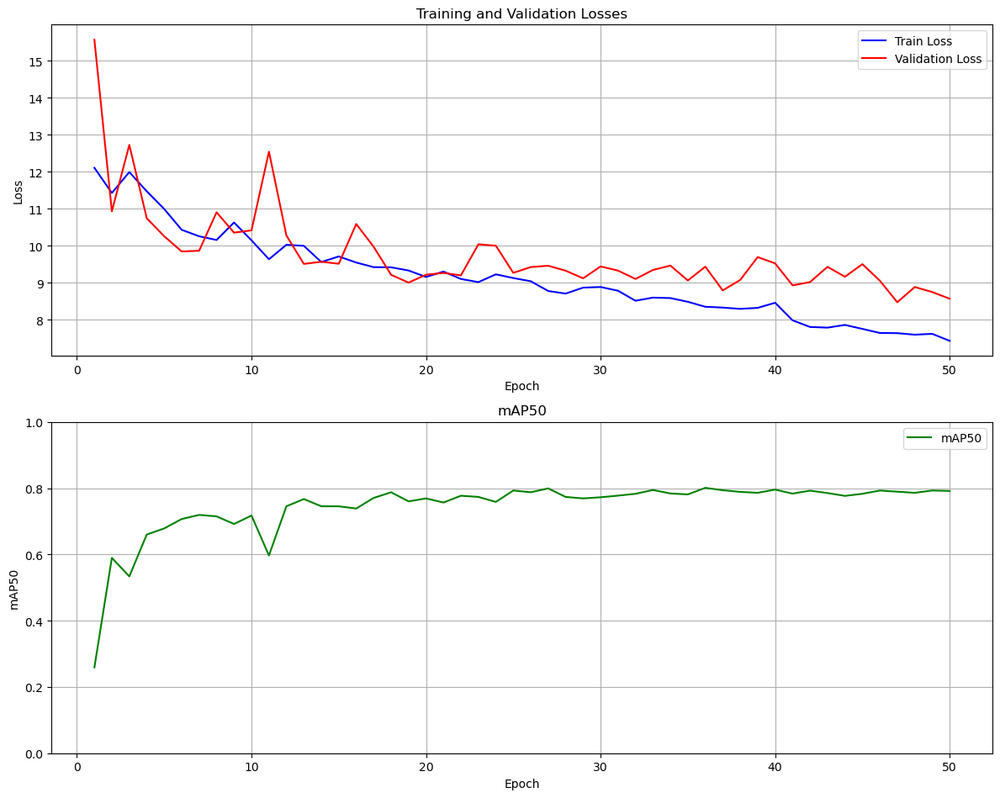

In [27]:
results_path = os.path.join(cwd, "yolo_football_analysis", "yolo5L_dataset_baseline", "results.csv")
data = pd.read_csv(results_path)
plot_metrics(data)

### Quantitative Test

In [5]:
# Test the model on the test set
model = YOLO(r"yolo_football_analysis\yolo5L_dataset_baseline\weights\best.pt")
model = model.cuda()
model.val(data=os.path.join(dataset_path, "data.yaml"), split="test", project="yolo_football_test", name="yolo5L_dataset_baseline")

YOLOv5l summary (fused): 303 layers, 53,134,492 parameters, 0 gradients, 134.7 GFLOPs


val: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov5\baseline\test\labels... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<00:00, 638.51it/s]

val: New cache created: C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov5\baseline\test\labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:08<00:00,  2.12s/it]


                   all         60       1452      0.891       0.74      0.808      0.563
                  ball         52         53      0.751      0.208      0.316      0.095
            goalkeeper         40         41      0.982      0.878      0.976      0.712
                player         60       1202      0.957      0.956      0.987      0.773
               referee         60        156      0.876      0.917      0.954      0.671
Speed: 1.1ms preprocess, 22.2ms inference, 0.0ms loss, 5.6ms postprocess per image
Results saved to yolo_football_test\yolo5L_dataset_baseline


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000021803CCCE20>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

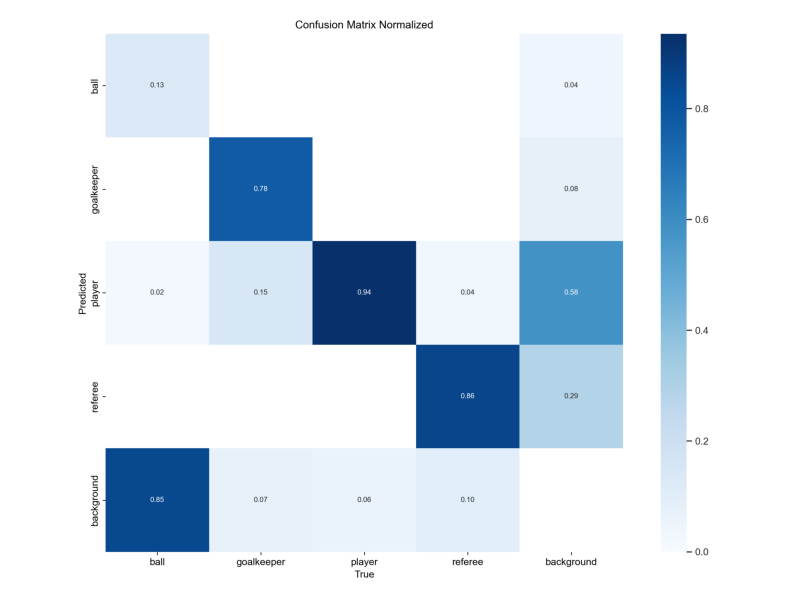

In [6]:
# load and show confusion matrix
matrix_path = os.path.join(cwd,"yolo_football_test" ,"yolo5L_dataset_baseline", "confusion_matrix_normalized.png")
plot_confusion_matrix(matrix_path)

### Qualitative Analysis on Challenging Samples

The qualitative analysis is based on three distinct samples:  
1. The first shows a stretched ball.  
2. The second features the ball under dim lighting conditions.  
3. The third depicts the ball partially occluded by a player.  

The purpose of this qualitative test is to assess the model’s performance under difficult conditions.


image 1/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\538438_1_10_png_jpg.rf.f0585e46a9ae3f1d0f64c24aaf7704b8.jpg: 384x640 21 players, 1 referee, 106.2ms
image 2/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\Screenshot-2025-01-03-112748_png.rf.763a7d889601c8b79d673b84cdc4ae64.jpg: 384x640 1 goalkeeper, 17 players, 2 referees, 69.4ms
image 3/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\c01561_1_6_png_jpg.rf.260b489d60904fa09f43dfb8daa38056.jpg: 384x640 22 players, 2 referees, 66.6ms
Speed: 3.6ms preprocess, 80.7ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)


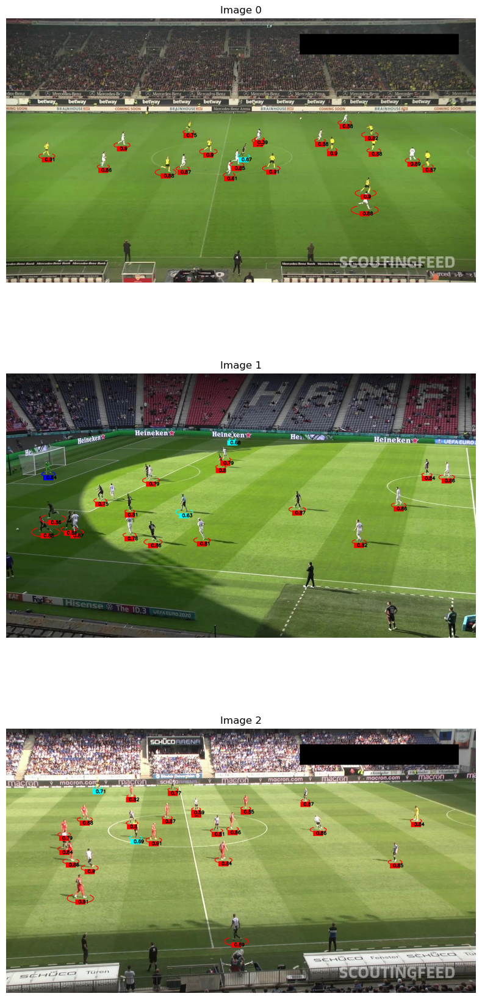

In [3]:
model_name = "yolo5L_dataset_baseline"
detect_images(images_to_test_path, r"yolo_football_analysis\yolo5L_dataset_baseline\weights\best.pt")

**Result:** <span style="color: red;">No ball was detected</span>

## YOLO v9c


In [12]:
mp.freeze_support()  # Necessario su Windows
model = YOLO("yolov9c.pt")
model = model.cuda()
dataset_path = os.path.join(dataset_root_folder, "yolov9", "baseline")

In [ ]:
model.train(data=os.path.join(dataset_path, "data.yaml"), epochs=50, imgsz=640, save=True, project="yolo_football_analysis", name="yolo9c_dataset_baseline")
wandb.finish()

New https://pypi.org/project/ultralytics/8.3.78 available  Update with 'pip install -U ultralytics'
engine\trainer: task=detect, mode=train, model=yolov9c.pt, data=c:\Users\siani\PycharmProjects\AIxFootballAnalysis\src\training\../../dataset\yolov9\v0\data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda:0, workers=8, project=yolo_football_analysis, name=yolo9c_dataset_v0, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show

wandb: Currently logged in as: sianiemanuele (sianiemanuele_07) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed 


train: Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\train\labels...:   0%|          | 0/510 [00:00<?, ?it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\train\labels... 66 images, 0 backgrounds, 0 corrupt:  13%|█▎        | 66/510 [00:00<00:00, 623.84it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\train\labels... 133 images, 0 backgrounds, 0 corrupt:  26%|██▌       | 133/510 [00:00<00:00, 618.04it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\train\labels... 207 images, 0 backgrounds, 0 corrupt:  41%|████      | 207/510 [00:00<00:00, 661.45it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\train\labels... 274 images, 0 backgrounds, 0 corrupt:  54%|█████▎    | 274/510 [00:00<00:00, 663.08it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\train\labels... 341 images, 0 backgrounds, 0 corrupt:  

train: New cache created: C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\train\labels.cache


val: Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\valid\labels...:   0%|          | 0/75 [00:00<?, ?it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\valid\labels... 47 images, 0 backgrounds, 0 corrupt:  63%|██████▎   | 47/75 [00:00<00:00, 464.18it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\valid\labels... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<00:00, 468.11it/s]


val: New cache created: C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\valid\labels.cache
Plotting labels to yolo_football_analysis\yolo9c_dataset_v0\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to yolo_football_analysis\yolo9c_dataset_v0
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      11.3G      1.384      2.091     0.8414        613        640: 100%|██████████| 32/32 [08:21<00:00, 15.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.36s/it]


                   all         75       1796      0.416      0.439       0.41      0.243

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      11.2G      1.335     0.8251     0.8243        720        640: 100%|██████████| 32/32 [06:34<00:00, 12.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:17<00:00,  5.67s/it]


                   all         75       1796      0.749      0.511        0.5      0.275

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      11.3G      1.552     0.8703     0.8495        532        640: 100%|██████████| 32/32 [07:13<00:00, 13.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.61s/it]


                   all         75       1796      0.562      0.356      0.295      0.115

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      11.1G      1.608     0.8335     0.8466        550        640: 100%|██████████| 32/32 [08:18<00:00, 15.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.49s/it]


                   all         75       1796      0.767      0.614      0.602      0.327

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      11.1G      1.318     0.6923      0.824        511        640: 100%|██████████| 32/32 [08:16<00:00, 15.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.21s/it]


                   all         75       1796       0.91      0.591      0.691       0.41

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      11.2G       1.26     0.6347     0.8184        520        640: 100%|██████████| 32/32 [08:22<00:00, 15.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.55s/it]


                   all         75       1796      0.819      0.666      0.692       0.43

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      11.2G      1.219     0.6046      0.818        586        640: 100%|██████████| 32/32 [07:23<00:00, 13.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.23s/it]


                   all         75       1796      0.803      0.671      0.719      0.442

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      11.2G      1.238     0.5931     0.8146        459        640: 100%|██████████| 32/32 [07:42<00:00, 14.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.65s/it]


                   all         75       1796      0.817      0.668      0.714      0.435

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      11.2G      1.236     0.5821     0.8146        543        640: 100%|██████████| 32/32 [07:53<00:00, 14.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.14s/it]


                   all         75       1796      0.867      0.666      0.721      0.436

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      11.2G       1.19     0.5664     0.8118        652        640: 100%|██████████| 32/32 [07:57<00:00, 14.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:17<00:00,  5.82s/it]


                   all         75       1796      0.887      0.626      0.694      0.401

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      11.1G      1.173     0.5522     0.8144        671        640: 100%|██████████| 32/32 [07:22<00:00, 13.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.29s/it]


                   all         75       1796      0.831       0.63      0.711      0.419

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      11.2G      1.168     0.5575     0.8117        689        640: 100%|██████████| 32/32 [07:12<00:00, 13.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.40s/it]


                   all         75       1796      0.757      0.578      0.621      0.321

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      11.2G      1.199     0.5542     0.8097        548        640: 100%|██████████| 32/32 [07:21<00:00, 13.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:17<00:00,  5.72s/it]


                   all         75       1796      0.889      0.683      0.746       0.45

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      11.2G      1.143     0.5364     0.8078        552        640: 100%|██████████| 32/32 [06:55<00:00, 12.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.06s/it]


                   all         75       1796      0.891      0.674      0.735      0.434

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      11.1G      1.103     0.5236     0.8045        471        640: 100%|██████████| 32/32 [07:15<00:00, 13.62s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.93s/it]


                   all         75       1796       0.86      0.696      0.735      0.459

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      11.2G      1.095      0.513     0.8061        702        640: 100%|██████████| 32/32 [07:09<00:00, 13.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.99s/it]


                   all         75       1796      0.875       0.69       0.75      0.476

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      11.2G      1.035     0.4947      0.801        490        640: 100%|██████████| 32/32 [07:48<00:00, 14.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.24s/it]


                   all         75       1796       0.86      0.686      0.751      0.478

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      11.2G       1.06     0.5007     0.8031        751        640: 100%|██████████| 32/32 [07:17<00:00, 13.67s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.40s/it]


                   all         75       1796      0.692       0.66      0.696      0.437

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      11.1G      1.073     0.5174     0.8004        578        640: 100%|██████████| 32/32 [07:37<00:00, 14.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.95s/it]


                   all         75       1796      0.893      0.676      0.707      0.443

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      11.1G      1.038     0.4899     0.8004        580        640: 100%|██████████| 32/32 [08:12<00:00, 15.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.33s/it]


                   all         75       1796      0.891      0.715      0.758      0.501

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      11.2G       1.07      0.497     0.8018        690        640: 100%|██████████| 32/32 [07:44<00:00, 14.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.64s/it]


                   all         75       1796      0.839      0.727      0.774      0.486

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      11.2G      1.046     0.4833        0.8        610        640: 100%|██████████| 32/32 [07:36<00:00, 14.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.61s/it]


                   all         75       1796      0.862      0.707      0.775      0.497

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      11.2G      1.018      0.469     0.7986        465        640: 100%|██████████| 32/32 [08:30<00:00, 15.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.34s/it]


                   all         75       1796      0.812      0.736      0.784      0.497

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      11.2G      1.008     0.4673      0.796        694        640: 100%|██████████| 32/32 [07:44<00:00, 14.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.90s/it]


                   all         75       1796      0.827      0.713      0.759      0.486

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      11.2G     0.9739      0.452     0.7977        530        640: 100%|██████████| 32/32 [07:52<00:00, 14.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.75s/it]


                   all         75       1796       0.84      0.743      0.779      0.502

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      11.1G      1.005     0.4593      0.798        447        640: 100%|██████████| 32/32 [07:46<00:00, 14.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.08s/it]


                   all         75       1796       0.86      0.725      0.777      0.493

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      11.2G      0.975      0.447     0.7962        503        640: 100%|██████████| 32/32 [08:00<00:00, 15.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.28s/it]


                   all         75       1796      0.867      0.731      0.785      0.508

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      11.2G      0.963     0.4395     0.7952        527        640: 100%|██████████| 32/32 [07:17<00:00, 13.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.20s/it]


                   all         75       1796      0.887      0.723      0.781       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50        11G     0.9851     0.4485     0.7952        520        640: 100%|██████████| 32/32 [07:44<00:00, 14.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.41s/it]


                   all         75       1796       0.81      0.744      0.781      0.497

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      11.2G      1.003     0.4546     0.7983        494        640: 100%|██████████| 32/32 [07:34<00:00, 14.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.03s/it]


                   all         75       1796      0.816      0.743      0.791      0.512

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      11.2G      1.023     0.4538      0.799        545        640: 100%|██████████| 32/32 [07:11<00:00, 13.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.99s/it]


                   all         75       1796      0.818       0.74       0.78      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      11.2G      1.011     0.4472     0.7965        681        640: 100%|██████████| 32/32 [07:30<00:00, 14.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.26s/it]


                   all         75       1796      0.859      0.703      0.769      0.476

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      11.2G      1.009     0.4409     0.7954        539        640: 100%|██████████| 32/32 [07:24<00:00, 13.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.09s/it]


                   all         75       1796      0.867      0.744      0.785      0.508

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      11.2G     0.9911     0.4353     0.7936        589        640: 100%|██████████| 32/32 [07:24<00:00, 13.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.85s/it]


                   all         75       1796      0.922      0.719      0.768      0.469

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      11.2G     0.9834     0.4308     0.7932        490        640: 100%|██████████| 32/32 [07:43<00:00, 14.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.52s/it]


                   all         75       1796      0.845      0.729      0.783       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      11.1G     0.9402     0.4193     0.7935        587        640: 100%|██████████| 32/32 [07:57<00:00, 14.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.97s/it]


                   all         75       1796      0.866       0.74      0.799      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      11.2G     0.9306     0.4179     0.7932        523        640: 100%|██████████| 32/32 [08:17<00:00, 15.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:16<00:00,  5.35s/it]


                   all         75       1796      0.916      0.761      0.803       0.53

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      11.1G     0.9078     0.4089     0.7921        606        640: 100%|██████████| 32/32 [07:54<00:00, 14.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.20s/it]


                   all         75       1796      0.853       0.75      0.803      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      11.2G     0.9208     0.4142     0.7942        502        640: 100%|██████████| 32/32 [07:56<00:00, 14.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:15<00:00,  5.27s/it]


                   all         75       1796      0.886       0.73      0.792      0.518

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      11.2G     0.9239     0.4137     0.7922        640        640: 100%|██████████| 32/32 [07:57<00:00, 14.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:14<00:00,  4.98s/it]


                   all         75       1796      0.902      0.755      0.802      0.519
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50        11G     0.8718     0.4032     0.7911        325        640: 100%|██████████| 32/32 [07:37<00:00, 14.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.63s/it]


                   all         75       1796      0.883      0.751      0.798      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50        11G     0.8526     0.4024     0.7897        313        640: 100%|██████████| 32/32 [07:26<00:00, 13.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:11<00:00,  3.87s/it]


                   all         75       1796      0.846      0.744      0.797      0.504

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50        11G     0.8623     0.4022     0.7938        329        640: 100%|██████████| 32/32 [07:19<00:00, 13.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.48s/it]


                   all         75       1796      0.882      0.715       0.78      0.497

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      11.2G     0.8681     0.4004     0.7928        318        640: 100%|██████████| 32/32 [07:09<00:00, 13.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:12<00:00,  4.25s/it]


                   all         75       1796      0.882      0.731      0.791      0.513

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50        11G       0.84     0.3867     0.7877        326        640: 100%|██████████| 32/32 [07:24<00:00, 13.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.34s/it]


                   all         75       1796      0.917      0.754      0.818      0.537

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50        11G     0.8249     0.3773     0.7906        327        640: 100%|██████████| 32/32 [07:20<00:00, 13.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:13<00:00,  4.38s/it]


                   all         75       1796      0.908      0.749       0.81      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      11.2G     0.8393      0.382     0.7884        332        640: 100%|██████████| 32/32 [07:02<00:00, 13.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:12<00:00,  4.12s/it]


                   all         75       1796       0.91      0.732      0.803      0.539

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50        11G     0.8287     0.3767     0.7863        332        640: 100%|██████████| 32/32 [07:52<00:00, 14.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:11<00:00,  3.72s/it]


                   all         75       1796      0.919      0.745       0.81      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50        11G     0.8154     0.3711     0.7891        320        640: 100%|██████████| 32/32 [07:11<00:00, 13.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:12<00:00,  4.24s/it]


                   all         75       1796      0.908      0.746      0.816      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50        11G     0.8003     0.3629     0.7878        321        640: 100%|██████████| 32/32 [07:21<00:00, 13.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:12<00:00,  4.12s/it]


                   all         75       1796      0.936      0.751      0.823      0.544

50 epochs completed in 6.605 hours.
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_v0\weights\last.pt, 51.6MB
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_v0\weights\best.pt, 51.6MB

Validating yolo_football_analysis\yolo9c_dataset_v0\weights\best.pt...
Ultralytics 8.3.28  Python-3.10.0 torch-2.5.0 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:03<00:00,  1.09s/it]


                   all         75       1796      0.936      0.751      0.823      0.542
                  ball         73         73      0.952      0.269       0.41      0.132
            goalkeeper         50         50      0.897       0.82      0.912      0.626
                player         75       1493      0.973      0.958       0.99      0.755
               referee         75        180      0.923      0.956      0.979      0.656
Speed: 1.1ms preprocess, 28.0ms inference, 0.0ms loss, 3.0ms postprocess per image
Results saved to yolo_football_analysis\yolo9c_dataset_v0


lr/pg0,▃▆████▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg1,▃▆████▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg2,▃▆████▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▁▁▁
metrics/mAP50(B),▃▄▁▅▆▇▇▇▆▇▇▇▇▇▇▆▇▇▇▇▇▇█▇▇▇▇█▇███████████
metrics/mAP50-95(B),▃▄▁▄▆▆▆▆▆▄▆▇▇▇▆▇▇▇▇▇▇▇▇▇█▇▇▇█████▇▇█████
metrics/precision(B),▁▅▃▆█▆▆▇▇▆▇▇▇▇▅▇▇▇▇▇▇▇▆▆▆▇█▇▇█▇█▇▇▇█████
metrics/recall(B),▂▄▁▅▅▆▆▆▆▆▇▇▇▇▇▇▇▇█▇▇▇████▇▇██▇███▇██▇██
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,▆▆██▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▃▃▃▃▃▃▂▂▂▂▁▂▁▁▁▁


### Plots

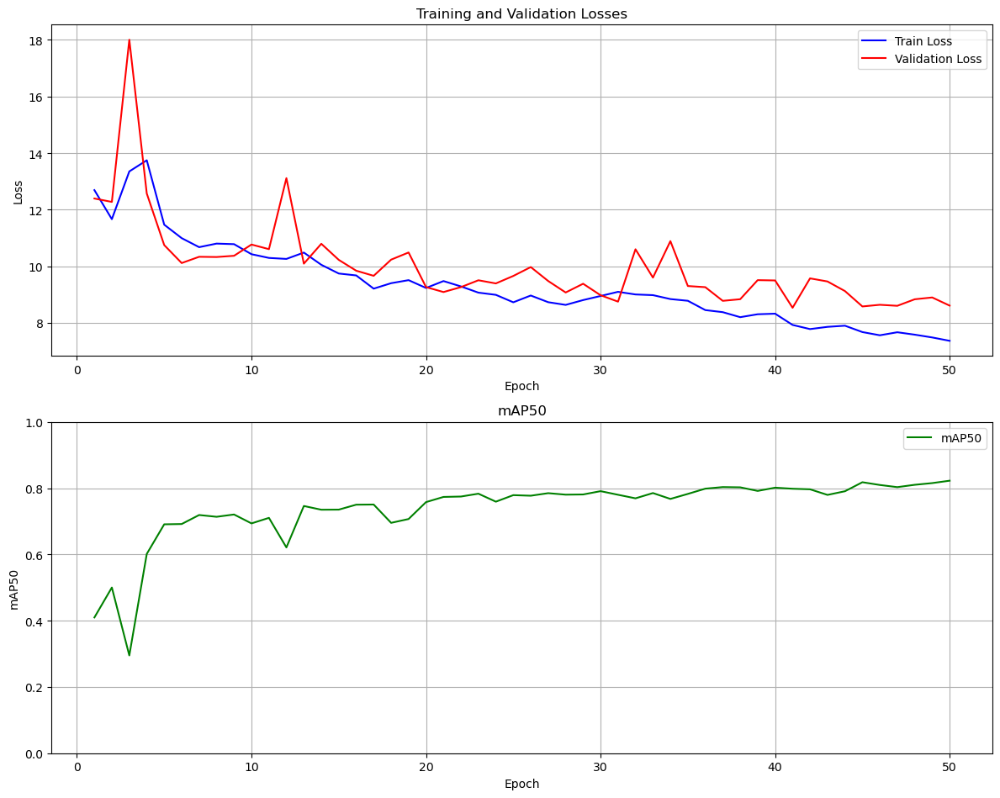

In [28]:
results_path = os.path.join(cwd, "yolo_football_analysis", "yolo9c_dataset_baseline", "results.csv")
data = pd.read_csv(results_path)
plot_metrics(data)


### Quantitative Test

In [ ]:
model = YOLO(r"yolo_football_analysis\yolo9c_dataset_baseline\weights\best.pt")
model = model.cuda()
model.val(data=os.path.join(dataset_path, "data.yaml"), split="test", project="yolo_football_test", name="yolo9c_dataset_baseline")

YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


val: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov5\baseline\test\labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:06<00:00,  1.56s/it]


                   all         60       1452       0.87      0.754      0.806      0.569
                  ball         52         53      0.722      0.197      0.306      0.127
            goalkeeper         40         41      0.928      0.927       0.97      0.705
                player         60       1202      0.967      0.955       0.99      0.775
               referee         60        156      0.863      0.936       0.96      0.667
Speed: 0.9ms preprocess, 25.0ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to yolo_football_test\yolo9c_dataset_baseline


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000218BC624BB0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

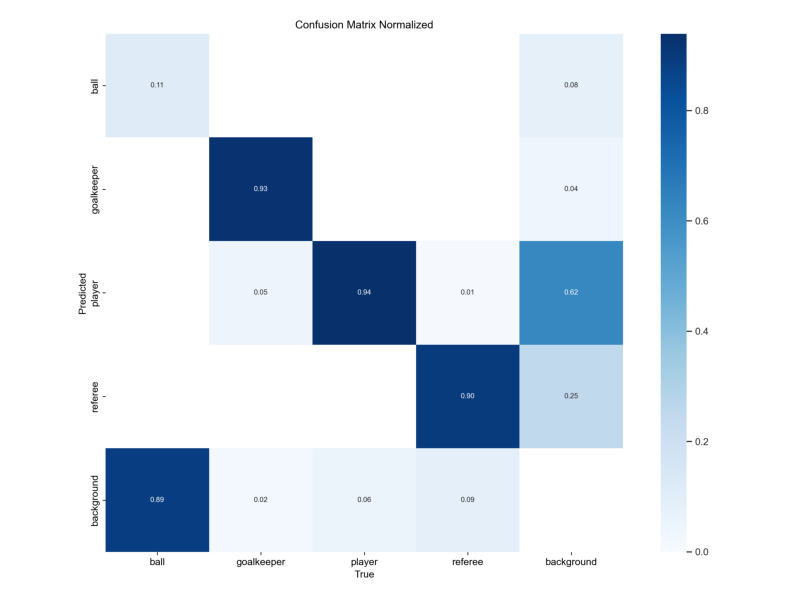

In [9]:
# load and show confusion matrix
matrix_path = os.path.join(cwd,"yolo_football_test" ,"yolo9c_dataset_baseline", "confusion_matrix_normalized.png")
plot_confusion_matrix(matrix_path)

### Qualitative Analysis on Challenging Samples

The qualitative analysis is based on three distinct samples:  
1. The first shows a stretched ball.  
2. The second features the ball under dim lighting conditions.  
3. The third depicts the ball partially occluded by a player.  

The purpose of this qualitative test is to assess the model’s performance under difficult conditions.


image 1/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\538438_1_10_png_jpg.rf.f0585e46a9ae3f1d0f64c24aaf7704b8.jpg: 384x640 21 players, 1 referee, 76.8ms
image 2/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\Screenshot-2025-01-03-112748_png.rf.763a7d889601c8b79d673b84cdc4ae64.jpg: 384x640 1 goalkeeper, 17 players, 2 referees, 64.8ms
image 3/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\c01561_1_6_png_jpg.rf.260b489d60904fa09f43dfb8daa38056.jpg: 384x640 22 players, 2 referees, 65.0ms
Speed: 3.5ms preprocess, 68.9ms inference, 5.8ms postprocess per image at shape (1, 3, 384, 640)


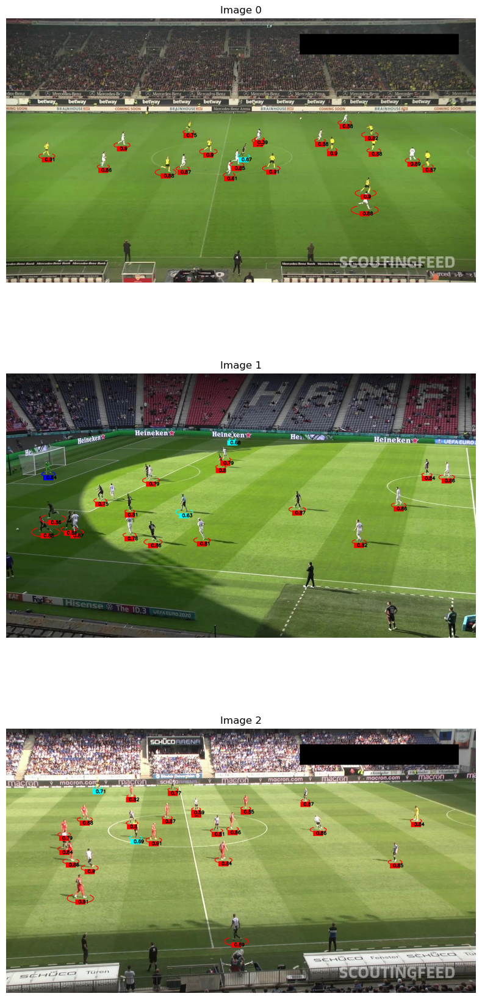

In [4]:
model_name = "yolo5L_dataset_baseline"
detect_images(images_to_test_path, r"yolo_football_analysis\yolo5L_dataset_baseline\weights\best.pt")

**Result:** <span style="color: red;">No ball was detected</span>

# Training with increased image size

One of the main limitations of standard YOLO training is that images are by default resized to 640x640 pixels, causing significant quality loss—especially for small objects like the ball.  
Therefore, increasing the input resolution to 1280x1280 is expected to improve detection performance.  

**Please note that this increase forced us to reduce the batch size from 16 to 4 due to GPU memory constraints.**


## Baseline Dataset

In [ ]:
model.train(data=os.path.join(dataset_path, "data.yaml"), epochs=50, imgsz=1280, save=True, project="yolo_football_analysis", 
            name="yolo9c_dataset_baseline_increased_imgsz", batch=4)

New https://pypi.org/project/ultralytics/8.3.82 available  Update with 'pip install -U ultralytics'
engine\trainer: task=detect, mode=train, model=yolov9c.pt, data=c:\Users\siani\PycharmProjects\AIxFootballAnalysis\src\training\../../dataset\yolov9\v0\data.yaml, epochs=50, time=None, patience=100, batch=4, imgsz=1280, save=True, save_period=-1, cache=False, device=cuda:0, workers=8, project=yolo_football_analysis, name=yolo9c_dataset_v0_high_res3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=

wandb: Currently logged in as: sianiemanuele (sianiemanuele_07) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed 


train: Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\train\labels.cache... 510 images, 0 backgrounds, 0 corrupt: 100%|██████████| 510/510 [00:00<?, ?it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\train\labels.cache... 510 images, 0 backgrounds, 0 corrupt: 100%|██████████| 510/510 [00:00<?, ?it/s]
val: Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]Scanning C:\Users\siani\PycharmProjects\AIxFootballAnalysis\dataset\yolov9\v0\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]


Plotting labels to yolo_football_analysis\yolo9c_dataset_v0_high_res3\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 1280 train, 1280 val
Using 8 dataloader workers
Logging results to yolo_football_analysis\yolo9c_dataset_v0_high_res3
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      11.3G     0.9391      1.016     0.8589         47       1280: 100%|██████████| 128/128 [31:56<00:00, 14.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.10s/it]


                   all         75       1796      0.379      0.758      0.391      0.268

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      11.1G     0.9737     0.6044     0.8676         76       1280: 100%|██████████| 128/128 [26:22<00:00, 12.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.68s/it]


                   all         75       1796      0.858      0.798      0.858      0.549

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      11.2G     0.9397     0.6588     0.8619         43       1280: 100%|██████████| 128/128 [26:17<00:00, 12.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:58<00:00,  5.81s/it]


                   all         75       1796      0.661      0.628       0.63      0.406

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      11.3G     0.9826      0.595     0.8648         88       1280: 100%|██████████| 128/128 [28:08<00:00, 13.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.42s/it]


                   all         75       1796      0.901      0.822      0.858      0.556

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      11.3G     0.9885     0.5499     0.8649         87       1280: 100%|██████████| 128/128 [24:34<00:00, 11.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.87s/it]


                   all         75       1796      0.791      0.862      0.885      0.576

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      11.3G     0.9031     0.4864     0.8566         98       1280: 100%|██████████| 128/128 [22:50<00:00, 10.71s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.63s/it]


                   all         75       1796      0.937      0.833      0.879      0.549

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      11.1G     0.9229        0.5      0.862         51       1280: 100%|██████████| 128/128 [23:44<00:00, 11.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:38<00:00,  3.84s/it]


                   all         75       1796      0.913       0.83      0.873       0.59

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      11.2G     0.9174     0.4972     0.8519        103       1280: 100%|██████████| 128/128 [26:17<00:00, 12.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:39<00:00,  3.93s/it]


                   all         75       1796      0.901      0.832       0.88       0.59

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      11.3G     0.8798     0.4692     0.8505         65       1280: 100%|██████████| 128/128 [24:26<00:00, 11.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.56s/it]


                   all         75       1796      0.926      0.836      0.888      0.561

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      11.3G     0.8863     0.4673     0.8395         96       1280: 100%|██████████| 128/128 [23:04<00:00, 10.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.66s/it]


                   all         75       1796      0.931      0.836      0.882      0.574

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      11.2G     0.8966     0.4589     0.8482         69       1280: 100%|██████████| 128/128 [25:24<00:00, 11.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.97s/it]


                   all         75       1796      0.879      0.852      0.878      0.585

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      11.2G     0.8284     0.4264     0.8361        114       1280: 100%|██████████| 128/128 [23:43<00:00, 11.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.26s/it]


                   all         75       1796      0.913      0.855      0.878      0.592

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      11.2G     0.8532     0.4296     0.8372         91       1280: 100%|██████████| 128/128 [23:26<00:00, 10.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.73s/it]


                   all         75       1796      0.934      0.838      0.887      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      11.2G     0.8318     0.4196     0.8375         97       1280: 100%|██████████| 128/128 [25:53<00:00, 12.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:57<00:00,  5.76s/it]


                   all         75       1796      0.921       0.84      0.886       0.58

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      11.3G     0.8481     0.4225     0.8382         34       1280: 100%|██████████| 128/128 [27:29<00:00, 12.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:58<00:00,  5.82s/it]


                   all         75       1796       0.92      0.868      0.898      0.611

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      11.3G      0.818     0.4099     0.8339        107       1280: 100%|██████████| 128/128 [24:11<00:00, 11.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.64s/it]


                   all         75       1796      0.933      0.865      0.893      0.607

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      11.3G      0.818     0.4032     0.8307        116       1280: 100%|██████████| 128/128 [23:32<00:00, 11.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.57s/it]


                   all         75       1796      0.873      0.867      0.885      0.607

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      11.3G     0.7915     0.3914     0.8331        129       1280: 100%|██████████| 128/128 [25:36<00:00, 12.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.26s/it]


                   all         75       1796      0.936      0.846      0.891      0.607

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      11.1G      0.787     0.3877     0.8349         34       1280: 100%|██████████| 128/128 [27:11<00:00, 12.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.72s/it]


                   all         75       1796      0.894      0.872      0.902      0.617

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      11.2G     0.8048     0.3916     0.8292         44       1280: 100%|██████████| 128/128 [23:03<00:00, 10.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.61s/it]


                   all         75       1796      0.936      0.856      0.893       0.61

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      11.2G     0.7769     0.3794     0.8268         83       1280: 100%|██████████| 128/128 [24:16<00:00, 11.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.43s/it]


                   all         75       1796      0.889      0.882      0.896      0.614

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      11.2G     0.8031     0.3863     0.8279         98       1280: 100%|██████████| 128/128 [25:10<00:00, 11.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.43s/it]


                   all         75       1796      0.922      0.874      0.892      0.608

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      11.2G     0.7759      0.373      0.825         30       1280: 100%|██████████| 128/128 [24:28<00:00, 11.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.72s/it]


                   all         75       1796      0.921      0.877      0.904       0.63

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      11.3G     0.7754     0.3681     0.8241         60       1280: 100%|██████████| 128/128 [26:25<00:00, 12.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.12s/it]


                   all         75       1796      0.933      0.871      0.905      0.627

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      11.1G     0.7628     0.3672     0.8238         87       1280: 100%|██████████| 128/128 [27:48<00:00, 13.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.55s/it]


                   all         75       1796      0.891      0.877      0.897      0.631

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      11.1G      0.776     0.3677     0.8276         57       1280: 100%|██████████| 128/128 [27:47<00:00, 13.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.04s/it]


                   all         75       1796      0.888      0.884      0.895      0.624

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      11.2G     0.7354     0.3488     0.8222         68       1280: 100%|██████████| 128/128 [27:24<00:00, 12.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:58<00:00,  5.86s/it]


                   all         75       1796      0.883      0.867      0.893      0.626

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      11.2G     0.7472     0.3565     0.8258         71       1280: 100%|██████████| 128/128 [27:11<00:00, 12.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.43s/it]


                   all         75       1796      0.916      0.872      0.895      0.609

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      11.2G     0.7404     0.3568     0.8215         75       1280: 100%|██████████| 128/128 [25:30<00:00, 11.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.51s/it]


                   all         75       1796      0.902      0.869      0.896      0.624

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      11.1G     0.7683     0.3618     0.8234         59       1280: 100%|██████████| 128/128 [28:08<00:00, 13.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.11s/it]


                   all         75       1796      0.908      0.842      0.881      0.618

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      11.3G     0.7609     0.3545     0.8213         72       1280: 100%|██████████| 128/128 [28:11<00:00, 13.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.76s/it]


                   all         75       1796      0.893      0.861      0.892      0.622

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      11.3G     0.7385     0.3442     0.8232         55       1280: 100%|██████████| 128/128 [25:35<00:00, 12.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.17s/it]


                   all         75       1796      0.908      0.893      0.909      0.636

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      11.2G     0.7424     0.3467     0.8209         60       1280: 100%|██████████| 128/128 [25:25<00:00, 11.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.19s/it]


                   all         75       1796      0.884      0.875      0.893      0.625

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      11.3G     0.7375     0.3461     0.8203         53       1280: 100%|██████████| 128/128 [27:18<00:00, 12.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.41s/it]


                   all         75       1796      0.936      0.866      0.906      0.629

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      11.3G     0.7142     0.3364     0.8171        101       1280: 100%|██████████| 128/128 [26:44<00:00, 12.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.97s/it]


                   all         75       1796      0.906       0.89      0.903      0.629

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      11.2G     0.7102     0.3374     0.8162         55       1280: 100%|██████████| 128/128 [26:46<00:00, 12.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.49s/it]


                   all         75       1796      0.926      0.881      0.903      0.637

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      11.3G     0.7016     0.3342     0.8165        143       1280: 100%|██████████| 128/128 [23:42<00:00, 11.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.73s/it]


                   all         75       1796      0.925      0.829      0.878      0.623

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      11.2G     0.6969     0.3287     0.8129         42       1280: 100%|██████████| 128/128 [24:54<00:00, 11.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.74s/it]


                   all         75       1796      0.898       0.88      0.905      0.625

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      11.3G     0.6925     0.3249     0.8128         87       1280: 100%|██████████| 128/128 [25:43<00:00, 12.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.55s/it]


                   all         75       1796      0.933      0.874      0.912      0.644

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      11.3G     0.6852      0.321     0.8114        178       1280: 100%|██████████| 128/128 [26:03<00:00, 12.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.45s/it]


                   all         75       1796      0.931      0.868      0.899      0.628
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      11.1G     0.6805     0.3204     0.8153         48       1280: 100%|██████████| 128/128 [25:34<00:00, 11.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.67s/it]


                   all         75       1796      0.896      0.887      0.896      0.626

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      11.1G     0.6737     0.3131     0.8173         46       1280: 100%|██████████| 128/128 [24:45<00:00, 11.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.68s/it]


                   all         75       1796      0.926      0.858      0.884       0.62

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.18G     0.6725     0.3169     0.8138         49       1280: 100%|██████████| 128/128 [24:19<00:00, 11.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:09<00:00,  1.02it/s]


                   all         75       1796      0.878      0.859      0.862      0.609

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      11.1G     0.6761     0.3134     0.8138         46       1280: 100%|██████████| 128/128 [28:57<00:00, 13.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.22s/it]


                   all         75       1796      0.929      0.884      0.906      0.632

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      11.1G     0.6685     0.3041     0.8181         44       1280: 100%|██████████| 128/128 [29:18<00:00, 13.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.31s/it]


                   all         75       1796      0.936      0.886      0.902      0.623

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.19G     0.6584     0.2998     0.8131         48       1280: 100%|██████████| 128/128 [26:59<00:00, 12.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:15<00:00,  1.50s/it]


                   all         75       1796      0.935      0.855      0.896      0.626

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.12G     0.6446     0.2935     0.8096         46       1280: 100%|██████████| 128/128 [24:00<00:00, 11.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:20<00:00,  2.03s/it]


                   all         75       1796       0.93      0.862      0.901      0.634

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      11.1G     0.6457     0.2909       0.81         48       1280: 100%|██████████| 128/128 [25:30<00:00, 11.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:38<00:00,  3.83s/it]


                   all         75       1796      0.888      0.889      0.905      0.632

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      11.1G     0.6314     0.2851     0.8098         49       1280: 100%|██████████| 128/128 [26:40<00:00, 12.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.76s/it]


                   all         75       1796      0.893      0.883      0.895      0.628

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      11.1G      0.625     0.2807     0.8085         47       1280: 100%|██████████| 128/128 [24:35<00:00, 11.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.72s/it]


                   all         75       1796      0.927      0.876      0.911      0.642

50 epochs completed in 22.221 hours.
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_v0_high_res3\weights\last.pt, 51.7MB
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_v0_high_res3\weights\best.pt, 51.7MB

Validating yolo_football_analysis\yolo9c_dataset_v0_high_res3\weights\best.pt...
Ultralytics 8.3.28  Python-3.10.0 torch-2.5.0 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:26<00:00,  2.65s/it]


                   all         75       1796      0.932      0.871      0.911      0.642
                  ball         73         73       0.92      0.589      0.753      0.362
            goalkeeper         50         50      0.849        0.9      0.904      0.666
                player         75       1493      0.984      0.996      0.994      0.805
               referee         75        180      0.975          1      0.993      0.736
Speed: 1.5ms preprocess, 339.4ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to yolo_football_analysis\yolo9c_dataset_v0_high_res3


lr/pg0,▃▆███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▁▁▁
lr/pg1,▃████▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁
lr/pg2,▃████▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
metrics/mAP50(B),▁▇▄▇█▇████████████████████████████▇█████
metrics/mAP50-95(B),▁▆▄▆▇▇▇▆▇▇▇▇▇▇▇▇▇▇▇███▇███████████▇█████
metrics/precision(B),▁▇▅█▆████▇██▇█▇▇███▇▇███▇▇██████▇█▇███▇█
metrics/recall(B),▄▁▆▇▆▆▆▆▇▇▇▇▇▇▇▇█▇█▇█▇▇▇▇██▇███▇▇█▇██▇▇▇
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,▇█▇██▇▇▆▆▆▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001CB48E39660>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

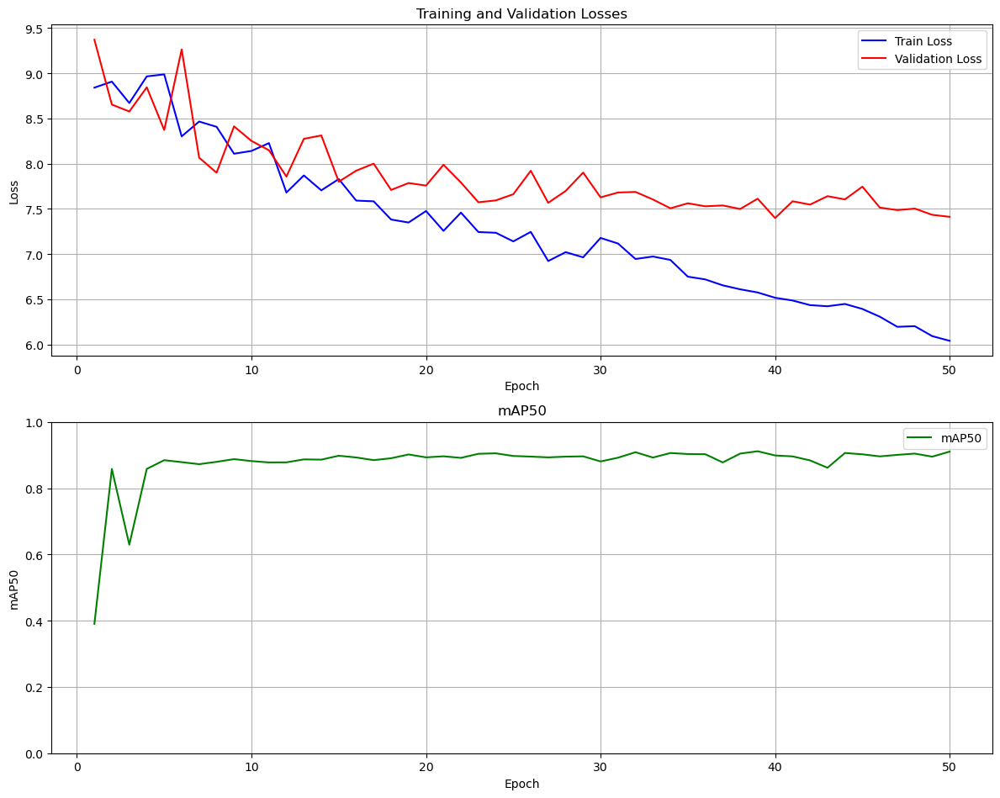

In [6]:
wandb.finish()
### Plots
results_path = os.path.join(cwd, "yolo_football_analysis", "yolo9c_dataset_baseline_increased_imgsz", "results.csv")
data = pd.read_csv(results_path)
plot_metrics(data)

### Quantitative Test

In [ ]:
model = YOLO(r"yolo_football_analysis\yolo9c_dataset_baseline_increased_imgsz\weights\best.pt")
model = model.cuda()
model.val(data=os.path.join(dataset_path, "data.yaml"), split="test", project="yolo_football_test", name="yolo9c_dataset_baseline_increased_imgsz")

YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


val: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\test\labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:12<00:00,  3.24s/it]


                   all         60       1452      0.929      0.877      0.917      0.671
                  ball         52         53      0.885      0.579      0.709      0.331
            goalkeeper         40         41      0.908      0.951      0.976      0.745
                player         60       1202      0.967      0.996      0.993      0.836
               referee         60        156      0.957      0.981      0.989      0.772
Speed: 4.5ms preprocess, 50.4ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to yolo_football_test\yolo9c_dataset_baseline_high_res2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000218BC5EAEC0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

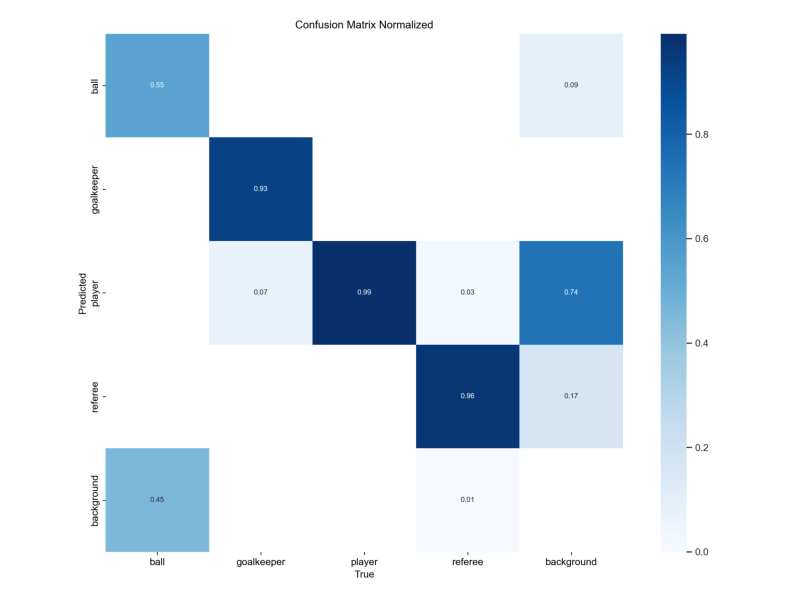

In [7]:
# load and show confusion matrix
matrix_path = os.path.join(cwd, "yolo_football_test", "yolo9c_dataset_baseline_increased_imgsz", "confusion_matrix_normalized.png")
plot_confusion_matrix(matrix_path)


The improvement is significant **(+44%)**

### Qualitative Analysis on Challenging Samples

The qualitative analysis is based on three distinct samples:  
1. The first shows a stretched ball.  
2. The second features the ball under dim lighting conditions.  
3. The third depicts the ball partially occluded by a player.  

The purpose of this qualitative test is to assess the model’s performance under difficult conditions.


image 1/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\538438_1_10_png_jpg.rf.f0585e46a9ae3f1d0f64c24aaf7704b8.jpg: 736x1280 1 ball, 20 players, 2 referees, 83.8ms
image 2/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\Screenshot-2025-01-03-112748_png.rf.763a7d889601c8b79d673b84cdc4ae64.jpg: 736x1280 1 ball, 1 goalkeeper, 21 players, 2 referees, 36.4ms
image 3/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\c01561_1_6_png_jpg.rf.260b489d60904fa09f43dfb8daa38056.jpg: 736x1280 1 goalkeeper, 20 players, 2 referees, 40.9ms
Speed: 6.6ms preprocess, 53.7ms inference, 1.0ms postprocess per image at shape (1, 3, 736, 1280)


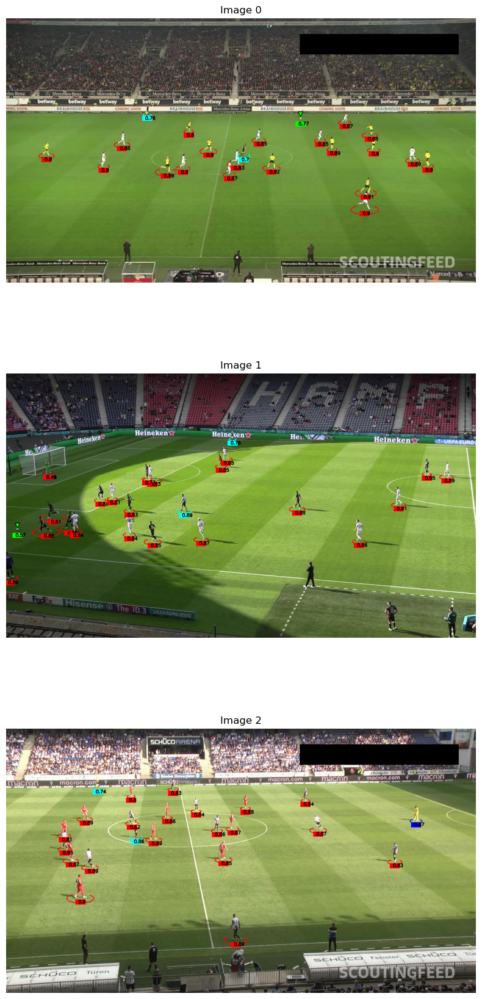

In [ ]:
detect_images(images_to_test_path, r"yolo_football_analysis\yolo9c_dataset_baseline_increased_imgsz\weights\best.pt")

**Result:** 
1. Detected with 0.77 confidence
2. Detected with 0.57 confidence
3. Undetected

# Copy-paste augmentation

This section contains the code for training and evaluation on the copy-paste augmented dataset.  
Detailed information about this dataset can be found in its dedicated section at the beginning of the notebook.

In [ ]:
mp.freeze_support()  # Necessario su Windows
model = YOLO("yolov9c.pt")
model = model.cuda()
dataset_path = os.path.join(dataset_root_folder, "yolov9", "copy-paste-augmented")

In [ ]:
model.train(data=os.path.join(dataset_path, "data.yaml"), epochs=50, imgsz=1280, save=True, project="yolo_football_analysis", 
            name="yolo9c_dataset_CpAug", batch=4)
wandb.finish()

New https://pypi.org/project/ultralytics/8.3.91 available  Update with 'pip install -U ultralytics'
engine\trainer: task=detect, mode=train, model=yolov9c.pt, data=c:\Users\laura\OneDrive\Desktop\Magistrale\Machine learning for vision\AIxFootballAnalysis\src\training\../../dataset\yolov9\v3\data.yaml, epochs=50, time=None, patience=100, batch=4, imgsz=1280, save=True, save_period=-1, cache=False, device=cuda:0, workers=8, project=yolo_football_analysis, name=yolo9c_dataset_v3_high_res, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, c

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: sianiemanuele (sianiemanuele_07) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed 


train: Scanning C:\Users\laura\OneDrive\Desktop\Magistrale\Machine learning for vision\AIxFootballAnalysis\dataset\yolov9\v3\train\labels... 1530 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1530/1530 [00:02<00:00, 701.72it/s]


train: New cache created: C:\Users\laura\OneDrive\Desktop\Magistrale\Machine learning for vision\AIxFootballAnalysis\dataset\yolov9\v3\train\labels.cache


val: Scanning C:\Users\laura\OneDrive\Desktop\Magistrale\Machine learning for vision\AIxFootballAnalysis\dataset\yolov9\v3\valid\labels... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<00:00, 346.01it/s]

val: New cache created: C:\Users\laura\OneDrive\Desktop\Magistrale\Machine learning for vision\AIxFootballAnalysis\dataset\yolov9\v3\valid\labels.cache


Plotting labels to yolo_football_analysis\yolo9c_dataset_v3_high_res\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
Image sizes 1280 train, 1280 val
Using 8 dataloader workers
Logging results to yolo_football_analysis\yolo9c_dataset_v3_high_res
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      11.2G     0.9091     0.7324     0.8499        136       1280: 100%|██████████| 383/383 [1:21:18<00:00, 12.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:32<00:00,  3.27s/it]

                   all         75       1796      0.914      0.789      0.855      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      11.2G     0.9099     0.4855     0.8465        118       1280: 100%|██████████| 383/383 [1:12:23<00:00, 11.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:37<00:00,  3.77s/it]

                   all         75       1796      0.959      0.802      0.868      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      11.1G     0.9172     0.4969     0.8473         65       1280: 100%|██████████| 383/383 [1:15:55<00:00, 11.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.83s/it]

                   all         75       1796      0.953      0.806      0.888      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      11.1G     0.8759     0.4573     0.8419         93       1280: 100%|██████████| 383/383 [1:18:05<00:00, 12.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.25s/it]

                   all         75       1796      0.935        0.8       0.86      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      11.3G     0.8783     0.4432     0.8415        123       1280: 100%|██████████| 383/383 [1:06:28<00:00, 10.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.95s/it]

                   all         75       1796      0.925      0.796      0.864      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      11.3G     0.8552     0.4326     0.8399        121       1280: 100%|██████████| 383/383 [1:16:22<00:00, 11.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.64s/it]

                   all         75       1796      0.917      0.839      0.881      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      11.1G     0.8415     0.4236     0.8328         92       1280: 100%|██████████| 383/383 [1:17:48<00:00, 12.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.13s/it]

                   all         75       1796       0.92      0.841      0.878      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      11.1G     0.8198     0.3888     0.8295        116       1280: 100%|██████████| 383/383 [1:08:37<00:00, 10.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.88s/it]

                   all         75       1796        0.9      0.835      0.889       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      11.1G     0.7996     0.3874     0.8267         78       1280: 100%|██████████| 383/383 [1:18:38<00:00, 12.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.10s/it]

                   all         75       1796      0.928      0.868      0.901      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      11.3G     0.7974     0.3825     0.8277        105       1280: 100%|██████████| 383/383 [1:21:13<00:00, 12.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.53s/it]

                   all         75       1796      0.868      0.878      0.876      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      11.2G     0.7819     0.3758      0.825         75       1280: 100%|██████████| 383/383 [1:24:08<00:00, 13.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.42s/it]

                   all         75       1796      0.897      0.865      0.887      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      11.2G     0.7797     0.3746     0.8236        176       1280: 100%|██████████| 383/383 [1:29:27<00:00, 14.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.43s/it]

                   all         75       1796      0.858      0.868      0.888      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      11.1G     0.7813     0.3838     0.8244        104       1280: 100%|██████████| 383/383 [1:14:38<00:00, 11.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.53s/it]

                   all         75       1796      0.873      0.874      0.884      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      11.2G     0.7794     0.3738     0.8238         99       1280: 100%|██████████| 383/383 [1:18:55<00:00, 12.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.14s/it]

                   all         75       1796      0.901      0.835      0.873      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      11.2G     0.7561     0.3593     0.8207         58       1280: 100%|██████████| 383/383 [1:23:56<00:00, 13.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.45s/it]

                   all         75       1796      0.908      0.884      0.902      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      11.2G     0.7339     0.3497     0.8171         46       1280: 100%|██████████| 383/383 [1:15:09<00:00, 11.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.19s/it]

                   all         75       1796      0.929      0.877        0.9      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      11.2G     0.7625      0.364      0.822         94       1280: 100%|██████████| 383/383 [1:12:07<00:00, 11.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.07s/it]

                   all         75       1796      0.902      0.878       0.91      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      11.2G     0.7373      0.348     0.8179         46       1280: 100%|██████████| 383/383 [1:11:17<00:00, 11.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:36<00:00,  3.60s/it]

                   all         75       1796      0.902      0.865      0.896      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      11.3G     0.7335     0.3432     0.8174        150       1280: 100%|██████████| 383/383 [1:12:50<00:00, 11.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.66s/it]

                   all         75       1796      0.892      0.881      0.906      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      11.2G     0.7175     0.3343     0.8136         51       1280: 100%|██████████| 383/383 [1:14:22<00:00, 11.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.30s/it]

                   all         75       1796      0.911      0.866      0.902      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      11.2G     0.7271     0.3468     0.8165        139       1280: 100%|██████████| 383/383 [1:15:45<00:00, 11.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.70s/it]

                   all         75       1796      0.897      0.872      0.909       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      11.2G     0.7267     0.3415     0.8152         60       1280: 100%|██████████| 383/383 [1:19:42<00:00, 12.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.79s/it]

                   all         75       1796      0.918      0.861       0.89       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      11.2G     0.7157     0.3377     0.8137         52       1280: 100%|██████████| 383/383 [1:21:27<00:00, 12.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.79s/it]

                   all         75       1796      0.905      0.874      0.889      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      11.2G      0.707     0.3362     0.8142        167       1280: 100%|██████████| 383/383 [1:10:02<00:00, 10.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.29s/it]

                   all         75       1796      0.911      0.867      0.906       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      11.3G     0.7046     0.3311     0.8106         86       1280: 100%|██████████| 383/383 [1:05:20<00:00, 10.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.24s/it]

                   all         75       1796      0.912      0.879      0.911       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      11.2G     0.6887     0.3233     0.8089         52       1280: 100%|██████████| 383/383 [1:17:40<00:00, 12.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.43s/it]

                   all         75       1796      0.911      0.855      0.891      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      11.2G     0.6787     0.3184     0.8068        112       1280: 100%|██████████| 383/383 [1:24:39<00:00, 13.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.75s/it]

                   all         75       1796      0.927      0.879      0.908      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      11.2G     0.6756     0.3164     0.8073         98       1280: 100%|██████████| 383/383 [1:15:52<00:00, 11.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.53s/it]

                   all         75       1796       0.92      0.873      0.901      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      11.3G     0.6638     0.3095     0.8057         71       1280: 100%|██████████| 383/383 [1:17:12<00:00, 12.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.59s/it]

                   all         75       1796      0.942      0.854      0.901      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      11.3G     0.6556     0.3091     0.8049        110       1280: 100%|██████████| 383/383 [1:10:33<00:00, 11.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.18s/it]

                   all         75       1796      0.898      0.903      0.909      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      11.2G     0.6558     0.3085     0.8046        100       1280: 100%|██████████| 383/383 [1:21:00<00:00, 12.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.93s/it]

                   all         75       1796      0.928      0.881      0.911      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      11.2G     0.6481     0.3059     0.8038         38       1280: 100%|██████████| 383/383 [1:19:24<00:00, 12.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.32s/it]

                   all         75       1796      0.843      0.899        0.9      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      11.2G     0.6327     0.2987     0.8018         76       1280: 100%|██████████| 383/383 [1:23:30<00:00, 13.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.33s/it]

                   all         75       1796      0.896       0.91      0.912      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      11.2G     0.6346     0.2974     0.8012         92       1280: 100%|██████████| 383/383 [1:17:40<00:00, 12.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.80s/it]

                   all         75       1796      0.914      0.884      0.912      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      11.1G     0.6266     0.2903     0.8001        159       1280: 100%|██████████| 383/383 [1:18:44<00:00, 12.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.86s/it]

                   all         75       1796      0.918      0.886      0.905      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      11.3G     0.6049     0.2822     0.7972         72       1280: 100%|██████████| 383/383 [1:23:26<00:00, 13.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.55s/it]

                   all         75       1796      0.886      0.899      0.899      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      11.1G     0.5985     0.2797      0.798         56       1280: 100%|██████████| 383/383 [1:25:09<00:00, 13.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:36<00:00,  3.67s/it]

                   all         75       1796      0.915      0.877      0.911      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      11.2G     0.5999     0.2821     0.7958         83       1280: 100%|██████████| 383/383 [1:18:14<00:00, 12.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.27s/it]

                   all         75       1796      0.914      0.888      0.909      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      11.2G     0.5877     0.2751     0.7947        148       1280: 100%|██████████| 383/383 [1:18:19<00:00, 12.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:34<00:00,  3.49s/it]

                   all         75       1796       0.93      0.875      0.912       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      11.3G     0.5779     0.2698     0.7944         60       1280: 100%|██████████| 383/383 [1:08:46<00:00, 10.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.19s/it]

                   all         75       1796      0.915      0.875      0.905      0.642


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      10.8G     0.5676     0.2646     0.7961         47       1280: 100%|██████████| 383/383 [1:22:14<00:00, 12.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.56s/it]

                   all         75       1796      0.925      0.874      0.894      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      10.8G     0.5551     0.2643     0.7929         52       1280: 100%|██████████| 383/383 [1:28:48<00:00, 13.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.92s/it]

                   all         75       1796      0.916      0.867      0.886       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      10.8G     0.5501     0.2624     0.7949         54       1280: 100%|██████████| 383/383 [1:25:03<00:00, 13.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.17s/it]

                   all         75       1796      0.926      0.869       0.87      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50       6.3G     0.5391     0.2545     0.7919         54       1280: 100%|██████████| 383/383 [1:29:25<00:00, 14.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:24<00:00,  2.44s/it]

                   all         75       1796      0.912      0.855      0.867      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      10.8G     0.5283     0.2489     0.7904         47       1280: 100%|██████████| 383/383 [1:23:20<00:00, 13.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.22s/it]

                   all         75       1796      0.887      0.864      0.846        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      10.8G     0.5265     0.2497     0.7897         49       1280: 100%|██████████| 383/383 [1:20:46<00:00, 12.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.73s/it]

                   all         75       1796       0.92      0.879       0.91      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      10.8G     0.5088     0.2425     0.7895         47       1280: 100%|██████████| 383/383 [1:28:57<00:00, 13.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.17s/it]

                   all         75       1796      0.941      0.859      0.899      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      10.8G     0.4973     0.2361     0.7868         46       1280: 100%|██████████| 383/383 [1:23:13<00:00, 13.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.21s/it]

                   all         75       1796      0.889      0.892      0.888      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      10.8G     0.4904      0.233      0.786         50       1280: 100%|██████████| 383/383 [1:25:06<00:00, 13.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.34s/it]

                   all         75       1796      0.928      0.865      0.903      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.14G     0.4851     0.2301     0.7857         44       1280: 100%|██████████| 383/383 [1:16:07<00:00, 11.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:25<00:00,  2.56s/it]

                   all         75       1796       0.92      0.867      0.895      0.628



50 epochs completed in 66.142 hours.
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_v3_high_res\weights\last.pt, 51.7MB
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_v3_high_res\weights\best.pt, 51.7MB

Validating yolo_football_analysis\yolo9c_dataset_v3_high_res\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:07<00:00,  1.41it/s]


                   all         75       1796      0.928      0.881      0.911      0.652
                  ball         73         73       0.89      0.557      0.703      0.348
            goalkeeper         50         50      0.844      0.973      0.959      0.723
                player         75       1493      0.991      0.994      0.995      0.813
               referee         75        180      0.988          1      0.988      0.726
Speed: 1.5ms preprocess, 80.4ms inference, 0.0ms loss, 2.1ms postprocess per image
Results saved to yolo_football_analysis\yolo9c_dataset_v3_high_res


lr/pg0,▃▆███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁
lr/pg1,▃▆███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg2,▃▆███▇▇▇▇▇▇▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
metrics/mAP50(B),▂▃▅▂▅▅▇▅▅▅▇▇█▆▇█▆▆▇██▇▇████▇▇██▇▆▅▄▁█▇▅█
metrics/mAP50-95(B),▁▂▃▂▄▅▆▆▅▄▅▆▆▆▆▇▆▆▆▇▅▇▆▇▇▇▇▇▇▇▇▇▆▆▅▄▇▆▆█
metrics/precision(B),▅██▇▆▆▄▆▃▄▃▄▅▆▅▄▅▄▅▅▅▅▆▆▇▆▁▄▅▆▅▅▅▆▅▅▄▇▄▆
metrics/recall(B),▁▂▂▂▁▄▆▆▅▆▄▇▆▆▅▅▆▅▆▆▅▆▆▅█▇█▇▇▇▇▆▆▆▆▅▅▅▇▆
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,███▇▇▇▆▆▆▆▆▅▅▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁


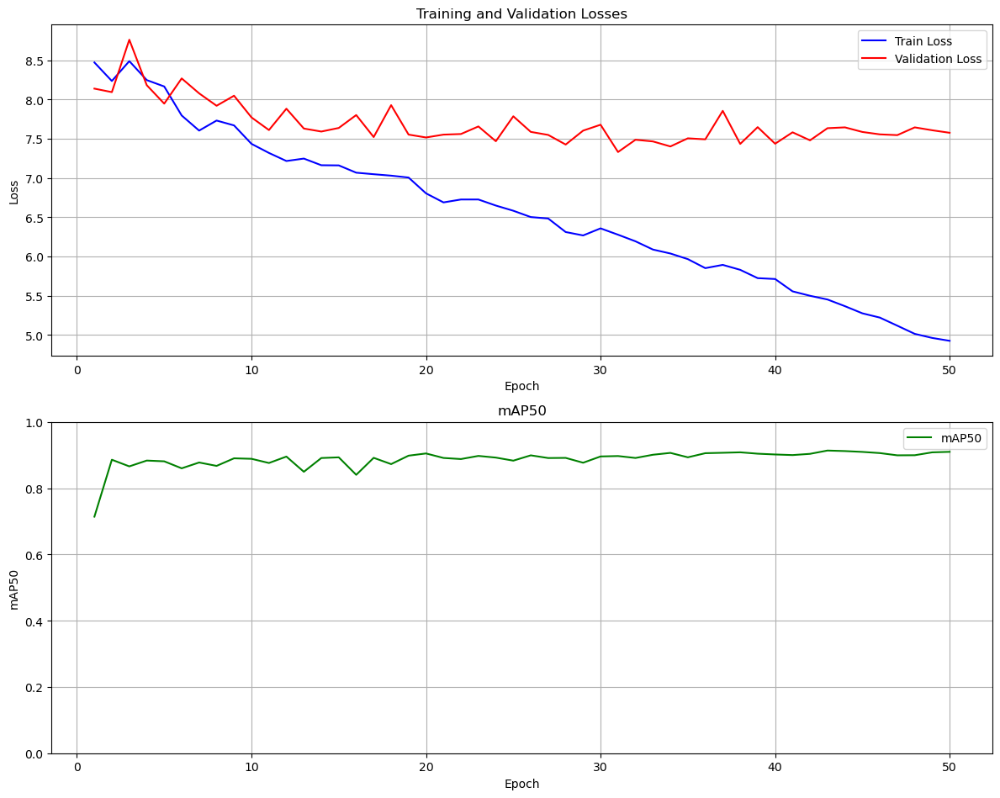

In [30]:
### Plots
results_path = os.path.join(cwd, "yolo_football_analysis", "yolo9c_dataset_CpAug", "results.csv")
data = pd.read_csv(results_path)
plot_metrics(data)

### Quantitative Test

In [ ]:
model = YOLO(r"yolo_football_analysis\yolo9c_dataset_CpAug\weights\best.pt")
model = model.cuda()
model.val(data=os.path.join(dataset_path, "data.yaml"), split="test", project="yolo_football_test", name="yolo9c_dataset_CpAug")

YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


val: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\test\labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.35s/it]


                   all         60       1452      0.955      0.884       0.91      0.686
                  ball         52         53       0.88      0.623      0.681      0.326
            goalkeeper         40         41          1      0.947      0.971      0.785
                player         60       1202      0.985      0.993      0.994      0.849
               referee         60        156      0.956      0.974      0.992      0.785
Speed: 3.4ms preprocess, 47.8ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to yolo_football_test\yolo9c_dataset_CpAug2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000002188C9E3340>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

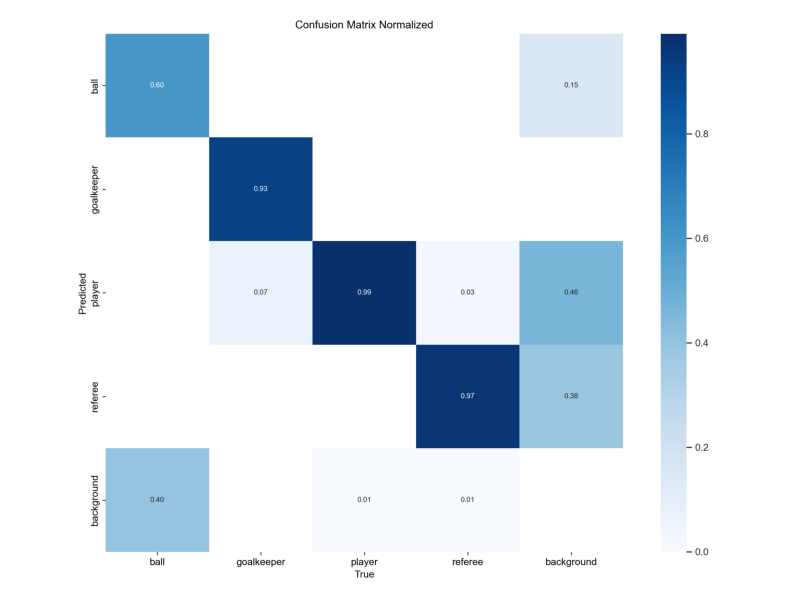

In [19]:
# load and show confusion matrix
matrix_path = os.path.join(cwd, "yolo_football_test", "yolo9c_dataset_CpAug", "confusion_matrix_normalized.png")
plot_confusion_matrix(matrix_path)


### Qualitative Analysis on Challenging Samples

The qualitative analysis is based on three distinct samples:  
1. The first shows a stretched ball.  
2. The second features the ball under dim lighting conditions.  
3. The third depicts the ball partially occluded by a player.  

The purpose of this qualitative test is to assess the model’s performance under difficult conditions.


image 1/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\538438_1_10_png_jpg.rf.f0585e46a9ae3f1d0f64c24aaf7704b8.jpg: 736x1280 1 ball, 20 players, 2 referees, 55.7ms
image 2/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\Screenshot-2025-01-03-112748_png.rf.763a7d889601c8b79d673b84cdc4ae64.jpg: 736x1280 1 ball, 1 goalkeeper, 20 players, 2 referees, 51.6ms
image 3/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\c01561_1_6_png_jpg.rf.260b489d60904fa09f43dfb8daa38056.jpg: 736x1280 1 goalkeeper, 20 players, 2 referees, 35.5ms
Speed: 3.8ms preprocess, 47.6ms inference, 0.4ms postprocess per image at shape (1, 3, 736, 1280)


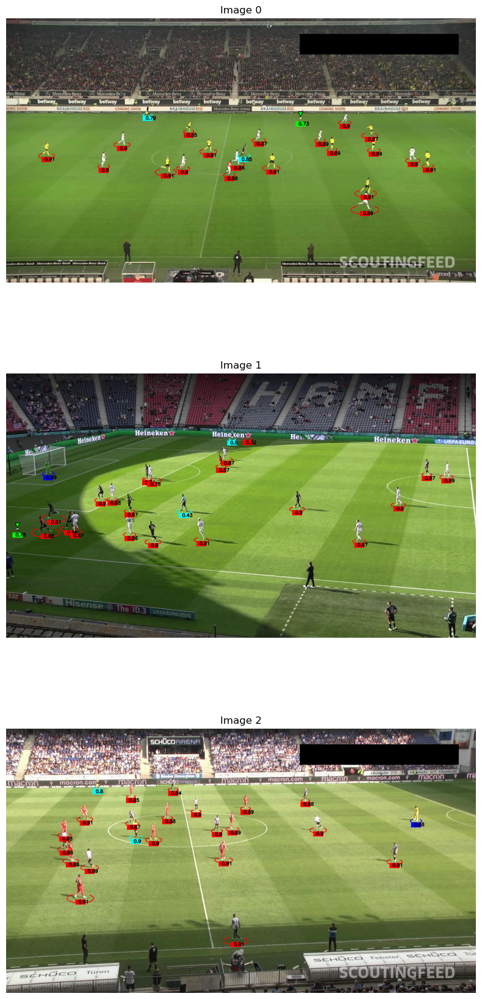

In [6]:
detect_images(images_to_test_path, r"yolo_football_analysis\yolo9c_dataset_CpAug\weights\best.pt")

Result: 
1. Detected with 0.73 confidence (-0.04)
2. Detected with 0.78 confidence (+0.21)
3. Undetected

# Super Resolution YOLO (SRYOLO)

We propose a novel hybridization of ESRGAN and YOLO, referred to as _Super Resolution (SR) YOLO_.  
A Real-ESRGAN preprocessing layer is applied **on the fly** as the first step of the pipeline, during **training, validation, and prediction** phases.

The idea behind this integration is to enhance the low quality of the input images and make the edges of small objects — particularly the ball — more well-defined and easier to detect.

We employ the lighter pretrained model from the Real-ESRGAN project, specifically `'realesr-general-x4v3.pth'`, available at:  
[https://github.com/xinntao/Real-ESRGAN](https://github.com/xinntao/Real-ESRGAN)

The exact implementation of our hybrid model can be found here:

```
code\models\SRYOLO\SuperResolutionYOLO.py
```


**Important Note:**  
Real-ESRGAN performs a 4× upscaling of the input image. To keep YOLO training compatible with image sizes (1280x1280), the super-resolved image is **downscaled back to the original resolution** right after enhancement. This allows the model to benefit from sharpened textures and cleaner contours without requiring architectural changes or retraining with larger images.

## SR Yolo - No FineTuning

**Example of Super Resolution Application (without FineTuning)**
Original image:
![Image 1](../../dataset\yolov9\copy-paste-augmented\train\images\Screenshot-2025-01-03-113511_png.rf.f0116a752552cc0e8ca1d38b87f170fd.jpg)

Enhanced (No finetuning)
![Image 2](../../code\models\esrgan\test_output\base.jpg)

In [9]:
mp.freeze_support()  # Necessario su Windows
cwd = os.getcwd()
gan_weights = os.path.join(cwd, "..", "models", "esrgan", "pretrained", "realesr-general-x4v3.pth")
model = SRYOLO(
        yolo_weights="yolov9c.pt",
        upscale=4,
        gan_weights=gan_weights,
        dni_weight=0.5,
        tile=0,
        tile_pad=10
    )
model = model.cuda()

Device for Super-Resolution: cuda
Load model from c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\models\esrgan\pretrained\realesr-general-x4v3.pth
Super-Resolution model loaded successfully. 👍


In [11]:
dataset_path = os.path.join(dataset_root_folder, "yolov9", "baseline")

In [12]:
model.train(data=os.path.join(dataset_path, "data.yaml"), epochs=50, imgsz=1280, save=True, project="yolo_football_analysis", 
            name="yoloSR_dataset_baseline", batch=4)
wandb.finish()


Found existing cache for 'train'. Deleting to force regeneration...

--- Checking cache for split 'train' ---
Looking for original images in: c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\train\images
Found 510 original image files.
Creating cache for 'train'...


Caching train: 100%|██████████| 510/510 [1:02:11<00:00,  7.32s/it]


Found existing cache for 'valid'. Deleting to force regeneration...

--- Checking cache for split 'valid' ---
Looking for original images in: c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\valid\images
Found 75 original image files.
Creating cache for 'valid'...


Caching valid: 100%|██████████| 75/75 [05:50<00:00,  4.68s/it]



Training started using cached dataset specified in: c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cached_data.yaml

SR model released from memory. Starting YOLO training.
New https://pypi.org/project/ultralytics/8.3.161 available  Update with 'pip install -U ultralytics'
engine\trainer: task=detect, mode=train, model=yolov9c.pt, data=c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cached_data.yaml, epochs=50, time=None, patience=100, batch=4, imgsz=1280, save=True, save_period=-1, cache=False, device=cuda:0, workers=8, project=yolo_football_analysis, name=yoloSR_dataset_baseline, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val

wandb: Currently logged in as: sianiemanuele (sianiemanuele_07) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed 


train: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_train\labels...:   0%|          | 0/510 [00:00<?, ?it/s]Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_train\labels... 9 images, 0 backgrounds, 0 corrupt:   2%|▏         | 9/510 [00:00<00:06, 76.00it/s]Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_train\labels... 19 images, 0 backgrounds, 0 corrupt:   4%|▎         | 19/510 [00:00<00:06, 80.74it/s]Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_train\labels... 34 images, 0 backgrounds, 0 corrupt:   7%|▋         | 34/510 [00:00<00:04, 108.57it/s]Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_train\labels... 46 images, 0 backgrounds, 0 corrup

train: New cache created: C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_train\labels.cache


val: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_valid\labels...:   0%|          | 0/75 [00:00<?, ?it/s]Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_valid\labels... 3 images, 0 backgrounds, 0 corrupt:   4%|▍         | 3/75 [00:00<00:02, 29.84it/s]Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_valid\labels... 14 images, 0 backgrounds, 0 corrupt:  19%|█▊        | 14/75 [00:00<00:00, 75.50it/s]Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_valid\labels... 26 images, 0 backgrounds, 0 corrupt:  35%|███▍      | 26/75 [00:00<00:00, 74.95it/s]Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_valid\labels... 36 images, 0 backgrounds, 0 corrupt:  48%

val: New cache created: C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_valid\labels.cache
Plotting labels to yolo_football_analysis\yoloSR_dataset_baseline\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 1280 train, 1280 val
Using 8 dataloader workers
Logging results to yolo_football_analysis\yoloSR_dataset_baseline
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      11.4G     0.9473      1.039     0.8605         47       1280: 100%|██████████| 128/128 [1:06:25<00:00, 31.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:42<00:00, 10.26s/it]


                   all         75       1796      0.848      0.782      0.824      0.531

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      11.1G      1.008     0.6896     0.8696         76       1280: 100%|██████████| 128/128 [55:35<00:00, 26.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:17<00:00,  7.71s/it]


                   all         75       1796      0.795      0.744      0.792       0.52

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      11.2G      0.964     0.6058     0.8648         43       1280: 100%|██████████| 128/128 [56:20<00:00, 26.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:51<00:00, 11.17s/it]


                   all         75       1796      0.897      0.794      0.837      0.536

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      11.3G      0.987     0.5596     0.8629         88       1280: 100%|██████████| 128/128 [56:57<00:00, 26.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:33<00:00,  9.39s/it]


                   all         75       1796      0.865      0.837      0.845      0.511

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      11.3G      1.027     0.5417     0.8662         87       1280: 100%|██████████| 128/128 [52:45<00:00, 24.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:30<00:00,  9.07s/it]


                   all         75       1796      0.921       0.82      0.869      0.572

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      11.3G     0.9095     0.4865     0.8568         98       1280: 100%|██████████| 128/128 [50:11<00:00, 23.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:31<00:00,  9.19s/it]


                   all         75       1796      0.894      0.805       0.85      0.538

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      11.1G     0.9755     0.5035     0.8604         51       1280: 100%|██████████| 128/128 [55:05<00:00, 25.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:26<00:00,  8.69s/it]


                   all         75       1796      0.941      0.816      0.864      0.572

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      11.2G     0.9051     0.4748     0.8476        103       1280: 100%|██████████| 128/128 [50:14<00:00, 23.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:32<00:00,  9.28s/it]


                   all         75       1796      0.918      0.825      0.869      0.547

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      11.3G     0.8741      0.454     0.8473         65       1280: 100%|██████████| 128/128 [30:21<00:00, 14.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:00<00:00,  6.00s/it]


                   all         75       1796      0.871      0.833      0.868      0.544

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      11.3G     0.9337      0.467     0.8439         96       1280: 100%|██████████| 128/128 [22:46<00:00, 10.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.75s/it]


                   all         75       1796      0.882      0.809      0.859      0.556

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      11.2G     0.8695     0.4353      0.844         69       1280: 100%|██████████| 128/128 [25:12<00:00, 11.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.78s/it]


                   all         75       1796      0.871      0.849      0.872      0.585

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      11.2G     0.8661     0.4309     0.8395        114       1280: 100%|██████████| 128/128 [23:11<00:00, 10.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.48s/it]


                   all         75       1796      0.933      0.829      0.873      0.579

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      11.2G     0.8667     0.4275     0.8375         91       1280: 100%|██████████| 128/128 [26:01<00:00, 12.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.65s/it]


                   all         75       1796      0.865      0.835      0.869      0.575

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      11.2G     0.8226      0.406     0.8332         97       1280: 100%|██████████| 128/128 [26:19<00:00, 12.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:58<00:00,  5.83s/it]


                   all         75       1796      0.857      0.826       0.87      0.572

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      11.3G     0.8421     0.4232      0.836         34       1280: 100%|██████████| 128/128 [26:17<00:00, 12.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:56<00:00,  5.68s/it]


                   all         75       1796      0.904      0.814      0.888      0.577

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      11.3G     0.8374     0.4126     0.8405        107       1280: 100%|██████████| 128/128 [25:32<00:00, 11.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.02s/it]


                   all         75       1796      0.926      0.835      0.869      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      11.3G     0.8186     0.4032     0.8324        116       1280: 100%|██████████| 128/128 [26:07<00:00, 12.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:01<00:00,  6.16s/it]


                   all         75       1796      0.887      0.834      0.864      0.596

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      11.3G     0.8128     0.3953      0.836        129       1280: 100%|██████████| 128/128 [26:38<00:00, 12.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:40<00:00,  4.05s/it]


                   all         75       1796      0.924      0.835      0.874        0.6

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      11.1G      0.824     0.4015     0.8385         34       1280: 100%|██████████| 128/128 [27:55<00:00, 13.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.31s/it]


                   all         75       1796      0.844      0.835      0.857      0.582

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      11.2G     0.8044     0.3969     0.8285         44       1280: 100%|██████████| 128/128 [24:07<00:00, 11.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.85s/it]


                   all         75       1796      0.877      0.848      0.875      0.605

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      11.2G     0.7888     0.3885     0.8273         83       1280: 100%|██████████| 128/128 [23:32<00:00, 11.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.72s/it]


                   all         75       1796      0.912       0.84      0.875      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      11.2G     0.7877     0.3791     0.8271         98       1280: 100%|██████████| 128/128 [22:10<00:00, 10.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.34s/it]


                   all         75       1796       0.83      0.845      0.863      0.596

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      11.2G     0.7972     0.3782     0.8291         30       1280: 100%|██████████| 128/128 [25:02<00:00, 11.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.73s/it]


                   all         75       1796      0.871      0.861      0.888      0.608

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      11.3G     0.8098     0.3852     0.8289         60       1280: 100%|██████████| 128/128 [23:49<00:00, 11.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.85s/it]


                   all         75       1796      0.906      0.849      0.887      0.608

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      11.1G      0.776     0.3792     0.8239         87       1280: 100%|██████████| 128/128 [25:17<00:00, 11.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:40<00:00,  4.07s/it]


                   all         75       1796      0.848      0.861      0.879      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      11.1G     0.7777     0.3699     0.8276         57       1280: 100%|██████████| 128/128 [29:53<00:00, 14.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.33s/it]


                   all         75       1796      0.884      0.863      0.881      0.606

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      11.2G     0.7616     0.3684     0.8252         68       1280: 100%|██████████| 128/128 [26:18<00:00, 12.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:01<00:00,  6.17s/it]


                   all         75       1796      0.913      0.854       0.88      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      11.2G     0.7543     0.3638     0.8265         71       1280: 100%|██████████| 128/128 [26:28<00:00, 12.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.21s/it]


                   all         75       1796       0.87      0.854      0.873      0.607

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      11.2G     0.7452     0.3578     0.8225         75       1280: 100%|██████████| 128/128 [27:06<00:00, 12.71s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.36s/it]


                   all         75       1796      0.908      0.877       0.89      0.608

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      11.1G     0.7807     0.3717     0.8243         59       1280: 100%|██████████| 128/128 [25:34<00:00, 11.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.15s/it]


                   all         75       1796       0.89      0.852      0.883      0.591

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      11.3G     0.7882     0.3718     0.8249         72       1280: 100%|██████████| 128/128 [22:29<00:00, 10.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.20s/it]


                   all         75       1796      0.898      0.873      0.891      0.606

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      11.3G     0.7623     0.3595     0.8258         55       1280: 100%|██████████| 128/128 [28:31<00:00, 13.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.57s/it]


                   all         75       1796      0.928      0.862      0.905      0.619

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      11.2G     0.7322     0.3409     0.8198         60       1280: 100%|██████████| 128/128 [27:00<00:00, 12.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.53s/it]


                   all         75       1796      0.888      0.851      0.883      0.605

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      11.3G     0.7425     0.3474       0.82         53       1280: 100%|██████████| 128/128 [27:32<00:00, 12.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.37s/it]


                   all         75       1796      0.929      0.854      0.891      0.615

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      11.2G     0.7273     0.3417     0.8186        101       1280: 100%|██████████| 128/128 [25:16<00:00, 11.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.88s/it]


                   all         75       1796      0.942      0.833      0.872      0.609

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      11.2G     0.7135     0.3375     0.8172         55       1280: 100%|██████████| 128/128 [26:43<00:00, 12.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.74s/it]


                   all         75       1796      0.942      0.847      0.898      0.625

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      11.3G     0.7067     0.3351     0.8172        143       1280: 100%|██████████| 128/128 [24:05<00:00, 11.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.05s/it]


                   all         75       1796      0.906      0.845      0.883      0.609

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      11.2G     0.7046     0.3294     0.8133         42       1280: 100%|██████████| 128/128 [25:21<00:00, 11.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.57s/it]


                   all         75       1796      0.879      0.864      0.885      0.631

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      11.3G     0.7031     0.3291     0.8136         87       1280: 100%|██████████| 128/128 [22:57<00:00, 10.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.68s/it]


                   all         75       1796      0.884      0.864      0.891      0.618

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      11.3G     0.6941     0.3237     0.8128        178       1280: 100%|██████████| 128/128 [23:39<00:00, 11.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.80s/it]


                   all         75       1796      0.909      0.872        0.9      0.632
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      11.1G     0.6913      0.324      0.817         48       1280: 100%|██████████| 128/128 [29:57<00:00, 14.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.45s/it]


                   all         75       1796      0.901      0.871      0.898      0.621

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      11.1G     0.6916     0.3172     0.8187         46       1280: 100%|██████████| 128/128 [28:45<00:00, 13.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:57<00:00,  5.79s/it]


                   all         75       1796      0.899      0.863      0.886      0.606

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.48G     0.6837     0.3148     0.8143         49       1280: 100%|██████████| 128/128 [25:53<00:00, 12.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:21<00:00,  2.19s/it]


                   all         75       1796      0.894      0.873      0.885      0.611

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      11.1G     0.6761     0.3136      0.813         46       1280: 100%|██████████| 128/128 [25:35<00:00, 11.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:39<00:00,  3.92s/it]


                   all         75       1796       0.92      0.871      0.891      0.624

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      11.1G     0.6734     0.3057      0.818         44       1280: 100%|██████████| 128/128 [25:26<00:00, 11.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.21s/it]


                   all         75       1796      0.899      0.866      0.887      0.616

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.52G     0.6622     0.3016     0.8134         48       1280: 100%|██████████| 128/128 [24:43<00:00, 11.59s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:22<00:00,  2.21s/it]


                   all         75       1796      0.924      0.873      0.902       0.63

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50       6.4G     0.6472      0.293     0.8096         46       1280: 100%|██████████| 128/128 [27:29<00:00, 12.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:19<00:00,  1.90s/it]


                   all         75       1796      0.914      0.873      0.901      0.623

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      11.1G     0.6482     0.2935     0.8098         48       1280: 100%|██████████| 128/128 [25:00<00:00, 11.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.45s/it]


                   all         75       1796      0.896      0.873      0.899      0.623

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      11.1G     0.6401     0.2868     0.8103         49       1280: 100%|██████████| 128/128 [26:38<00:00, 12.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.73s/it]


                   all         75       1796      0.911      0.882      0.902      0.631

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      11.1G     0.6352     0.2853     0.8103         47       1280: 100%|██████████| 128/128 [25:09<00:00, 11.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.49s/it]


                   all         75       1796      0.904      0.875      0.896      0.634

50 epochs completed in 26.265 hours.
Optimizer stripped from yolo_football_analysis\yoloSR_dataset_baseline\weights\last.pt, 51.7MB
Optimizer stripped from yolo_football_analysis\yoloSR_dataset_baseline\weights\best.pt, 51.7MB

Validating yolo_football_analysis\yoloSR_dataset_baseline\weights\best.pt...
Ultralytics 8.3.28  Python-3.10.0 torch-2.5.0 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:30<00:00,  3.10s/it]


                   all         75       1796      0.904      0.876      0.896      0.632
                  ball         73         73      0.838      0.568      0.665      0.306
            goalkeeper         50         50      0.846       0.96      0.941        0.7
                player         75       1493      0.984      0.991      0.994        0.8
               referee         75        180      0.949      0.983      0.985      0.724
Speed: 3.8ms preprocess, 396.6ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to yolo_football_analysis\yoloSR_dataset_baseline


lr/pg0,▃▆███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
lr/pg1,▃▆███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁
lr/pg2,▃▆███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
metrics/mAP50(B),▃▁▄▄▆▅▆▆▅▆▆▆▇▆▅▅▆▆▅▇▆▇▆▇▇█▇▇▆█▇██▇▇▇███▇
metrics/mAP50-95(B),▂▁▂▁▅▅▃▃▄▅▅▅▆▆▆▆▆▇▇▆▆▇▇▆▆▆▇▇█▇▇█▇▆▇▇█▇▇█
metrics/precision(B),▄▁▆▄▇█▇▅▅▅▄▄▆▅▇▅▇▃▅▆▅▇▅▆▆▇▅▇██▅▅▆▆▆▇▆▇▇▆
metrics/recall(B),▃▁▄▆▅▅▅▅▄▆▆▅▅▆▆▆▆▆▆▇▇▇▇▇██▇▆▇▆▇▇▇▇▇▇▇█▇█
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,▇█▇▇█▇▆▅▆▅▅▄▅▅▄▄▄▄▄▄▄▃▃▃▄▃▃▃▃▂▂▂▂▂▂▂▂▁▁▁


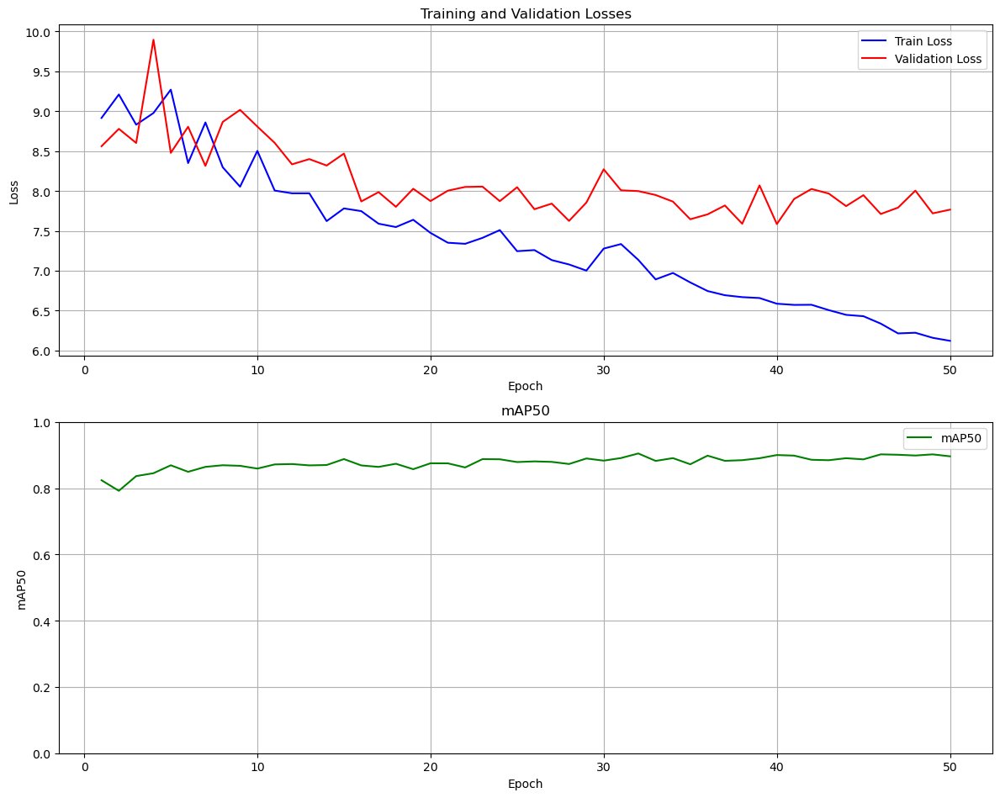

In [31]:
### Plots
results_path = os.path.join(cwd, "yolo_football_analysis", "yoloSR_dataset_baseline", "results.csv")
data = pd.read_csv(results_path)
plot_metrics(data)

### Quantitative test

In [14]:
# Test the model on the test set
mp.freeze_support()  # Necessario su Windows
cwd = os.getcwd()
gan_weights = os.path.join(cwd, "..", "models", "esrgan", "experiments", "finetune_Realesr-general-x4v3", "models", "net_g_latest.pth")
sr_yolo_weights = os.path.join(cwd, "yolo_football_analysis", "yoloSR_dataset_baseline", "weights", "best.pt")
model = SRYOLO(
        yolo_weights=sr_yolo_weights,
        upscale=4,
        gan_weights=gan_weights,
        dni_weight=0.5,
        tile=0,
        tile_pad=10
    )
model = model.cuda()

model.val(data=os.path.join(dataset_path, "data.yaml"), split="test", project="yolo_football_test", name="yoloSR_dataset_baseline")

Device for Super-Resolution: cuda
Load model from c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\models\esrgan\experiments\finetune_Realesr-general-x4v3\models\net_g_latest.pth
Super-Resolution model loaded successfully. 👍

--- Starting Validation with SR on split: 'test' ---
Found cache for 'test'. Using it for validation.

Validation started using cached dataset specified in: c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cached_test_data.yaml
YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


val: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_test\labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_test\labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:45<00:00, 11.40s/it]


                   all         60       1452      0.911       0.87      0.904      0.642
                  ball         52         53      0.798      0.595       0.69      0.321
            goalkeeper         40         41      0.937      0.927      0.958      0.717
                player         60       1202       0.97      0.989      0.991      0.801
               referee         60        156       0.94      0.968       0.98      0.728
Speed: 4.5ms preprocess, 644.9ms inference, 0.0ms loss, 3.3ms postprocess per image
Results saved to yolo_football_test\yoloSR_dataset_baseline


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000023090AB8520>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

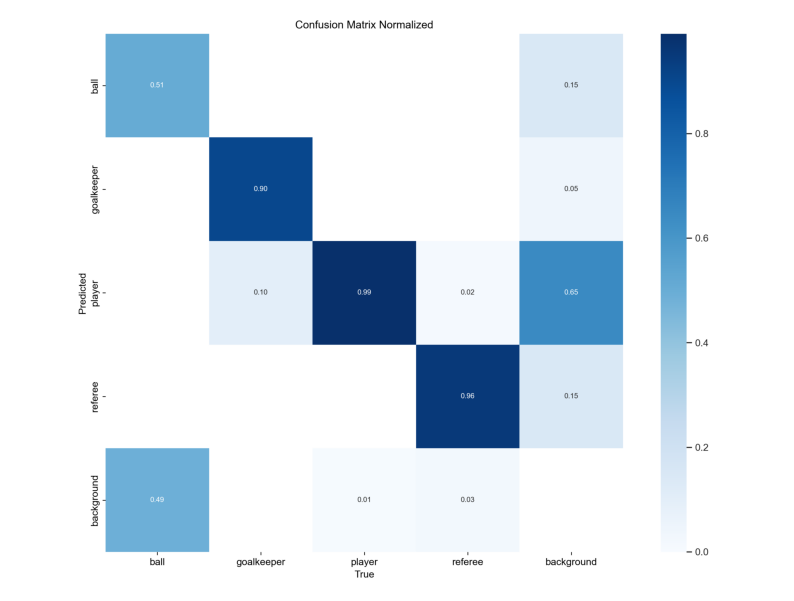

In [15]:
matrix_path = os.path.join(cwd, "yolo_football_test", "yoloSR_dataset_baseline", "confusion_matrix_normalized.png")
plot_confusion_matrix(matrix_path)


### Qualitative Analysis on Challenging Samples

The qualitative analysis is based on three distinct samples:  
1. The first shows a stretched ball.  
2. The second features the ball under dim lighting conditions.  
3. The third depicts the ball partially occluded by a player.  

The purpose of this qualitative test is to assess the model’s performance under difficult conditions.

Device for Super-Resolution: cuda
Load model from c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\models\esrgan\experiments\finetune_Realesr-general-x4v3\models\net_g_latest.pth
Super-Resolution model loaded successfully. 👍
SR enabled for prediction. Applying on-the-fly...

image 1/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\538438_1_10_png_jpg.rf.f0585e46a9ae3f1d0f64c24aaf7704b8.jpg: 736x1280 1 ball, 21 players, 1 referee, 2050.9ms
image 2/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\Screenshot-2025-01-03-112748_png.rf.763a7d889601c8b79d673b84cdc4ae64.jpg: 736x1280 1 ball, 1 goalkeeper, 20 players, 2 referees, 1975.0ms
image 3/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualita

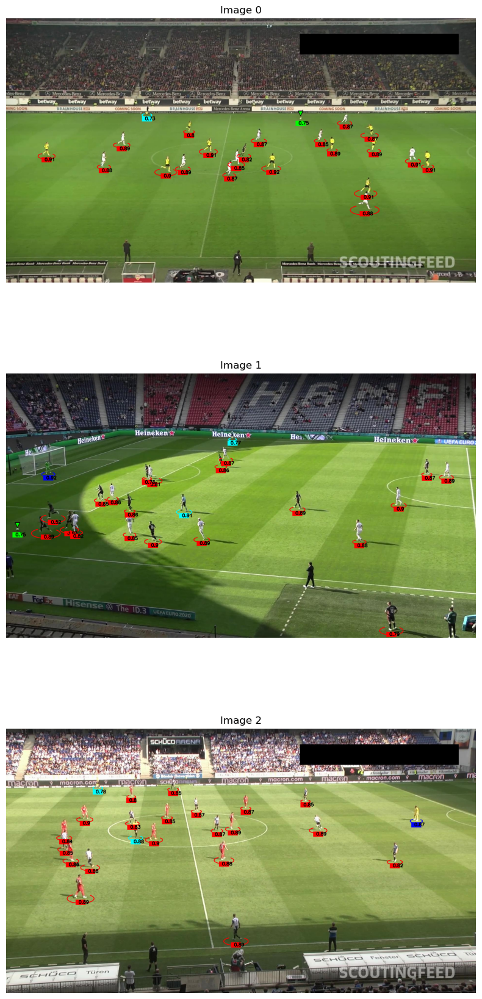

In [16]:
detect_images(images_to_test_path, r"yolo_football_analysis\yoloSR_dataset_baseline\weights\best.pt", is_sr=True, gan_weights=gan_weights)

Result: 
1. Detected with 0.75 confidence
2. Detected with 0.75 confidence
3. Undetected

## SR Yolo - FineTuned

Since the pretrained RealESRGAN models are trained on general-purpose datasets, we decided to fine-tune them specifically for our football detection task.  
However, all the images in our dataset are inherently low-quality, which makes traditional supervised fine-tuning (LR → HR) difficult.

To address this, we explored an alternative approach: **using high-resolution screenshots from the FIFA videogame**, which offers synthetic but clean and semantically accurate football scenes.

By fine-tuning RealESRGAN on these game-based images, we observed that the output becomes slightly more stylized — with a **cartoon-like appearance** — but significantly **sharper edges** and **more defined ball contours**, which can be beneficial for YOLO detection.

Details about the fine-tuning process, including dataset preparation, training steps, and model weights, are available at:

```
code\models\esrgan\README.md
```

**Example of Super Resolution Application with FuneTuning**
Original image:
![Image 1](../../dataset\yolov9\copy-paste-augmented\train\images\Screenshot-2025-01-03-113511_png.rf.f0116a752552cc0e8ca1d38b87f170fd.jpg)

Enhanced (No finetuning)
![Image 2](../../code\models\esrgan\test_output\base.jpg)

Enhanced (FineTuned)
![Image 3](../../code\models\esrgan\test_output\finetuned.jpg)

In [ ]:
mp.freeze_support()  # Necessario su Windows
cwd = os.getcwd()
gan_weights = os.path.join(cwd, "..", "models", "esrgan", "experiments", "finetune_Realesr-general-x4v3", "models", "net_g_latest.pth")
model = SRYOLO(
        yolo_weights="yolov9c.pt",
        upscale=4,
        gan_weights=gan_weights,
        dni_weight=0.5,
        tile=0,
        tile_pad=10
    )
model = model.cuda()

Device for Super-Resolution: cuda
Load model from c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\models\esrgan\pretrained\realesr-general-x4v3.pth
Super-Resolution model loaded successfully. 👍


In [2]:
dataset_path = os.path.join(dataset_root_folder, "yolov9", "baseline")

In [ ]:
model.train(data=os.path.join(dataset_path, "data.yaml"), epochs=50, imgsz=1280, save=True, project="yolo_football_analysis", 
            name="yoloSR_FineTuned_dataset_baseline", batch=4)
wandb.finish()


--- Checking cache for split 'valid' ---
Looking for original images in: c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\valid\images
Found 75 original image files.
Cache for 'valid' found and complete.

--- Checking cache for split 'train' ---
Looking for original images in: c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\train\images
Found 510 original image files.
Cache for 'train' found and complete.

Training started using cached dataset specified in: c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cached_data.yaml

SR model released from memory. Starting YOLO training.
New https://pypi.org/project/ultralytics/8.3.161 available  Update with 'pip install -U ultralytics'
engine\trainer: task=detect, mode=train, model=yolov9c.pt, data=c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolo

wandb: Currently logged in as: sianiemanuele (sianiemanuele_07) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed 


train: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_train\labels.cache... 510 images, 0 backgrounds, 0 corrupt: 100%|██████████| 510/510 [00:00<?, ?it/s]Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_train\labels.cache... 510 images, 0 backgrounds, 0 corrupt: 100%|██████████| 510/510 [00:00<?, ?it/s]
val: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]


Plotting labels to yolo_football_analysis\yoloSR_dataset_baseline\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 1280 train, 1280 val
Using 8 dataloader workers
Logging results to yolo_football_analysis\yoloSR_dataset_baseline
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      11.3G      1.003      1.063     0.8731         47       1280: 100%|██████████| 128/128 [34:52<00:00, 16.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.23s/it]


                   all         75       1796      0.763      0.711      0.765      0.456

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      11.1G      1.002     0.6411     0.8717         76       1280: 100%|██████████| 128/128 [27:50<00:00, 13.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.54s/it]


                   all         75       1796      0.852      0.779      0.828      0.495

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      11.2G      1.033     0.6233     0.8787         43       1280: 100%|██████████| 128/128 [27:31<00:00, 12.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.43s/it]


                   all         75       1796      0.737      0.803      0.832      0.485

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      11.3G     0.9748     0.5642     0.8634         88       1280: 100%|██████████| 128/128 [24:04<00:00, 11.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:59<00:00,  5.96s/it]


                   all         75       1796      0.923      0.798      0.852      0.478

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      11.3G     0.9696     0.5295     0.8664         87       1280: 100%|██████████| 128/128 [29:16<00:00, 13.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.51s/it]


                   all         75       1796      0.834      0.783      0.825      0.505

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      11.3G     0.9406     0.5132     0.8622         98       1280: 100%|██████████| 128/128 [30:43<00:00, 14.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.40s/it]


                   all         75       1796      0.822      0.827      0.852       0.54

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      11.1G     0.9568     0.5046     0.8628         51       1280: 100%|██████████| 128/128 [30:11<00:00, 14.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.12s/it]


                   all         75       1796      0.826      0.831      0.852      0.501

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      11.3G          1     0.5154     0.8634        103       1280: 100%|██████████| 128/128 [24:35<00:00, 11.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.56s/it]


                   all         75       1796      0.831      0.829      0.872      0.538

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      11.3G     0.9164     0.4628     0.8557         65       1280: 100%|██████████| 128/128 [29:32<00:00, 13.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.54s/it]


                   all         75       1796      0.917      0.749      0.835      0.505

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      11.3G     0.9041     0.4624     0.8445         96       1280: 100%|██████████| 128/128 [25:08<00:00, 11.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.02s/it]


                   all         75       1796      0.849      0.833      0.873      0.548

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      11.2G     0.9195     0.4641     0.8507         69       1280: 100%|██████████| 128/128 [30:08<00:00, 14.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.31s/it]


                   all         75       1796      0.859      0.801      0.849      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      11.2G     0.8876     0.4481     0.8435        114       1280: 100%|██████████| 128/128 [33:48<00:00, 15.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:29<00:00,  8.96s/it]


                   all         75       1796      0.869      0.834      0.869      0.542

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      11.2G     0.8913     0.4406     0.8432         91       1280: 100%|██████████| 128/128 [41:02<00:00, 19.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:17<00:00,  7.76s/it]


                   all         75       1796      0.903      0.856      0.886      0.581

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      11.2G     0.8815     0.4256     0.8464         97       1280: 100%|██████████| 128/128 [47:09<00:00, 22.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:33<00:00,  9.33s/it]


                   all         75       1796      0.888      0.842      0.879      0.573

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      11.3G     0.8915     0.4332      0.845         34       1280: 100%|██████████| 128/128 [46:32<00:00, 21.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:49<00:00, 10.93s/it]


                   all         75       1796      0.927      0.855      0.887      0.579

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      11.3G     0.8965     0.4508     0.8472        107       1280: 100%|██████████| 128/128 [54:59<00:00, 25.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:57<00:00, 11.71s/it]


                   all         75       1796      0.842      0.839      0.867       0.56

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      11.3G     0.8375     0.4312     0.8364        116       1280: 100%|██████████| 128/128 [59:01<00:00, 27.67s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:22<00:00,  8.22s/it]


                   all         75       1796      0.881      0.852       0.88      0.581

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      11.3G     0.8385     0.4092     0.8411        129       1280: 100%|██████████| 128/128 [29:29<00:00, 13.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.39s/it]


                   all         75       1796      0.862      0.857      0.879      0.574

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      11.1G     0.8579     0.4142     0.8444         34       1280: 100%|██████████| 128/128 [27:52<00:00, 13.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:01<00:00,  6.19s/it]


                   all         75       1796      0.902      0.838       0.88      0.574

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      11.2G     0.8586     0.4113     0.8376         44       1280: 100%|██████████| 128/128 [28:05<00:00, 13.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.64s/it]


                   all         75       1796      0.914      0.862      0.894      0.589

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      11.2G     0.8225     0.4044     0.8327         83       1280: 100%|██████████| 128/128 [25:52<00:00, 12.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.83s/it]


                   all         75       1796      0.883      0.831      0.885       0.55

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      11.2G     0.8439     0.4059     0.8361         98       1280: 100%|██████████| 128/128 [29:51<00:00, 14.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.62s/it]


                   all         75       1796      0.875      0.853       0.88      0.573

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      11.2G     0.8327     0.4002      0.836         30       1280: 100%|██████████| 128/128 [26:36<00:00, 12.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:39<00:00,  3.93s/it]


                   all         75       1796      0.832      0.838      0.856      0.569

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      11.3G     0.8413     0.3961     0.8337         60       1280: 100%|██████████| 128/128 [27:10<00:00, 12.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.16s/it]


                   all         75       1796      0.923      0.838      0.878      0.587

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      11.1G     0.8092     0.3909     0.8308         87       1280: 100%|██████████| 128/128 [25:56<00:00, 12.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.34s/it]


                   all         75       1796      0.859      0.862      0.885      0.589

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      11.1G     0.8103     0.3806     0.8343         57       1280: 100%|██████████| 128/128 [30:00<00:00, 14.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:57<00:00,  5.71s/it]


                   all         75       1796      0.929      0.843      0.884      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      11.1G     0.7849     0.3701      0.829         68       1280: 100%|██████████| 128/128 [26:59<00:00, 12.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.39s/it]


                   all         75       1796      0.886      0.835      0.876      0.566

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      11.2G     0.7938     0.3766     0.8323         71       1280: 100%|██████████| 128/128 [27:21<00:00, 12.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.40s/it]


                   all         75       1796      0.906      0.864      0.897      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      11.2G     0.7858     0.3806     0.8295         75       1280: 100%|██████████| 128/128 [24:47<00:00, 11.62s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:39<00:00,  3.98s/it]


                   all         75       1796      0.934       0.84      0.876      0.585

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      11.1G     0.7894     0.3789     0.8282         59       1280: 100%|██████████| 128/128 [29:21<00:00, 13.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.76s/it]


                   all         75       1796      0.871      0.874      0.899      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      11.3G     0.7893     0.3772     0.8268         72       1280: 100%|██████████| 128/128 [25:54<00:00, 12.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.24s/it]


                   all         75       1796      0.871      0.869       0.89       0.59

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      11.3G      0.785     0.3666     0.8284         55       1280: 100%|██████████| 128/128 [27:46<00:00, 13.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.64s/it]


                   all         75       1796      0.893       0.85      0.894      0.599

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      11.2G     0.7568       0.35     0.8232         60       1280: 100%|██████████| 128/128 [24:11<00:00, 11.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.13s/it]


                   all         75       1796      0.878      0.861      0.881      0.599

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      11.3G     0.7792     0.3618     0.8265         53       1280: 100%|██████████| 128/128 [25:10<00:00, 11.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.01s/it]


                   all         75       1796      0.898      0.861      0.893      0.604

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      11.2G     0.7642     0.3543     0.8241        101       1280: 100%|██████████| 128/128 [23:46<00:00, 11.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.69s/it]


                   all         75       1796      0.926      0.865      0.896      0.607

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      11.2G     0.7634     0.3535     0.8221         55       1280: 100%|██████████| 128/128 [28:38<00:00, 13.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.97s/it]


                   all         75       1796      0.891      0.875      0.892      0.586

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      11.3G     0.7621     0.3523     0.8241        143       1280: 100%|██████████| 128/128 [24:36<00:00, 11.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.67s/it]


                   all         75       1796      0.898      0.867      0.895       0.59

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      11.2G     0.7358     0.3398     0.8179         42       1280: 100%|██████████| 128/128 [25:33<00:00, 11.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:40<00:00,  4.09s/it]


                   all         75       1796       0.91      0.864      0.884      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      11.3G     0.7301     0.3371     0.8182         87       1280: 100%|██████████| 128/128 [24:55<00:00, 11.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.20s/it]


                   all         75       1796      0.897      0.867      0.889      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      11.3G     0.7144     0.3277     0.8156        178       1280: 100%|██████████| 128/128 [23:58<00:00, 11.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.94s/it]


                   all         75       1796      0.894      0.893        0.9      0.602
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      11.1G     0.7155     0.3295     0.8215         48       1280: 100%|██████████| 128/128 [25:03<00:00, 11.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.70s/it]


                   all         75       1796      0.896      0.872      0.886      0.591

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      11.1G     0.7085     0.3227     0.8219         46       1280: 100%|██████████| 128/128 [22:17<00:00, 10.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.24s/it]


                   all         75       1796      0.895      0.839      0.878      0.586

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.16G     0.7119     0.3275     0.8178         49       1280: 100%|██████████| 128/128 [27:30<00:00, 12.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:05<00:00,  1.84it/s]


                   all         75       1796      0.898      0.857      0.904       0.61

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      11.1G     0.7098     0.3234      0.818         46       1280: 100%|██████████| 128/128 [23:50<00:00, 11.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:34<00:00,  3.44s/it]


                   all         75       1796      0.867      0.882      0.889      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      11.1G     0.7055     0.3157     0.8236         44       1280: 100%|██████████| 128/128 [25:45<00:00, 12.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.41s/it]


                   all         75       1796      0.884      0.889      0.901      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.13G     0.6908     0.3135     0.8181         48       1280: 100%|██████████| 128/128 [25:52<00:00, 12.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:18<00:00,  1.80s/it]


                   all         75       1796      0.898      0.894      0.901      0.614

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.15G     0.6789     0.3056     0.8151         46       1280: 100%|██████████| 128/128 [25:44<00:00, 12.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:15<00:00,  1.54s/it]


                   all         75       1796      0.888      0.892      0.903      0.616

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      11.1G     0.6724     0.3037     0.8135         48       1280: 100%|██████████| 128/128 [26:05<00:00, 12.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.11s/it]


                   all         75       1796      0.873      0.901      0.902      0.609

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      11.1G     0.6685     0.2991     0.8143         49       1280: 100%|██████████| 128/128 [29:25<00:00, 13.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.82s/it]


                   all         75       1796      0.896      0.889      0.903      0.613

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      11.1G     0.6572     0.2929     0.8134         47       1280: 100%|██████████| 128/128 [27:22<00:00, 12.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.90s/it]


                   all         75       1796      0.908      0.894      0.907      0.614

50 epochs completed in 25.257 hours.
Optimizer stripped from yolo_football_analysis\yoloSR_dataset_baseline\weights\last.pt, 51.7MB
Optimizer stripped from yolo_football_analysis\yoloSR_dataset_baseline\weights\best.pt, 51.7MB

Validating yolo_football_analysis\yoloSR_dataset_baseline\weights\best.pt...
Ultralytics 8.3.28  Python-3.10.0 torch-2.5.0 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:21<00:00,  2.14s/it]


                   all         75       1796      0.888      0.892      0.903      0.616
                  ball         73         73      0.791      0.616      0.688      0.305
            goalkeeper         50         50      0.815       0.96      0.941      0.657
                player         75       1493      0.976      0.992      0.995      0.788
               referee         75        180      0.968          1       0.99      0.714
Speed: 1.9ms preprocess, 272.8ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to yolo_football_analysis\yoloSR_dataset_baseline


wandb: Network error (ConnectionError), entering retry loop.
wandb: Network error (ConnectionError), entering retry loop.
wandb: Network error (ConnectionError), entering retry loop.
wandb: Network error (ConnectionError), entering retry loop.
wandb: Network error (ConnectionError), entering retry loop.


lr/pg0,▃▆███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁
lr/pg1,▆████▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
lr/pg2,▃▆███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
metrics/mAP50(B),▁▄▄▅▄▅▆▅▆▅▇▇▇▆▇▇▇▇▇▆▇▇█▇█▇▇█▇█▇█▇▇██████
metrics/mAP50-95(B),▁▂▂▃▅▅▃▅▄▅▆▆▆▆▆▅▆▆▇▇▆▇▇▇▇▇▇█▇▇▇▇▇▇█▇████
metrics/precision(B),▂▅▁█▄▄▄▇▅▅▇▆█▅▆▇▆▆▄█▆▇█▆▆▆▇█▆▇▇▇▇▇▇▆▇▆▆▆
metrics/recall(B),▁▃▄▄▄▅▅▂▅▄▆▆▆▆▆▆▇▅▆▆▆▆▇▆▇▆▇▇▇▇▇█▇▆▆█████
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,██▇▇▇█▆▆▆▆▆▆▆▅▅▅▄▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁


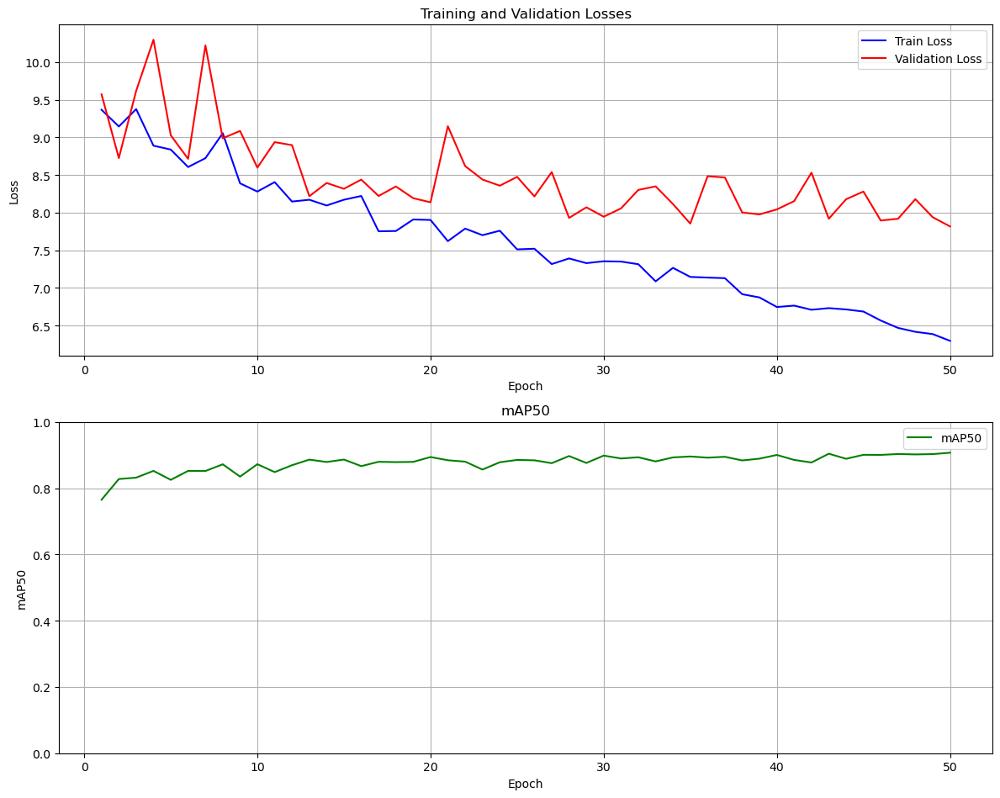

In [48]:
### Plots
results_path = os.path.join(cwd, "yolo_football_analysis", "yoloSR_FineTuned_dataset_baseline", "results.csv")
data = pd.read_csv(results_path)
plot_metrics(data)

### Quantitative Test

In [ ]:
# Test the model on the test set
mp.freeze_support()  # Necessario su Windows
cwd = os.getcwd()
gan_weights = os.path.join(cwd, "..", "models", "esrgan", "experiments", "finetune_Realesr-general-x4v3", "models", "net_g_latest.pth")
sr_yolo_weights = os.path.join(cwd, "yolo_football_analysis", "yoloSR_FineTuned_dataset_baseline", "weights", "best.pt")
model = SRYOLO(
        yolo_weights=sr_yolo_weights,
        upscale=4,
        gan_weights=gan_weights,
        dni_weight=0.5,
        tile=0,
        tile_pad=10
    )
model = model.cuda()


Device for Super-Resolution: cuda
Load model from c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\models\esrgan\experiments\finetune_Realesr-general-x4v3\models\net_g_latest.pth
Super-Resolution model loaded successfully. 👍


c:\Users\siani\.conda\envs\torch_gpu_clone\lib\site-packages\torch\_utils.py:88: UserWarning: expandable_segments not supported on this platform (Triggered internally at C:\cb\pytorch_1000000000000\work\c10/cuda/CUDAAllocatorConfig.h:28.)
  untyped_storage = torch.UntypedStorage(self.size(), device=device)


In [4]:
model.val(data=os.path.join(dataset_path, "data.yaml"), split="test", project="yolo_football_test", name="yoloSR_dataset_baseline")


--- Starting Validation with SR on split: 'test' ---
Found cache for 'test'. Using it for validation.

Validation started using cached dataset specified in: c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cached_test_data.yaml
YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


val: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_test\labels... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<00:00, 130.96it/s]

val: New cache created: C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\cache_test\labels.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.44s/it]


                   all         60       1452      0.948      0.887      0.917      0.662
                  ball         52         53      0.904      0.623      0.715      0.309
            goalkeeper         40         41      0.957      0.951      0.983      0.782
                player         60       1202      0.974      0.994      0.994      0.826
               referee         60        156      0.958      0.981      0.979      0.731
Speed: 4.6ms preprocess, 60.7ms inference, 0.0ms loss, 4.5ms postprocess per image
Results saved to yolo_football_test\yoloSR_dataset_baseline4


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000022E3D670520>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

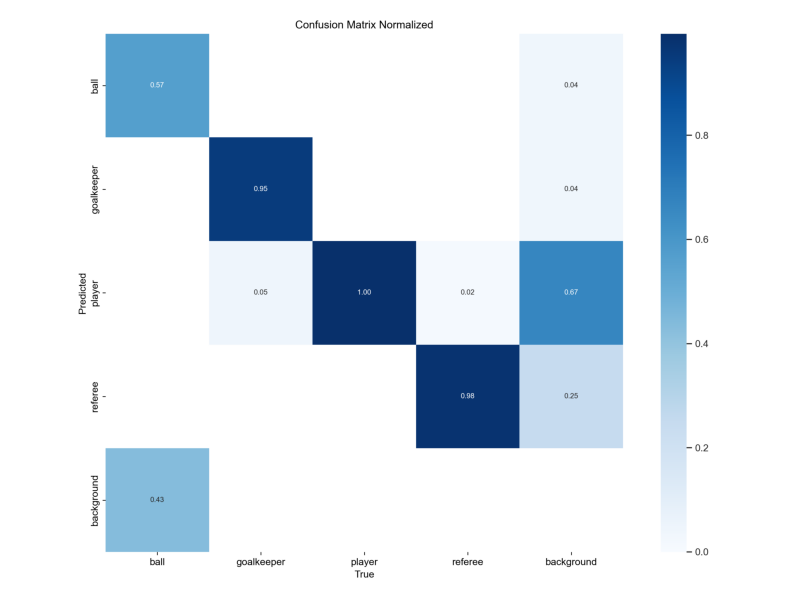

In [2]:
# load and show confusion matrix
matrix_path = os.path.join(cwd, "yolo_football_test", "yoloSR_FineTuned_dataset_baseline", "confusion_matrix_normalized.png")
plot_confusion_matrix(matrix_path)


### Qualitative Analysis on Challenging Samples

The qualitative analysis is based on three distinct samples:  
1. The first shows a stretched ball.  
2. The second features the ball under dim lighting conditions.  
3. The third depicts the ball partially occluded by a player.  

The purpose of this qualitative test is to assess the model’s performance under difficult conditions.

Device for Super-Resolution: cuda
Load model from c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\models\esrgan\experiments\finetune_Realesr-general-x4v3\models\net_g_latest.pth
Super-Resolution model loaded successfully. 👍
SR enabled for prediction. Applying on-the-fly...

image 1/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\538438_1_10_png_jpg.rf.f0585e46a9ae3f1d0f64c24aaf7704b8.jpg: 736x1280 1 ball, 21 players, 2 referees, 70.4ms
image 2/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\Screenshot-2025-01-03-112748_png.rf.763a7d889601c8b79d673b84cdc4ae64.jpg: 736x1280 1 goalkeeper, 19 players, 1 referee, 68.5ms
image 3/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysi

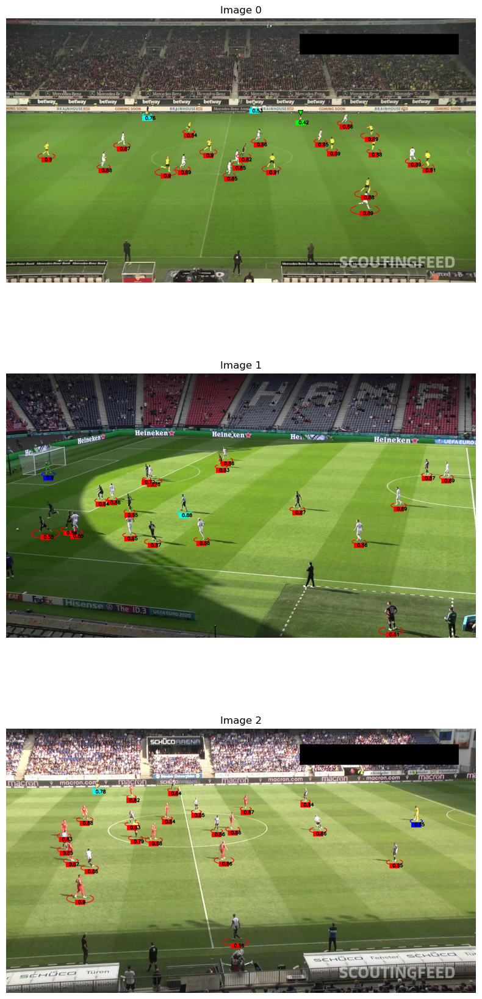

In [51]:
detect_images(images_to_test_path, r"yolo_football_analysis\yoloSR_FineTuned_dataset_baseline\weights\best.pt", is_sr=True, gan_weights=gan_weights)

Result: 
1. Detected with 0.42 confidence
2. Undetected
3. Undetected

# Custom Focal loss

We propose an alternative type of classification loss to improve the detection of small and underrepresented objects in the dataset.

The idea is to replace the default classification loss used by Ultralytics, Binary Cross Entropy (BCE), with a more effective loss function tailored to our detection task, **Focal Loss**.

Focal Loss is built upon BCE, but while BCE gives equal importance to all objects, Focal Loss focuses more on the detection of harder examples.
As a result, it enhances the model’s learning process for underrepresented and small-scale objects, leading to a more effective and balanced training outcome.

The exact implementation of our Custom Focal Loss can be found here:

```
code\custom_loss\custom_focal_loss.py
```


**Important Note:**  
To replace Ultralytics' default classification loss with our Custom Focal Loss, it was necessary to modify the **loss.py** file within the library to allow importing and configuring the new loss function.
It is possible to switch between the default loss and the custom one using the **CUSTOM_FOCAL_LOSS** variable defined in the .env file.

## Copy-paste Augmentation

### Custom Focal loss

This section contains the code for training and evaluation on the model with custom focal loss with augmented dataset.

In [ ]:
mp.freeze_support()  # Necessario su Windows
model = YOLO("yolov9c.pt")
model = model.cuda()
dataset_path = os.path.join(dataset_root_folder, "yolov9", "copy-paste-augmented")

In [ ]:
model.train(data=os.path.join(dataset_path, "data.yaml"), epochs=50, imgsz=1280, save=True, project="yolo_football_analysis", 
            name="yolo9c_dataset_CpAug_custom_loss", batch=4)
wandb.finish()

New https://pypi.org/project/ultralytics/8.3.156 available  Update with 'pip install -U ultralytics'
engine\trainer: task=detect, mode=train, model=yolov9c.pt, data=c:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\code\training\..\..\dataset\v3\data.yaml, epochs=50, time=None, patience=100, batch=4, imgsz=1280, save=True, save_period=-1, cache=False, device=cuda:0, workers=8, project=yolo_football_analysis, name=yolo9c_dataset_v3_custom_loss, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, cla

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: sianiemanuele (sianiemanuele_07) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed 


train: Scanning C:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\dataset\v3\train\labels.cache... 1530 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1530/1530 [00:00<?, ?it/s]
val: Scanning C:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\dataset\v3\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]


Plotting labels to yolo_football_analysis\yolo9c_dataset_v3_custom_loss\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 1280 train, 1280 val
Using 8 dataloader workers
Logging results to yolo_football_analysis\yolo9c_dataset_v3_custom_loss
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/383 [00:00<?, ?it/s]

[INFO] Using Custom Focal Loss...............


       1/50      11.4G     0.8965    0.08755     0.8467        133       1280: 100%|██████████| 383/383 [1:49:05<00:00, 17.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/10 [00:00<?, ?it/s]

[INFO] Using Custom Focal Loss...............


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.38s/it]

                   all         75       1796      0.798      0.652       0.72      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      11.2G     0.8845    0.04613     0.8427        115       1280: 100%|██████████| 383/383 [1:23:02<00:00, 13.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:59<00:00,  5.92s/it]

                   all         75       1796      0.866      0.701      0.799      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      11.1G     0.9248    0.05605     0.8457         64       1280: 100%|██████████| 383/383 [1:24:25<00:00, 13.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.63s/it]

                   all         75       1796      0.767       0.74      0.807      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      11.2G     0.8715     0.0448      0.842         92       1280: 100%|██████████| 383/383 [1:22:30<00:00, 12.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:05<00:00,  6.60s/it]

                   all         75       1796      0.884      0.765      0.816      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      11.3G     0.8911    0.04485     0.8413        122       1280: 100%|██████████| 383/383 [1:26:44<00:00, 13.59s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.41s/it]

                   all         75       1796      0.849      0.805      0.843      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      11.3G      0.826    0.03774     0.8343        116       1280: 100%|██████████| 383/383 [1:20:16<00:00, 12.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.21s/it]

                   all         75       1796      0.864      0.806      0.848       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      11.1G     0.8182    0.03505     0.8309         88       1280: 100%|██████████| 383/383 [1:16:34<00:00, 12.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:56<00:00,  5.61s/it]

                   all         75       1796      0.895      0.773      0.822       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      11.1G     0.8294    0.03686     0.8321        117       1280: 100%|██████████| 383/383 [1:26:21<00:00, 13.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:39<00:00,  4.00s/it]

                   all         75       1796       0.84      0.824      0.849      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      11.1G     0.8015    0.03627     0.8284         77       1280: 100%|██████████| 383/383 [1:15:26<00:00, 11.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.15s/it]

                   all         75       1796      0.914      0.784      0.834      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      11.3G     0.8021    0.03557     0.8283        105       1280: 100%|██████████| 383/383 [1:19:10<00:00, 12.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.62s/it]

                   all         75       1796      0.852      0.826       0.85      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      11.2G     0.8004     0.0348     0.8277         81       1280: 100%|██████████| 383/383 [1:19:21<00:00, 12.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.92s/it]

                   all         75       1796      0.901      0.803      0.846      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      11.1G     0.7786    0.03241     0.8246        174       1280: 100%|██████████| 383/383 [1:23:54<00:00, 13.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.22s/it]

                   all         75       1796      0.889      0.827      0.869      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      11.1G      0.774    0.03205     0.8227        110       1280: 100%|██████████| 383/383 [1:18:31<00:00, 12.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.08s/it]

                   all         75       1796      0.877      0.824      0.863      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      11.2G     0.7659    0.03086     0.8214         91       1280: 100%|██████████| 383/383 [1:20:08<00:00, 12.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.84s/it]

                   all         75       1796      0.899      0.829      0.886      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      11.2G     0.7468    0.02902     0.8195         57       1280: 100%|██████████| 383/383 [1:13:27<00:00, 11.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.98s/it]

                   all         75       1796      0.933       0.83       0.89      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      11.2G     0.7327    0.02885     0.8163         45       1280: 100%|██████████| 383/383 [1:17:29<00:00, 12.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.00s/it]

                   all         75       1796      0.886       0.83      0.871      0.588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      11.2G     0.7343    0.02725     0.8174         92       1280: 100%|██████████| 383/383 [1:15:10<00:00, 11.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.40s/it]

                   all         75       1796      0.914      0.825       0.86      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      11.2G     0.7169    0.02618     0.8158         44       1280: 100%|██████████| 383/383 [1:24:55<00:00, 13.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:01<00:00,  6.10s/it]

                   all         75       1796      0.914      0.868      0.898      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      11.3G     0.7225    0.02671     0.8157        153       1280: 100%|██████████| 383/383 [1:14:51<00:00, 11.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:02<00:00,  6.27s/it]

                   all         75       1796      0.883      0.833      0.877      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      11.2G     0.7193    0.02571     0.8139         44       1280: 100%|██████████| 383/383 [1:19:17<00:00, 12.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:00<00:00,  6.05s/it]

                   all         75       1796      0.893      0.828       0.87      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      11.2G     0.7018    0.02441     0.8135        142       1280: 100%|██████████| 383/383 [1:18:11<00:00, 12.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.44s/it]

                   all         75       1796      0.862      0.795      0.845      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      11.2G     0.7117    0.02627     0.8143         61       1280: 100%|██████████| 383/383 [1:21:17<00:00, 12.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.69s/it]

                   all         75       1796      0.905      0.797      0.857      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      11.2G     0.7089     0.0252     0.8128         51       1280: 100%|██████████| 383/383 [1:19:36<00:00, 12.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.21s/it]

                   all         75       1796      0.873      0.854      0.877      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      11.2G     0.6974    0.02445     0.8128        161       1280: 100%|██████████| 383/383 [1:23:51<00:00, 13.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.48s/it]

                   all         75       1796        0.9      0.823      0.879      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      11.3G     0.7053     0.0241     0.8111         90       1280: 100%|██████████| 383/383 [1:12:51<00:00, 11.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.19s/it]

                   all         75       1796      0.908      0.838      0.878      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      11.2G     0.6736    0.02206     0.8081         51       1280: 100%|██████████| 383/383 [1:12:58<00:00, 11.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.64s/it]

                   all         75       1796      0.902      0.848      0.882      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      11.2G     0.6758    0.02277     0.8068        107       1280: 100%|██████████| 383/383 [1:18:58<00:00, 12.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.14s/it]

                   all         75       1796      0.906      0.839      0.877      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      11.2G     0.6561    0.02162     0.8063         97       1280: 100%|██████████| 383/383 [1:18:34<00:00, 12.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.40s/it]

                   all         75       1796      0.911       0.83      0.884      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      11.3G     0.6692    0.02208     0.8068         67       1280: 100%|██████████| 383/383 [1:14:37<00:00, 11.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.21s/it]

                   all         75       1796      0.879      0.843      0.883      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      11.3G     0.6541    0.02074     0.8047        108       1280: 100%|██████████| 383/383 [1:12:12<00:00, 11.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.60s/it]

                   all         75       1796      0.883      0.851      0.886      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      11.2G     0.6476    0.01954     0.8035        104       1280: 100%|██████████| 383/383 [1:22:24<00:00, 12.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:00<00:00,  6.00s/it]

                   all         75       1796      0.927      0.831      0.883      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      11.1G     0.6326    0.01907     0.8015         41       1280: 100%|██████████| 383/383 [1:23:41<00:00, 13.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.82s/it]

                   all         75       1796      0.909      0.857      0.878      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      11.2G     0.6245    0.01883     0.8009         75       1280: 100%|██████████| 383/383 [1:21:57<00:00, 12.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.07s/it]

                   all         75       1796      0.906      0.864      0.895      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      11.2G     0.6177    0.01787     0.7995         91       1280: 100%|██████████| 383/383 [1:20:15<00:00, 12.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.01s/it]

                   all         75       1796      0.879       0.88      0.895      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      11.2G     0.6109    0.01749     0.7989        151       1280: 100%|██████████| 383/383 [1:20:33<00:00, 12.62s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.23s/it]

                   all         75       1796      0.887      0.863      0.881      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      11.3G     0.6017    0.01743      0.797         72       1280: 100%|██████████| 383/383 [1:16:06<00:00, 11.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.47s/it]

                   all         75       1796      0.893       0.85       0.89      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      11.1G     0.5908    0.01655     0.7976         60       1280: 100%|██████████| 383/383 [1:37:56<00:00, 15.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.95s/it]

                   all         75       1796      0.905      0.871      0.894      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      11.2G     0.5874    0.01635     0.7945         85       1280: 100%|██████████| 383/383 [1:28:25<00:00, 13.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.36s/it]

                   all         75       1796      0.936      0.856      0.887       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      11.1G     0.5765     0.0153     0.7939        150       1280: 100%|██████████| 383/383 [1:19:48<00:00, 12.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.39s/it]

                   all         75       1796       0.92      0.847      0.891      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      11.2G     0.5673    0.01526     0.7928         62       1280: 100%|██████████| 383/383 [1:17:10<00:00, 12.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.50s/it]

                   all         75       1796      0.899      0.856      0.885      0.604


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      10.8G     0.5593    0.01407     0.7957         47       1280: 100%|██████████| 383/383 [1:28:46<00:00, 13.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:56<00:00,  5.60s/it]

                   all         75       1796      0.912      0.826      0.874      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      10.8G      0.551    0.01386     0.7934         51       1280: 100%|██████████| 383/383 [1:27:50<00:00, 13.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.63s/it]

                   all         75       1796      0.896      0.843      0.883      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      10.8G     0.5346    0.01306     0.7938         54       1280: 100%|██████████| 383/383 [1:32:30<00:00, 14.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.82s/it]

                   all         75       1796      0.905      0.842      0.877      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      10.8G     0.5271    0.01244     0.7909         55       1280: 100%|██████████| 383/383 [1:27:54<00:00, 13.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.70s/it]

                   all         75       1796      0.901      0.851      0.885      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      10.8G     0.5204    0.01232     0.7896         45       1280: 100%|██████████| 383/383 [1:34:02<00:00, 14.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.55s/it]

                   all         75       1796      0.947      0.852       0.89       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      10.8G     0.5084    0.01198     0.7881         49       1280: 100%|██████████| 383/383 [1:26:52<00:00, 13.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.18s/it]

                   all         75       1796      0.915      0.853      0.888      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      10.8G     0.4971    0.01145     0.7884         47       1280: 100%|██████████| 383/383 [1:27:51<00:00, 13.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.54s/it]

                   all         75       1796      0.941      0.855      0.897      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      10.8G     0.4842    0.01077     0.7856         46       1280: 100%|██████████| 383/383 [1:30:48<00:00, 14.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.53s/it]

                   all         75       1796      0.926      0.849       0.89      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      10.8G     0.4753    0.01032      0.785         48       1280: 100%|██████████| 383/383 [1:36:38<00:00, 15.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.09s/it]

                   all         75       1796      0.914      0.871      0.897      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.02G     0.4724    0.01032     0.7851         45       1280: 100%|██████████| 383/383 [1:18:02<00:00, 12.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:36<00:00,  3.62s/it]

                   all         75       1796      0.934      0.842      0.888       0.61



50 epochs completed in 69.500 hours.
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_v3_custom_loss\weights\last.pt, 51.7MB
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_v3_custom_loss\weights\best.pt, 51.7MB

Validating yolo_football_analysis\yolo9c_dataset_v3_custom_loss\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:07<00:00,  1.28it/s]


                   all         75       1796      0.906      0.864      0.895      0.625
                  ball         73         73      0.832      0.507      0.647       0.32
            goalkeeper         50         50      0.859       0.98      0.953      0.706
                player         75       1493       0.99      0.993      0.995      0.776
               referee         75        180      0.942      0.978      0.986        0.7
Speed: 1.1ms preprocess, 75.4ms inference, 0.0ms loss, 16.3ms postprocess per image
Results saved to yolo_football_analysis\yolo9c_dataset_v3_custom_loss


lr/pg0,▃▆███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁
lr/pg1,▃████▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁
lr/pg2,▃▆███▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
metrics/mAP50(B),▁▂▂▄▄▅▃▅▄▆▇▇▅█▆▄▅▆▇▇▆▇▇▇▇██▇▇██▇▆▇▇▇▇█▇█
metrics/mAP50-95(B),▁▄▃▅▆▆▅▆▆▇▇▇▆▇▇▇▆▆▇▇▇▇▇▇▇▇██▇▇▇▇▇▇▇█▇█▇█
metrics/precision(B),▂▅▁▆▄▆▄▇▄▆▅▆▇▆▇▆▆▅▆▅▆▆▇▅▆▇▆▅▆▆▇▆▇▆▆█▇█▇▆
metrics/recall(B),▁▃▄▅▅▆▄▆▅▆▆▆▆▆█▆▅▅▇▆▇▆▆▇▇▇▇█▇▇▇▇▇▆▇▇▇▇▇▇
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,▇█▇▇▆▇▆▆▆▆▆▅▅▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁


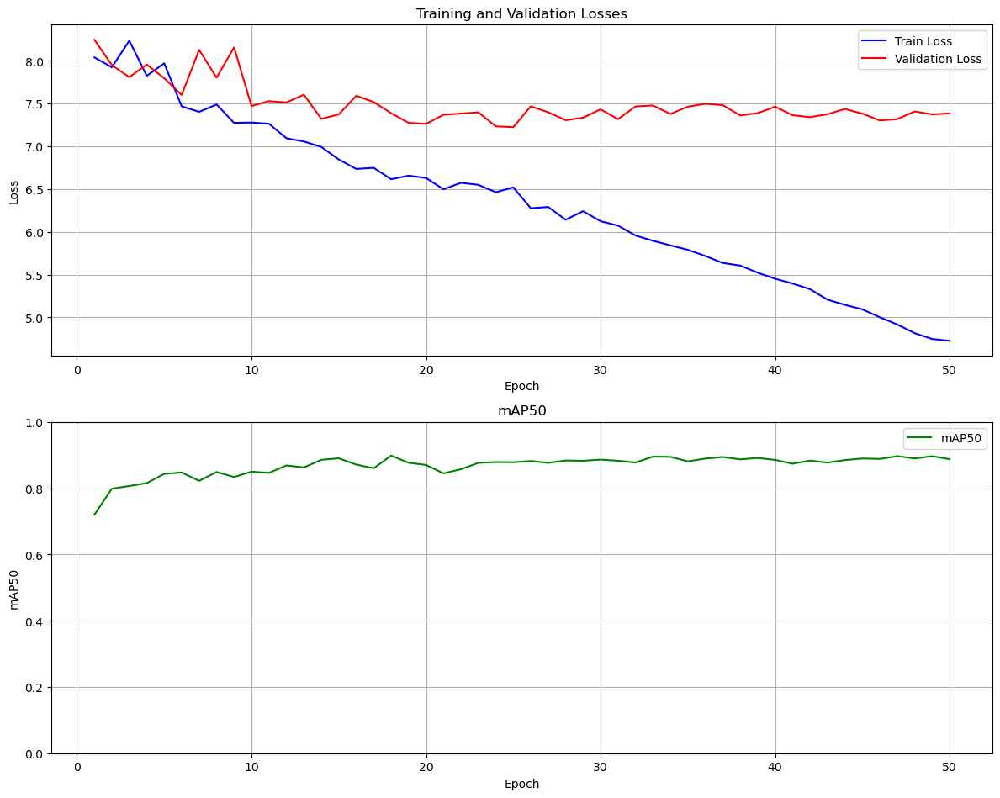

In [ ]:
### Plots
results_path = os.path.join(cwd, "yolo_football_analysis", "yolo9c_dataset_CpAug_custom_loss", "results.csv")
data = pd.read_csv(results_path)
plot_metrics(data)

#### Quantitative Test

In [ ]:
model = YOLO(r"yolo_football_analysis\yolo9c_dataset_CpAug_custom_loss\weights\best.pt")
model = model.cuda()
model.val(data=os.path.join(dataset_path, "data.yaml"), split="test", project="yolo_football_test", name="yolo9c_dataset_CpAug_custom_loss")

YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


val: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\test\labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:10<00:00,  2.66s/it]


                   all         60       1452      0.929      0.854      0.883      0.643
                  ball         52         53      0.842      0.509      0.578      0.265
            goalkeeper         40         41      0.957      0.951      0.977       0.76
                player         60       1202      0.991       0.99      0.994      0.813
               referee         60        156      0.926      0.966      0.984      0.733
Speed: 5.7ms preprocess, 47.7ms inference, 0.0ms loss, 19.7ms postprocess per image
Results saved to yolo_football_test\yolo9c_dataset_CpAug_custom_loss3


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000002185C54B7C0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

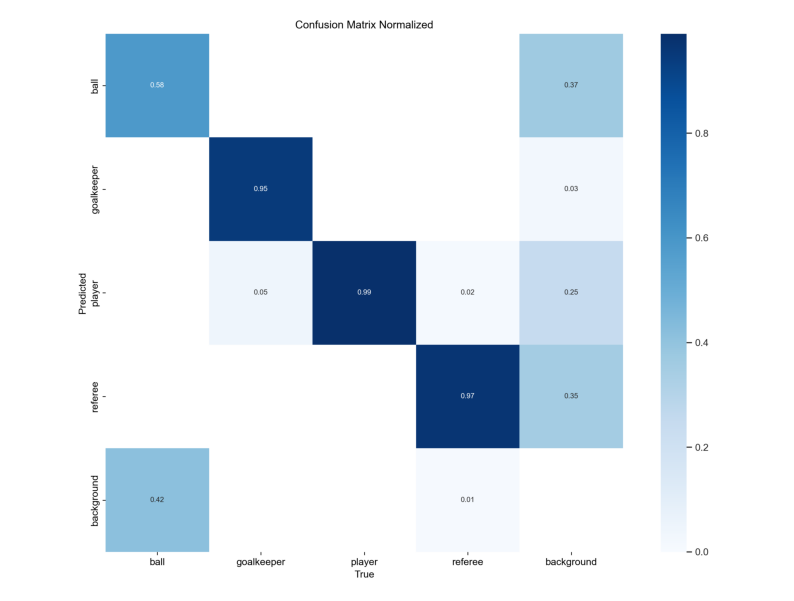

In [18]:
# load and show confusion matrix
matrix_path = os.path.join(cwd, "yolo_football_test", "yolo9c_dataset_CpAug_custom_loss", "confusion_matrix_normalized.png")
plot_confusion_matrix(matrix_path)


#### Qualitative Analysis on Challenging Samples

The qualitative analysis is based on three distinct samples:  
1. The first shows a stretched ball.  
2. The second features the ball under dim lighting conditions.  
3. The third depicts the ball partially occluded by a player.  

The purpose of this qualitative test is to assess the model’s performance under difficult conditions.


image 1/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\538438_1_10_png_jpg.rf.f0585e46a9ae3f1d0f64c24aaf7704b8.jpg: 736x1280 1 ball, 20 players, 2 referees, 527.8ms
image 2/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\Screenshot-2025-01-03-112748_png.rf.763a7d889601c8b79d673b84cdc4ae64.jpg: 736x1280 1 ball, 1 goalkeeper, 21 players, 2 referees, 502.9ms
image 3/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\c01561_1_6_png_jpg.rf.260b489d60904fa09f43dfb8daa38056.jpg: 736x1280 1 goalkeeper, 21 players, 2 referees, 525.1ms
Speed: 16.2ms preprocess, 518.6ms inference, 11.3ms postprocess per image at shape (1, 3, 736, 1280)


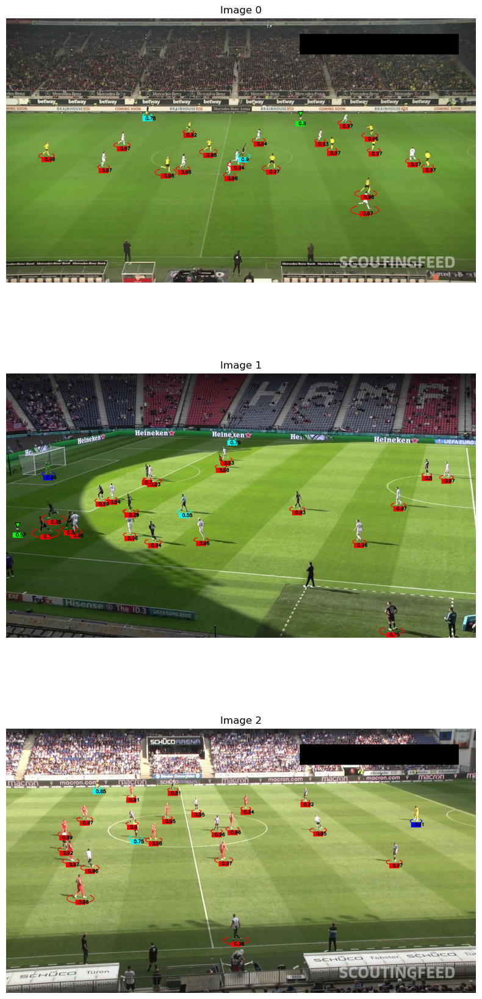

In [7]:
detect_images(images_to_test_path, r"yolo_football_analysis\yolo9c_dataset_CpAug_custom_loss\weights\best.pt")

Result: 
1. Detected with 0.80 confidence (+0.3)
2. Detected with 0.57 confidence (==)
3. Undetected

### Custom Focal Loss with increased cls_weight

This section contains the code for training and evaluation on the model with custom focal loss using the augmented dataset and a weight for the class loss of 4 instead of 0.5.

In [ ]:
mp.freeze_support()  # Necessario su Windows
model = YOLO("yolov9c.pt")
model = model.cuda()
dataset_path = os.path.join(dataset_root_folder, "yolov9", "copy-paste-augmented")

In [ ]:
model.train(data=os.path.join(dataset_path, "data.yaml"), epochs=50, imgsz=1280, cls=4, save=True, project="yolo_football_analysis", 
            name="yolo9c_dataset_CpAug_custom_loss_increased_cls_weight", batch=4)
wandb.finish()

New https://pypi.org/project/ultralytics/8.3.158 available  Update with 'pip install -U ultralytics'
engine\trainer: task=detect, mode=train, model=yolov9c.pt, data=c:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\code\training\..\..\dataset\v3\data.yaml, epochs=50, time=None, patience=100, batch=4, imgsz=1280, save=True, save_period=-1, cache=False, device=cuda:0, workers=8, project=yolo_football_analysis, name=yolo9c_dataset_v3_custom_loss_new_parameters, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: sianiemanuele (sianiemanuele_07) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed 


train: Scanning C:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\dataset\v3\train\labels.cache... 1530 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1530/1530 [00:00<?, ?it/s]
val: Scanning C:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\dataset\v3\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]


Plotting labels to yolo_football_analysis\yolo9c_dataset_v3_custom_loss_new_parameters\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 1280 train, 1280 val
Using 8 dataloader workers
Logging results to yolo_football_analysis\yolo9c_dataset_v3_custom_loss_new_parameters
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/383 [00:00<?, ?it/s]

[INFO] Using Custom Focal Loss...............


       1/50      11.4G      0.906     0.6107     0.8498        133       1280: 100%|██████████| 383/383 [1:31:36<00:00, 14.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/10 [00:00<?, ?it/s]

[INFO] Using Custom Focal Loss...............


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.87s/it]

                   all         75       1796       0.88       0.73      0.825      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      11.2G     0.9111     0.3463      0.847        115       1280: 100%|██████████| 383/383 [1:18:52<00:00, 12.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.52s/it]

                   all         75       1796      0.864       0.71      0.837      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      11.1G     0.9485      0.374     0.8582         64       1280: 100%|██████████| 383/383 [1:27:51<00:00, 13.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.27s/it]

                   all         75       1796      0.861      0.713      0.805      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      11.1G     0.9558     0.3573     0.8572         92       1280: 100%|██████████| 383/383 [1:14:14<00:00, 11.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:05<00:00,  6.59s/it]

                   all         75       1796       0.84      0.798      0.831      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      11.3G     0.8617     0.2898     0.8369        122       1280: 100%|██████████| 383/383 [1:12:25<00:00, 11.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.28s/it]

                   all         75       1796      0.869      0.815      0.857      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      11.3G     0.8459     0.2734      0.837        116       1280: 100%|██████████| 383/383 [1:14:21<00:00, 11.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.97s/it]

                   all         75       1796      0.879      0.821      0.855       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      11.1G     0.8346     0.2645     0.8313         88       1280: 100%|██████████| 383/383 [1:09:15<00:00, 10.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:40<00:00,  4.04s/it]

                   all         75       1796      0.911      0.824      0.871      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      11.1G     0.8243     0.2509     0.8313        117       1280: 100%|██████████| 383/383 [1:12:20<00:00, 11.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.40s/it]

                   all         75       1796      0.892      0.829      0.866      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      11.1G      0.809      0.242      0.828         77       1280: 100%|██████████| 383/383 [1:16:05<00:00, 11.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.68s/it]

                   all         75       1796      0.889      0.839      0.869      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      11.3G     0.8029     0.2549     0.8289        105       1280: 100%|██████████| 383/383 [1:14:39<00:00, 11.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.24s/it]

                   all         75       1796      0.929      0.822      0.865      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      11.2G     0.7877     0.2363     0.8269         81       1280: 100%|██████████| 383/383 [1:14:51<00:00, 11.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.84s/it]

                   all         75       1796      0.844      0.849      0.862      0.588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      11.1G     0.7804     0.2398     0.8247        174       1280: 100%|██████████| 383/383 [1:24:10<00:00, 13.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:59<00:00,  5.91s/it]

                   all         75       1796      0.916       0.82       0.86      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      11.1G     0.7903      0.229     0.8254        110       1280: 100%|██████████| 383/383 [1:24:26<00:00, 13.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.58s/it]

                   all         75       1796      0.872      0.833      0.863      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      11.2G     0.7713     0.2228     0.8219         91       1280: 100%|██████████| 383/383 [1:32:25<00:00, 14.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.67s/it]

                   all         75       1796      0.903      0.831      0.869      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      11.2G     0.7589     0.2283     0.8215         57       1280: 100%|██████████| 383/383 [1:13:48<00:00, 11.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.36s/it]

                   all         75       1796      0.918      0.863      0.874       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      11.2G     0.7652     0.2289     0.8222         45       1280: 100%|██████████| 383/383 [1:13:12<00:00, 11.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.26s/it]

                   all         75       1796      0.939      0.828      0.879      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      11.2G     0.7773      0.229     0.8242         92       1280: 100%|██████████| 383/383 [1:10:51<00:00, 11.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.20s/it]

                   all         75       1796      0.912      0.841      0.872      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      11.1G      0.747      0.206     0.8195         44       1280: 100%|██████████| 383/383 [1:24:59<00:00, 13.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:00<00:00,  6.10s/it]

                   all         75       1796      0.898      0.861      0.878      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      11.3G     0.7344     0.2008     0.8181        153       1280: 100%|██████████| 383/383 [1:13:58<00:00, 11.59s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.10s/it]

                   all         75       1796      0.908      0.845      0.876      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      11.2G     0.7398        0.2     0.8172         44       1280: 100%|██████████| 383/383 [1:18:43<00:00, 12.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.43s/it]

                   all         75       1796      0.922      0.835      0.876      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      11.2G     0.7198     0.1872     0.8156        142       1280: 100%|██████████| 383/383 [1:16:38<00:00, 12.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.92s/it]

                   all         75       1796      0.893      0.854      0.883      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      11.2G     0.7314     0.1914     0.8163         61       1280: 100%|██████████| 383/383 [1:05:32<00:00, 10.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.50s/it]

                   all         75       1796       0.93      0.867      0.898       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      11.2G     0.7188     0.1754     0.8142         51       1280: 100%|██████████| 383/383 [1:14:18<00:00, 11.64s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.22s/it]

                   all         75       1796      0.885      0.878      0.881      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      11.2G     0.7118     0.1764     0.8139        161       1280: 100%|██████████| 383/383 [1:17:57<00:00, 12.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.55s/it]

                   all         75       1796      0.883      0.881      0.888      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      11.3G     0.6998       0.17      0.811         90       1280: 100%|██████████| 383/383 [1:28:21<00:00, 13.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.46s/it]

                   all         75       1796      0.902       0.87      0.887      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      11.2G     0.6902     0.1692     0.8101         51       1280: 100%|██████████| 383/383 [1:13:43<00:00, 11.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.40s/it]

                   all         75       1796      0.858      0.859      0.871      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      11.2G     0.6933     0.1651     0.8093        107       1280: 100%|██████████| 383/383 [1:26:17<00:00, 13.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.42s/it]

                   all         75       1796      0.888      0.848      0.882      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      11.2G     0.6745     0.1615     0.8088         97       1280: 100%|██████████| 383/383 [1:17:08<00:00, 12.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:40<00:00,  4.04s/it]

                   all         75       1796      0.884      0.852      0.874      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      11.3G     0.6787      0.163     0.8079         67       1280: 100%|██████████| 383/383 [1:16:57<00:00, 12.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:39<00:00,  3.96s/it]

                   all         75       1796      0.924      0.841      0.889      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      11.3G     0.6699     0.1569     0.8069        108       1280: 100%|██████████| 383/383 [1:14:46<00:00, 11.71s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.94s/it]

                   all         75       1796      0.912      0.844      0.881      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      11.2G      0.676      0.154     0.8073        104       1280: 100%|██████████| 383/383 [1:27:28<00:00, 13.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.58s/it]

                   all         75       1796        0.9      0.878      0.904      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      11.2G     0.6569     0.1494     0.8055         41       1280: 100%|██████████| 383/383 [1:15:10<00:00, 11.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.98s/it]

                   all         75       1796      0.894       0.83      0.882      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      11.2G     0.6515      0.144     0.8041         75       1280: 100%|██████████| 383/383 [1:14:07<00:00, 11.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.33s/it]

                   all         75       1796      0.894      0.884      0.898      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      11.2G     0.6512     0.1383     0.8032         91       1280: 100%|██████████| 383/383 [1:19:23<00:00, 12.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:57<00:00,  5.74s/it]

                   all         75       1796        0.9      0.852      0.883      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      11.2G     0.6327     0.1292     0.8015        151       1280: 100%|██████████| 383/383 [1:34:05<00:00, 14.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:56<00:00,  5.61s/it]

                   all         75       1796      0.886       0.85      0.886      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      11.3G     0.6236     0.1294     0.7998         72       1280: 100%|██████████| 383/383 [1:19:53<00:00, 12.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:01<00:00,  6.15s/it]

                   all         75       1796      0.907      0.869      0.898      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      11.1G     0.6177     0.1268     0.8011         60       1280: 100%|██████████| 383/383 [1:20:38<00:00, 12.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.46s/it]

                   all         75       1796      0.916      0.855      0.897      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      11.2G     0.6172     0.1236     0.7986         85       1280: 100%|██████████| 383/383 [1:18:47<00:00, 12.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:40<00:00,  4.09s/it]

                   all         75       1796      0.922      0.869      0.903       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      11.1G     0.6052     0.1166     0.7973        150       1280: 100%|██████████| 383/383 [1:20:54<00:00, 12.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.45s/it]

                   all         75       1796      0.899      0.863      0.893      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      11.2G     0.5977     0.1159      0.797         62       1280: 100%|██████████| 383/383 [1:09:21<00:00, 10.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.11s/it]

                   all         75       1796      0.897      0.848      0.881       0.61


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      10.8G     0.5821     0.1038     0.7987         47       1280: 100%|██████████| 383/383 [1:24:05<00:00, 13.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.38s/it]

                   all         75       1796      0.883       0.88       0.89      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      10.8G     0.5793     0.1069      0.797         51       1280: 100%|██████████| 383/383 [1:27:19<00:00, 13.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.62s/it]

                   all         75       1796      0.892      0.875      0.891      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      10.8G       0.57     0.1013     0.7979         54       1280: 100%|██████████| 383/383 [1:29:51<00:00, 14.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.74s/it]

                   all         75       1796      0.898      0.872      0.895      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      6.12G     0.5595    0.09527     0.7954         55       1280: 100%|██████████| 383/383 [1:21:39<00:00, 12.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:11<00:00,  1.17s/it]

                   all         75       1796       0.88      0.885      0.902      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      10.8G     0.5561    0.09499     0.7942         45       1280: 100%|██████████| 383/383 [1:21:57<00:00, 12.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.31s/it]

                   all         75       1796      0.914       0.86      0.896      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      10.8G     0.5462    0.09171     0.7929         49       1280: 100%|██████████| 383/383 [1:27:34<00:00, 13.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.11s/it]

                   all         75       1796      0.927      0.859      0.902      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      10.8G     0.5358    0.08982     0.7934         47       1280: 100%|██████████| 383/383 [1:27:46<00:00, 13.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.92s/it]

                   all         75       1796      0.894      0.882      0.901      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      10.8G     0.5228    0.08287     0.7907         46       1280: 100%|██████████| 383/383 [1:30:03<00:00, 14.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.56s/it]

                   all         75       1796        0.9      0.869      0.894      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      10.8G     0.5184    0.07982       0.79         48       1280: 100%|██████████| 383/383 [1:27:56<00:00, 13.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.88s/it]

                   all         75       1796      0.905      0.884      0.898       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.23G     0.5144    0.07941     0.7896         45       1280: 100%|██████████| 383/383 [1:20:46<00:00, 12.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:35<00:00,  3.55s/it]

                   all         75       1796      0.906      0.875      0.897      0.616



50 epochs completed in 67.280 hours.
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_v3_custom_loss_new_parameters\weights\last.pt, 51.7MB
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_v3_custom_loss_new_parameters\weights\best.pt, 51.7MB

Validating yolo_football_analysis\yolo9c_dataset_v3_custom_loss_new_parameters\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:29<00:00,  2.94s/it]


                   all         75       1796      0.895      0.884      0.898      0.629
                  ball         73         73      0.857      0.616      0.664      0.326
            goalkeeper         50         50      0.783       0.94      0.946      0.706
                player         75       1493      0.986      0.994      0.995      0.781
               referee         75        180      0.952      0.985      0.988      0.703
Speed: 2.7ms preprocess, 358.8ms inference, 0.0ms loss, 18.9ms postprocess per image
Results saved to yolo_football_analysis\yolo9c_dataset_v3_custom_loss_new_parameters


lr/pg0,▃▆███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg1,▃▆███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
lr/pg2,▃▆███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
metrics/mAP50(B),▂▃▁▃▅▆▅▆▅▅▅▆▆▆▆▆▇█▆▇▆▇▆▇▆█▇▇██▇▆▇▇▇███▇█
metrics/mAP50-95(B),▃▄▁▅▆▆▅▆▇▆▆▇▆▆▆▇▇▇▇█▆▇▇▇▇▇█▇▇▇█▇▇▇▇▇██▇█
metrics/precision(B),▄▃▂▁▃▆▅▄▇▁▃▅█▆▅▇▅▇▄▄▂▄▄▇▆▅▅▅▄▆▅▅▄▅▅▆▇▅▅▅
metrics/recall(B),▂▁▁▅▅▆▆▅▇▅▇▆▆▇▆▇▇██▇▇▇▆▆██▇▇▇▇▇▇███▇▇█▇█
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,▇▇██▇▆▆▆▆▅▅▅▅▅▅▅▄▄▄▄▄▄▄▃▄▃▃▃▃▃▂▂▂▂▂▂▂▁▁▁


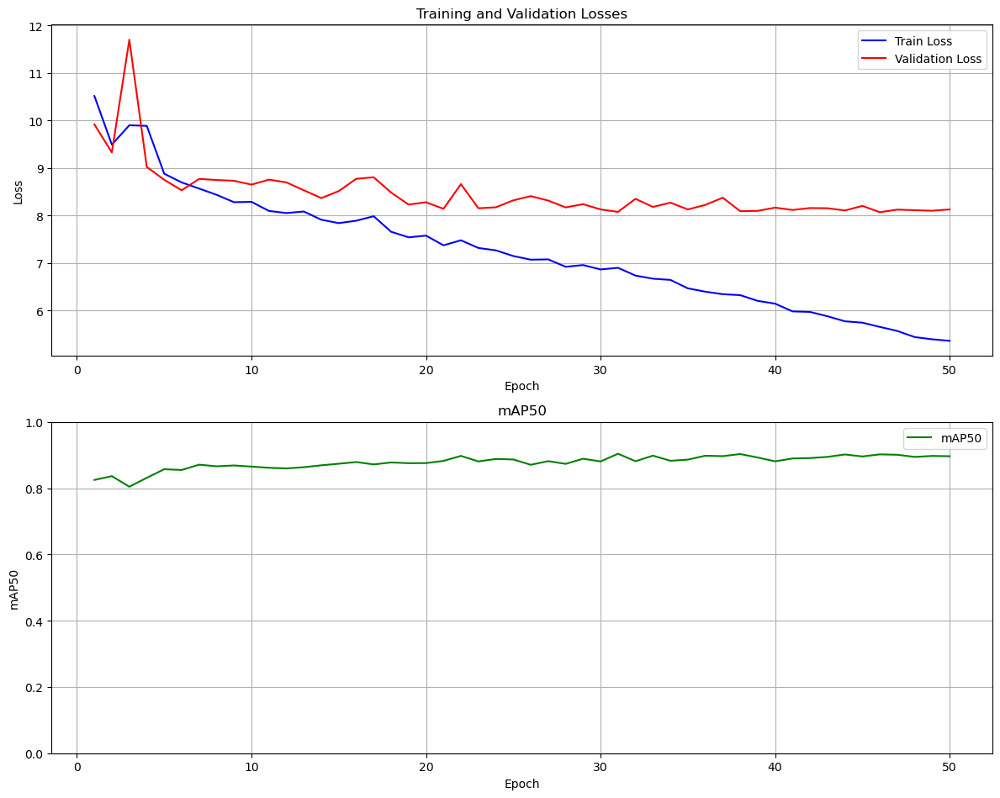

In [ ]:
### Plots
results_path = os.path.join(cwd, "yolo_football_analysis", "yolo9c_dataset_CpAug_custom_loss_increased_cls_weight", "results.csv")
data = pd.read_csv(results_path)
plot_metrics(data, cls_weight=4.0)

#### Quantitative Test

In [ ]:
model = YOLO(r"yolo_football_analysis\yolo9c_dataset_CpAug_custom_loss_increased_cls_weight\weights\best.pt")
model = model.cuda()
model.val(data=os.path.join(dataset_path, "data.yaml"), split="test", project="yolo_football_test", name="yolo9c_dataset_CpAug_custom_loss_increased_cls_weight")

YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


val: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\test\labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:09<00:00,  2.38s/it]


                   all         60       1452      0.938       0.87      0.888      0.646
                  ball         52         53      0.796      0.528      0.581      0.257
            goalkeeper         40         41      0.978      0.976      0.984      0.781
                player         60       1202      0.991      0.991      0.993      0.809
               referee         60        156      0.987      0.987      0.994      0.739
Speed: 5.3ms preprocess, 47.2ms inference, 0.0ms loss, 11.9ms postprocess per image
Results saved to yolo_football_test\yolo9c_dataset_CpAug_custom_loss_new_parameters2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000218BBD52F80>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

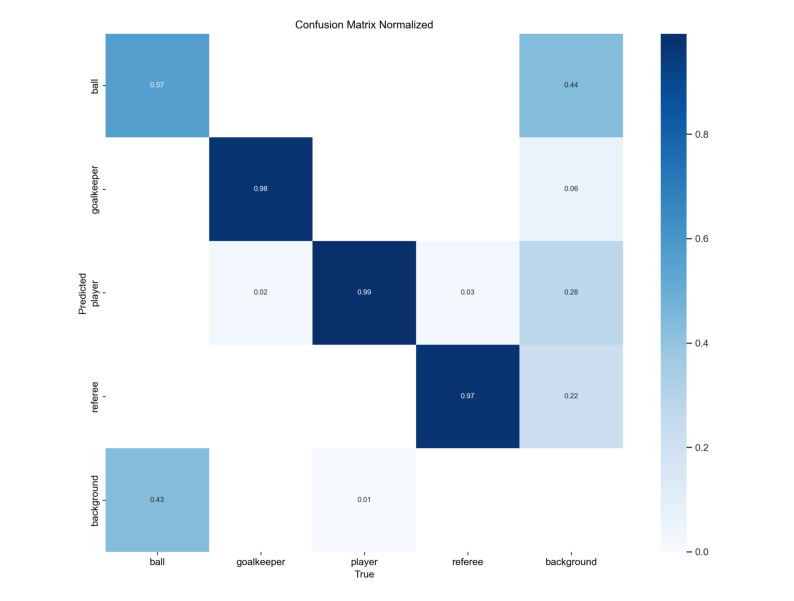

In [ ]:
# load and show confusion matrix
matrix_path = os.path.join(cwd, "yolo_football_test", "yolo9c_dataset_CpAug_custom_loss_increased_cls_weight", "confusion_matrix_normalized.png")
plot_confusion_matrix(matrix_path)


#### Qualitative Analysis on Challenging Samples

The qualitative analysis is based on three distinct samples:  
1. The first shows a stretched ball.  
2. The second features the ball under dim lighting conditions.  
3. The third depicts the ball partially occluded by a player.  

The purpose of this qualitative test is to assess the model’s performance under difficult conditions.


image 1/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\538438_1_10_png_jpg.rf.f0585e46a9ae3f1d0f64c24aaf7704b8.jpg: 736x1280 1 ball, 20 players, 2 referees, 519.2ms
image 2/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\Screenshot-2025-01-03-112748_png.rf.763a7d889601c8b79d673b84cdc4ae64.jpg: 736x1280 1 ball, 1 goalkeeper, 21 players, 3 referees, 529.0ms
image 3/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\c01561_1_6_png_jpg.rf.260b489d60904fa09f43dfb8daa38056.jpg: 736x1280 1 goalkeeper, 20 players, 2 referees, 541.5ms
Speed: 8.8ms preprocess, 529.9ms inference, 2.8ms postprocess per image at shape (1, 3, 736, 1280)


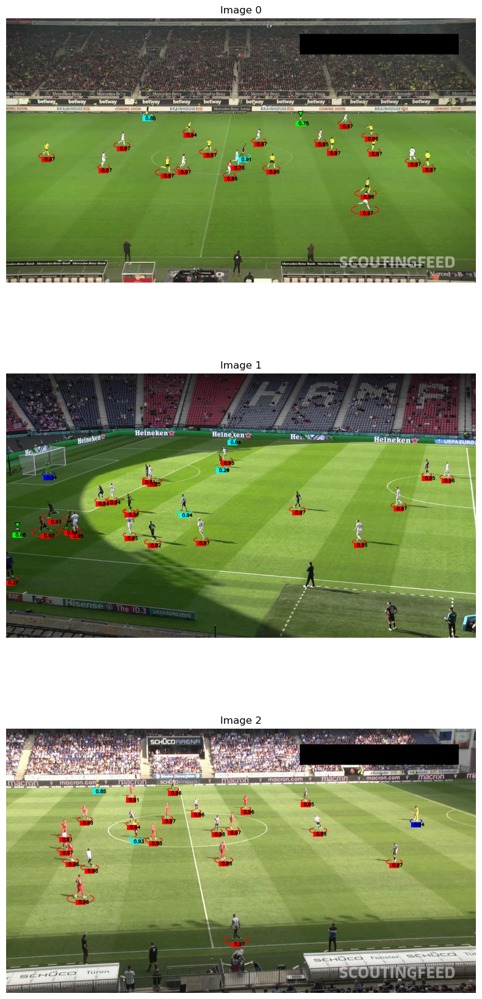

In [ ]:
detect_images(images_to_test_path, r"yolo_football_analysis\yolo9c_dataset_CpAug_custom_loss_increased_cls_weight\weights\best.pt")

Result: 
1. Detected with 0.75 confidence
2. Detected with 0.68 confidence
3. Undetected

## Baseline Dataset

### Custom Focal Loss

This section contains the code for training and evaluation on the model with custom focal loss using the baseline dataset

In [2]:
# use focal loss but with increased weight for the ball
mp.freeze_support()  # Necessario su Windows
model = YOLO("yolov9c.pt")
model = model.cuda()
dataset_path = os.path.join(dataset_root_folder, "yolov9", "baseline")

In [3]:
model.train(data=os.path.join(dataset_path, "data.yaml"), epochs=50, imgsz=1280, save=True, project="yolo_football_analysis", 
            name="yolo9c_dataset_baseline_custom_focal_loss", batch=4)
wandb.finish()

New https://pypi.org/project/ultralytics/8.3.162 available  Update with 'pip install -U ultralytics'
engine\trainer: task=detect, mode=train, model=yolov9c.pt, data=c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\../../dataset\yolov9\baseline\data.yaml, epochs=50, time=None, patience=100, batch=4, imgsz=1280, save=True, save_period=-1, cache=False, device=cuda:0, workers=8, project=yolo_football_analysis, name=yolo9c_dataset_baseline_custom_focal_loss, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nm

wandb: Currently logged in as: sianiemanuele (sianiemanuele_07) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed 


train: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\train\labels.cache... 510 images, 0 backgrounds, 0 corrupt: 100%|██████████| 510/510 [00:00<?, ?it/s]Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\train\labels.cache... 510 images, 0 backgrounds, 0 corrupt: 100%|██████████| 510/510 [00:00<?, ?it/s]
val: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]


Plotting labels to yolo_football_analysis\yolo9c_dataset_baseline_custom_focal_loss\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 1280 train, 1280 val
Using 8 dataloader workers
Logging results to yolo_football_analysis\yolo9c_dataset_baseline_custom_focal_loss
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/128 [00:00<?, ?it/s]

[INFO] Using Custom Focal Loss...............


       1/50      11.3G      0.934     0.1216      0.857         47       1280: 100%|██████████| 128/128 [31:38<00:00, 14.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/10 [00:00<?, ?it/s]

[INFO] Using Custom Focal Loss...............


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.20s/it]


                   all         75       1796      0.695       0.63      0.653      0.408

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      11.1G     0.9657    0.07458     0.8675         76       1280: 100%|██████████| 128/128 [25:40<00:00, 12.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.78s/it]


                   all         75       1796      0.791      0.691      0.748      0.477

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      11.2G     0.9769    0.06969     0.8693         43       1280: 100%|██████████| 128/128 [25:05<00:00, 11.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:09<00:00,  6.90s/it]


                   all         75       1796      0.829      0.703       0.76      0.493

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      11.3G      1.069    0.06795      0.871         88       1280: 100%|██████████| 128/128 [23:36<00:00, 11.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.19s/it]


                   all         75       1796      0.778      0.716      0.755      0.422

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      11.3G      1.015    0.06215     0.8656         87       1280: 100%|██████████| 128/128 [25:48<00:00, 12.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.39s/it]


                   all         75       1796      0.808      0.772      0.806      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      11.3G     0.9625    0.05536     0.8652         98       1280: 100%|██████████| 128/128 [24:13<00:00, 11.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:03<00:00,  6.38s/it]


                   all         75       1796      0.827      0.765      0.809       0.53

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      11.1G     0.8891    0.04773     0.8547         51       1280: 100%|██████████| 128/128 [25:29<00:00, 11.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.28s/it]


                   all         75       1796      0.887      0.774      0.832      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      11.3G     0.9044    0.04798     0.8447        103       1280: 100%|██████████| 128/128 [24:02<00:00, 11.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.30s/it]


                   all         75       1796      0.894       0.81      0.846      0.558

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      11.3G     0.8568    0.04342      0.845         65       1280: 100%|██████████| 128/128 [24:26<00:00, 11.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:59<00:00,  5.97s/it]


                   all         75       1796        0.9      0.746      0.848      0.555

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      11.3G     0.8257    0.04238     0.8304         96       1280: 100%|██████████| 128/128 [21:35<00:00, 10.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:00<00:00,  6.07s/it]


                   all         75       1796      0.896      0.802      0.858      0.567

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      11.2G     0.8659    0.04272     0.8433         69       1280: 100%|██████████| 128/128 [24:07<00:00, 11.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:03<00:00,  6.36s/it]


                   all         75       1796      0.851      0.726      0.831      0.561

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      11.2G     0.8136    0.03729     0.8346        114       1280: 100%|██████████| 128/128 [25:20<00:00, 11.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:06<00:00,  6.61s/it]


                   all         75       1796      0.874      0.796       0.86      0.582

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      11.2G     0.8294    0.03724     0.8333         91       1280: 100%|██████████| 128/128 [24:39<00:00, 11.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:05<00:00,  6.51s/it]


                   all         75       1796      0.892      0.809      0.873      0.587

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      11.2G     0.7994    0.03782     0.8301         97       1280: 100%|██████████| 128/128 [25:08<00:00, 11.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:10<00:00,  7.08s/it]


                   all         75       1796      0.933      0.821      0.859      0.573

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      11.3G     0.8366     0.0404     0.8329         34       1280: 100%|██████████| 128/128 [27:33<00:00, 12.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.38s/it]


                   all         75       1796      0.957       0.81      0.881      0.579

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      11.3G     0.8002    0.03752     0.8292        107       1280: 100%|██████████| 128/128 [26:17<00:00, 12.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:03<00:00,  6.37s/it]


                   all         75       1796       0.93      0.814      0.871      0.585

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      11.3G      0.791    0.03539     0.8258        116       1280: 100%|██████████| 128/128 [23:59<00:00, 11.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:58<00:00,  5.89s/it]


                   all         75       1796       0.86      0.834      0.873       0.58

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      11.3G      0.793    0.03502     0.8308        129       1280: 100%|██████████| 128/128 [22:15<00:00, 10.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:00<00:00,  6.10s/it]


                   all         75       1796      0.829      0.823      0.868      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      11.1G     0.7969    0.03751     0.8341         34       1280: 100%|██████████| 128/128 [25:32<00:00, 11.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:59<00:00,  6.00s/it]


                   all         75       1796      0.882      0.831       0.87      0.576

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      11.2G     0.7884    0.03575     0.8267         44       1280: 100%|██████████| 128/128 [23:34<00:00, 11.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:11<00:00,  7.19s/it]


                   all         75       1796      0.855      0.807      0.875      0.586

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      11.2G     0.7703     0.0347     0.8253         83       1280: 100%|██████████| 128/128 [24:39<00:00, 11.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:01<00:00,  6.14s/it]


                   all         75       1796      0.931      0.813       0.88      0.588

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      11.2G     0.7898    0.03376     0.8269         98       1280: 100%|██████████| 128/128 [23:46<00:00, 11.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:58<00:00,  5.84s/it]


                   all         75       1796      0.916      0.786      0.879      0.582

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      11.2G     0.8038    0.03287     0.8274         30       1280: 100%|██████████| 128/128 [25:07<00:00, 11.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:01<00:00,  6.14s/it]


                   all         75       1796      0.882      0.845      0.883      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      11.3G     0.7825    0.03214     0.8249         60       1280: 100%|██████████| 128/128 [25:36<00:00, 12.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:03<00:00,  6.35s/it]


                   all         75       1796      0.899      0.833      0.888      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      11.1G      0.741    0.03155     0.8196         87       1280: 100%|██████████| 128/128 [28:18<00:00, 13.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.43s/it]


                   all         75       1796       0.89      0.818      0.883      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      11.1G     0.7474    0.03018     0.8253         57       1280: 100%|██████████| 128/128 [27:18<00:00, 12.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:58<00:00,  5.88s/it]


                   all         75       1796      0.892      0.863      0.887      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      11.2G     0.7322    0.02931     0.8215         68       1280: 100%|██████████| 128/128 [26:53<00:00, 12.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:02<00:00,  6.21s/it]


                   all         75       1796      0.843      0.863       0.88      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      11.2G     0.7394    0.03113     0.8249         71       1280: 100%|██████████| 128/128 [26:41<00:00, 12.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:57<00:00,  5.72s/it]


                   all         75       1796      0.896      0.838       0.88      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      11.2G     0.7338    0.02939      0.822         75       1280: 100%|██████████| 128/128 [25:51<00:00, 12.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:56<00:00,  5.62s/it]


                   all         75       1796      0.895      0.819       0.88      0.581

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      11.2G     0.7427     0.0311     0.8215         59       1280: 100%|██████████| 128/128 [25:40<00:00, 12.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:02<00:00,  6.25s/it]


                   all         75       1796      0.935      0.811      0.881      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      11.3G      0.739     0.0291     0.8188         72       1280: 100%|██████████| 128/128 [24:01<00:00, 11.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.83s/it]


                   all         75       1796      0.946      0.796      0.883      0.602

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      11.3G     0.7422    0.02925     0.8235         55       1280: 100%|██████████| 128/128 [26:02<00:00, 12.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:01<00:00,  6.10s/it]


                   all         75       1796      0.876      0.834      0.878      0.599

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      11.2G     0.7429    0.02848     0.8201         60       1280: 100%|██████████| 128/128 [25:17<00:00, 11.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:00<00:00,  6.08s/it]


                   all         75       1796      0.892      0.833      0.879      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      11.3G     0.7339    0.02697     0.8192         53       1280: 100%|██████████| 128/128 [26:41<00:00, 12.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.05s/it]


                   all         75       1796      0.883      0.872      0.892      0.605

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      11.2G     0.7152    0.02617     0.8163        101       1280: 100%|██████████| 128/128 [27:25<00:00, 12.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.32s/it]


                   all         75       1796      0.919      0.843      0.893      0.605

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      11.2G     0.7116    0.02615     0.8164         55       1280: 100%|██████████| 128/128 [23:58<00:00, 11.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.12s/it]


                   all         75       1796      0.892      0.864      0.885      0.592

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      11.3G     0.7141    0.02731     0.8172        143       1280: 100%|██████████| 128/128 [26:04<00:00, 12.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.48s/it]


                   all         75       1796      0.907      0.852      0.889      0.608

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      11.2G     0.6931    0.02456     0.8128         42       1280: 100%|██████████| 128/128 [25:03<00:00, 11.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:56<00:00,  5.66s/it]


                   all         75       1796      0.892      0.851        0.9      0.617

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      11.3G     0.6853    0.02476     0.8119         87       1280: 100%|██████████| 128/128 [24:50<00:00, 11.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:58<00:00,  5.82s/it]


                   all         75       1796      0.931      0.839      0.898      0.607

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      11.3G     0.6739    0.02334     0.8107        178       1280: 100%|██████████| 128/128 [23:42<00:00, 11.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:01<00:00,  6.18s/it]


                   all         75       1796      0.924      0.854      0.898      0.609
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      11.1G     0.6693    0.02289     0.8151         48       1280: 100%|██████████| 128/128 [28:30<00:00, 13.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.42s/it]


                   all         75       1796      0.947      0.813      0.888      0.609

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      11.1G     0.6704    0.02312     0.8169         46       1280: 100%|██████████| 128/128 [25:06<00:00, 11.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:02<00:00,  6.28s/it]


                   all         75       1796      0.898      0.835      0.876      0.596

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.18G     0.6727    0.02262     0.8132         49       1280: 100%|██████████| 128/128 [22:57<00:00, 10.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:16<00:00,  1.69s/it]


                   all         75       1796      0.885      0.844      0.876      0.601

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      11.1G     0.6658    0.02159     0.8122         46       1280: 100%|██████████| 128/128 [24:27<00:00, 11.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.44s/it]


                   all         75       1796      0.897      0.853      0.896      0.609

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      11.1G     0.6666    0.02106     0.8179         44       1280: 100%|██████████| 128/128 [27:01<00:00, 12.67s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:00<00:00,  6.03s/it]


                   all         75       1796      0.877      0.856      0.889      0.605

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.17G     0.6582    0.02029     0.8134         48       1280: 100%|██████████| 128/128 [26:30<00:00, 12.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:11<00:00,  1.20s/it]


                   all         75       1796      0.858      0.865      0.887      0.604

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.32G     0.6415     0.0196     0.8098         46       1280: 100%|██████████| 128/128 [28:46<00:00, 13.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:15<00:00,  1.58s/it]


                   all         75       1796      0.931      0.864      0.899      0.619

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      11.1G     0.6387     0.0191     0.8087         48       1280: 100%|██████████| 128/128 [26:05<00:00, 12.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.13s/it]


                   all         75       1796      0.894      0.875        0.9      0.613

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      11.1G     0.6291    0.01821     0.8086         49       1280: 100%|██████████| 128/128 [27:06<00:00, 12.71s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:03<00:00,  6.32s/it]


                   all         75       1796      0.906      0.873      0.903      0.618

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      11.1G     0.6177    0.01767     0.8078         47       1280: 100%|██████████| 128/128 [26:17<00:00, 12.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.04s/it]


                   all         75       1796      0.889      0.867      0.908      0.611

50 epochs completed in 22.082 hours.
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_baseline_custom_focal_loss\weights\last.pt, 51.7MB
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_baseline_custom_focal_loss\weights\best.pt, 51.7MB

Validating yolo_football_analysis\yolo9c_dataset_baseline_custom_focal_loss\weights\best.pt...
Ultralytics 8.3.28  Python-3.10.0 torch-2.5.0 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:40<00:00,  4.00s/it]


                   all         75       1796      0.931      0.864      0.899      0.618
                  ball         73         73      0.953      0.556      0.669      0.304
            goalkeeper         50         50      0.854      0.939      0.947      0.686
                player         75       1493      0.977      0.992      0.994      0.776
               referee         75        180      0.941      0.968      0.986      0.704
Speed: 4.2ms preprocess, 425.3ms inference, 0.0ms loss, 93.9ms postprocess per image
Results saved to yolo_football_analysis\yolo9c_dataset_baseline_custom_focal_loss


lr/pg0,▃▆███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg1,▃▆███▇▇▇▇▇▇▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
lr/pg2,▃▆███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
metrics/mAP50(B),▁▄▄▄▅▆▆▇▆▇▇▇▇▇▇▇▇███▇▇▇▇█▇███████▇▇█████
metrics/mAP50-95(B),▁▃▄▁▅▅▆▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇██▇████▇█████
metrics/precision(B),▁▄▅▃▅▆▆▆▅▆▇█▇▅▅▅▇▇▆▆▆▅▆▆▇▆▆▆▇▆▆▇▇█▆▆▅▇▆▇
metrics/recall(B),▁▃▃▃▅▅▆▄▆▄▆▆▆▆▇▇▆▅▇▆█▇▆▆▆▇█▇█▇▇▇▆▇▇▇████
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,▆▇█▆▅▅▄▅▄▄▄▄▄▄▄▃▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁


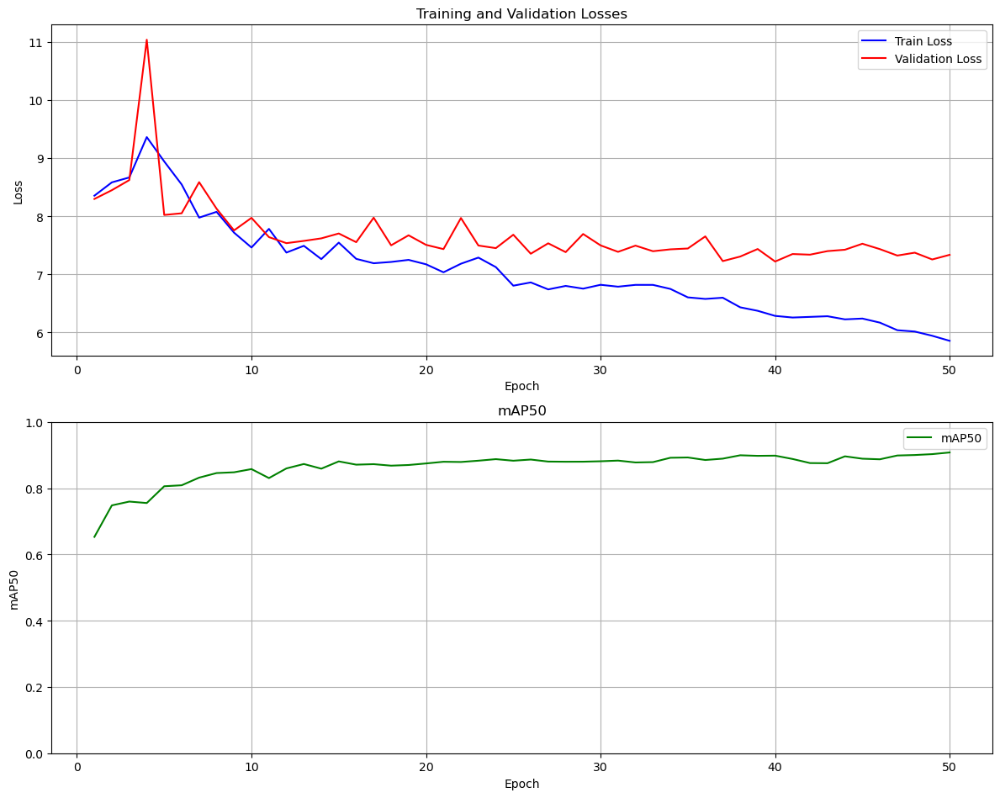

In [5]:
### Plots
results_path = os.path.join(cwd, "yolo_football_analysis", "yolo9c_dataset_baseline_custom_focal_loss", "results.csv")
data = pd.read_csv(results_path)
plot_metrics(data)

#### Quantitative test

In [5]:
# Test the model on the test set
model = YOLO(r"yolo_football_analysis\yolo9c_dataset_baseline_custom_focal_loss\weights\best.pt")
model = model.cuda()
model.val(data=os.path.join(dataset_path, "data.yaml"), split="test", project="yolo_football_test", name="yolo9c_dataset_baseline_custom_focal_loss")

YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


val: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\test\labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\test\labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:54<00:00, 13.71s/it]


                   all         60       1452      0.891      0.865      0.893       0.64
                  ball         52         53      0.826      0.537       0.62      0.273
            goalkeeper         40         41      0.878      0.976      0.976      0.739
                player         60       1202      0.957      0.994      0.994      0.814
               referee         60        156      0.903      0.955      0.981      0.733
Speed: 6.0ms preprocess, 706.2ms inference, 0.0ms loss, 63.1ms postprocess per image
Results saved to yolo_football_test\yolo9c_dataset_baseline_custom_focal_loss


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000028862EFB190>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

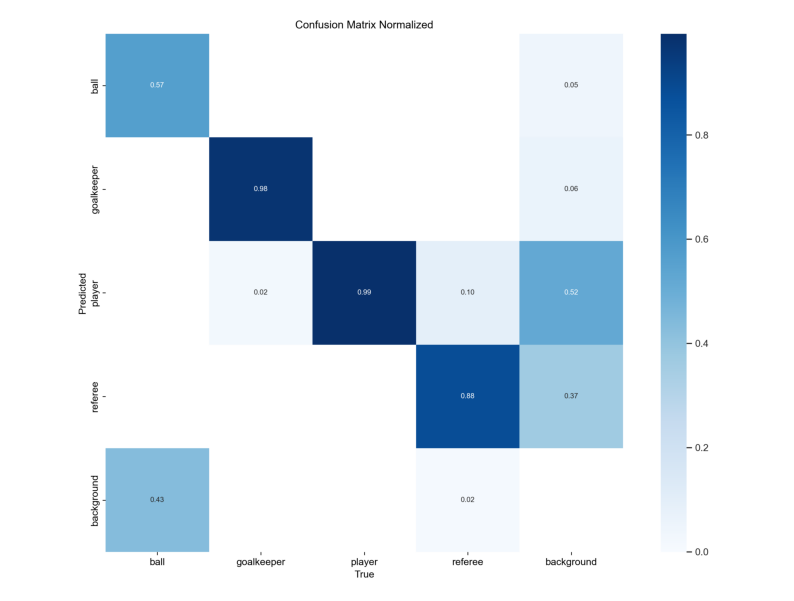

In [3]:
# load and show confusion matrix
matrix_path = os.path.join(cwd, "yolo_football_test", "yolo9c_dataset_baseline_custom_focal_loss", "confusion_matrix_normalized.png")
plot_confusion_matrix(matrix_path)


#### Qualitative Analysis on Challenging Samples

The qualitative analysis is based on three distinct samples:  
1. The first shows a stretched ball.  
2. The second features the ball under dim lighting conditions.  
3. The third depicts the ball partially occluded by a player.  

The purpose of this qualitative test is to assess the model’s performance under difficult conditions.


image 1/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\538438_1_10_png_jpg.rf.f0585e46a9ae3f1d0f64c24aaf7704b8.jpg: 736x1280 1 ball, 20 players, 2 referees, 81.5ms
image 2/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\Screenshot-2025-01-03-112748_png.rf.763a7d889601c8b79d673b84cdc4ae64.jpg: 736x1280 1 ball, 1 goalkeeper, 23 players, 2 referees, 53.2ms
image 3/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\c01561_1_6_png_jpg.rf.260b489d60904fa09f43dfb8daa38056.jpg: 736x1280 1 goalkeeper, 20 players, 2 referees, 53.3ms
Speed: 7.0ms preprocess, 62.7ms inference, 27.8ms postprocess per image at shape (1, 3, 736, 1280)


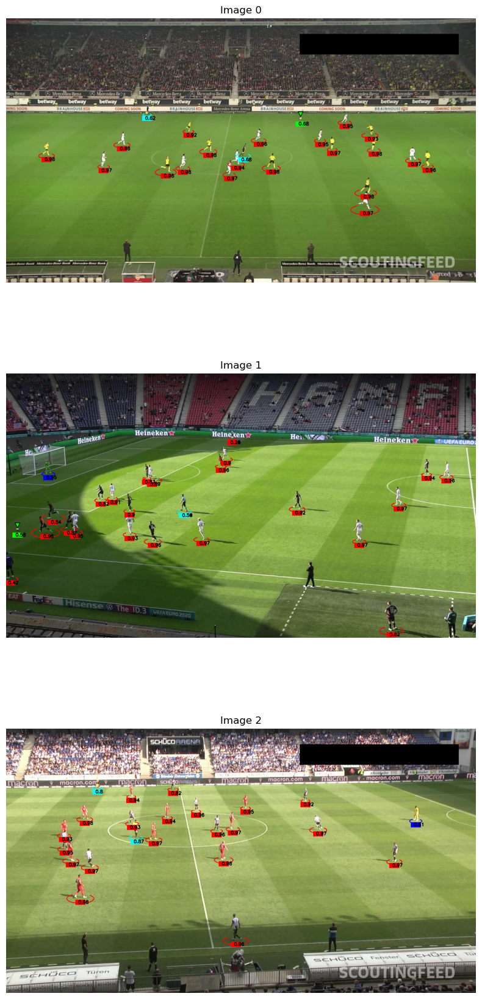

In [4]:
detect_images(images_to_test_path, r"yolo_football_analysis\yolo9c_dataset_baseline_custom_focal_loss\weights\best.pt")

Result: 
1. Detected with 0.68 confidence
2. Detected with 0.58 confidence
3. Undetected

### Custom Focal Loss with incresed cls_weight Baseline Dataset

This section contains the code for training and evaluation on the model with custom focal loss using the baseline dataset and a weight for the class loss of 4 instead of 0.5.

In [ ]:
# use focal loss but with increased weight for the ball
mp.freeze_support()  # Necessario su Windows
model = YOLO("yolov9c.pt")
model = model.cuda()
dataset_path = os.path.join(dataset_root_folder, "yolov9", "baseline")

In [ ]:
model.train(data=os.path.join(dataset_path, "data.yaml"), epochs=50, imgsz=1280, cls=4, save=True, project="yolo_football_analysis", 
            name="yolo9c_dataset_baseline_custom_focal_loss_increased_cls_weight", batch=4)
wandb.finish()

New https://pypi.org/project/ultralytics/8.3.160 available  Update with 'pip install -U ultralytics'
engine\trainer: task=detect, mode=train, model=yolov9c.pt, data=c:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\code\training\..\..\dataset\v0\data.yaml, epochs=50, time=None, patience=100, batch=4, imgsz=1280, save=True, save_period=-1, cache=False, device=cuda:0, workers=8, project=yolo_football_analysis, name=yolo9c_custom_loss_no_cp2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: sianiemanuele (sianiemanuele_07) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed 


train: Scanning C:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\dataset\v0\train\labels.cache... 510 images, 0 backgrounds, 0 corrupt: 100%|██████████| 510/510 [00:00<?, ?it/s]
val: Scanning C:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\dataset\v0\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]


Plotting labels to yolo_football_analysis\yolo9c_custom_loss_no_cp2\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 1280 train, 1280 val
Using 8 dataloader workers
Logging results to yolo_football_analysis\yolo9c_custom_loss_no_cp2
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/128 [00:00<?, ?it/s]

[INFO] Using Custom Focal Loss...............


       1/50      11.3G     0.9927      1.097     0.8703         47       1280: 100%|██████████| 128/128 [31:19<00:00, 14.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/10 [00:00<?, ?it/s]

[INFO] Using Custom Focal Loss...............


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:56<00:00,  5.61s/it]

                   all         75       1796       0.87      0.618      0.692      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      11.1G      1.043     0.4986     0.8835         76       1280: 100%|██████████| 128/128 [25:41<00:00, 12.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.48s/it]

                   all         75       1796      0.819      0.719      0.777      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      11.2G      1.055     0.5907     0.8834         43       1280: 100%|██████████| 128/128 [24:55<00:00, 11.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:05<00:00,  6.59s/it]

                   all         75       1796       0.69      0.673      0.719       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      11.3G      1.071     0.7522     0.8827         88       1280: 100%|██████████| 128/128 [23:01<00:00, 10.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.54s/it]

                   all         75       1796      0.634      0.578      0.552      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      11.3G      1.071     0.6645     0.8848         87       1280: 100%|██████████| 128/128 [25:47<00:00, 12.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:02<00:00,  6.27s/it]

                   all         75       1796       0.86      0.736      0.802      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      11.3G     0.9555     0.4224     0.8672         98       1280: 100%|██████████| 128/128 [24:56<00:00, 11.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:59<00:00,  5.96s/it]

                   all         75       1796      0.904      0.772      0.836       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      11.1G      0.966     0.3909     0.8631         51       1280: 100%|██████████| 128/128 [25:05<00:00, 11.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.19s/it]

                   all         75       1796      0.913      0.816      0.861      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      11.3G     0.9379     0.3507     0.8521        103       1280: 100%|██████████| 128/128 [24:40<00:00, 11.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.29s/it]

                   all         75       1796      0.804      0.814      0.861       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      11.3G     0.9359     0.3364     0.8618         65       1280: 100%|██████████| 128/128 [25:05<00:00, 11.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.61s/it]

                   all         75       1796      0.921      0.818       0.87      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      11.3G     0.8864     0.3144     0.8431         96       1280: 100%|██████████| 128/128 [23:01<00:00, 10.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.10s/it]

                   all         75       1796      0.923      0.838      0.871      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      11.2G     0.8926     0.3076     0.8484         69       1280: 100%|██████████| 128/128 [23:41<00:00, 11.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.57s/it]

                   all         75       1796      0.928      0.832      0.876      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      11.2G      0.833     0.2749     0.8381        114       1280: 100%|██████████| 128/128 [26:24<00:00, 12.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:00<00:00,  6.04s/it]

                   all         75       1796      0.897      0.835      0.869      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      11.2G     0.8447      0.287     0.8371         91       1280: 100%|██████████| 128/128 [25:26<00:00, 11.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.20s/it]

                   all         75       1796      0.916      0.834      0.874      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      11.2G     0.8223     0.2754     0.8356         97       1280: 100%|██████████| 128/128 [24:28<00:00, 11.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:05<00:00,  6.51s/it]

                   all         75       1796      0.913      0.822      0.872      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      11.3G     0.8535     0.2734     0.8382         34       1280: 100%|██████████| 128/128 [24:51<00:00, 11.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:03<00:00,  6.34s/it]

                   all         75       1796      0.931      0.842      0.882      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      11.3G     0.8888     0.3001     0.8435        107       1280: 100%|██████████| 128/128 [21:57<00:00, 10.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.97s/it]

                   all         75       1796      0.871      0.855      0.879      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      11.3G     0.8766     0.2882     0.8371        116       1280: 100%|██████████| 128/128 [26:56<00:00, 12.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.55s/it]

                   all         75       1796      0.885      0.845      0.879       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      11.3G     0.8326     0.2706     0.8379        129       1280: 100%|██████████| 128/128 [24:31<00:00, 11.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.26s/it]

                   all         75       1796      0.873      0.869      0.885      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      11.1G     0.8264     0.2642     0.8399         34       1280: 100%|██████████| 128/128 [25:18<00:00, 11.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.21s/it]

                   all         75       1796      0.914      0.838      0.884      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      11.2G     0.8029     0.2499     0.8287         44       1280: 100%|██████████| 128/128 [23:12<00:00, 10.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.32s/it]

                   all         75       1796      0.904      0.856      0.876      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      11.2G     0.7842     0.2517     0.8277         83       1280: 100%|██████████| 128/128 [27:03<00:00, 12.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.99s/it]

                   all         75       1796       0.87      0.845       0.87      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      11.2G     0.8088     0.2574     0.8309         98       1280: 100%|██████████| 128/128 [23:19<00:00, 10.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.09s/it]

                   all         75       1796      0.901      0.824      0.867      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      11.2G     0.7872     0.2446     0.8288         30       1280: 100%|██████████| 128/128 [22:53<00:00, 10.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.57s/it]

                   all         75       1796       0.83      0.841      0.885      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      11.3G     0.7971      0.248     0.8286         60       1280: 100%|██████████| 128/128 [22:35<00:00, 10.59s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.41s/it]

                   all         75       1796      0.898      0.856      0.882      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      11.1G     0.7614     0.2345     0.8247         87       1280: 100%|██████████| 128/128 [24:41<00:00, 11.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.93s/it]

                   all         75       1796      0.865      0.861      0.871      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      11.1G     0.7769     0.2378     0.8297         57       1280: 100%|██████████| 128/128 [25:35<00:00, 12.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.64s/it]

                   all         75       1796       0.88      0.853      0.875      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      11.2G     0.7528     0.2217      0.825         68       1280: 100%|██████████| 128/128 [28:24<00:00, 13.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:09<00:00,  6.94s/it]

                   all         75       1796      0.904      0.852      0.879      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      11.2G     0.7668     0.2263     0.8287         71       1280: 100%|██████████| 128/128 [28:27<00:00, 13.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:00<00:00,  6.02s/it]

                   all         75       1796      0.915      0.869      0.888      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      11.2G     0.7483     0.2196     0.8241         75       1280: 100%|██████████| 128/128 [27:17<00:00, 12.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.43s/it]

                   all         75       1796      0.888      0.878      0.891      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      11.1G     0.7586      0.224     0.8236         59       1280: 100%|██████████| 128/128 [27:35<00:00, 12.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:58<00:00,  5.85s/it]

                   all         75       1796      0.908      0.873      0.888      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      11.3G     0.7581     0.2131     0.8232         72       1280: 100%|██████████| 128/128 [23:05<00:00, 10.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.31s/it]

                   all         75       1796      0.913       0.84      0.884      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      11.2G      0.769     0.2145     0.8258         55       1280: 100%|██████████| 128/128 [24:33<00:00, 11.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.63s/it]

                   all         75       1796      0.918      0.837      0.887      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      11.2G     0.7451      0.208      0.821         60       1280: 100%|██████████| 128/128 [23:20<00:00, 10.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:57<00:00,  5.71s/it]

                   all         75       1796      0.915      0.856      0.892      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      11.3G     0.7433     0.2044     0.8219         53       1280: 100%|██████████| 128/128 [24:55<00:00, 11.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.89s/it]

                   all         75       1796      0.906      0.867      0.887      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      11.2G     0.7281     0.1921     0.8189        101       1280: 100%|██████████| 128/128 [27:24<00:00, 12.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.29s/it]

                   all         75       1796      0.926      0.864      0.896      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      11.2G     0.7247     0.1977     0.8185         55       1280: 100%|██████████| 128/128 [26:33<00:00, 12.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.60s/it]

                   all         75       1796      0.927      0.856      0.902      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      11.3G     0.7126     0.1934     0.8182        143       1280: 100%|██████████| 128/128 [24:00<00:00, 11.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.49s/it]

                   all         75       1796      0.897      0.865       0.89      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      11.2G      0.712     0.1822     0.8157         42       1280: 100%|██████████| 128/128 [24:43<00:00, 11.59s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.29s/it]

                   all         75       1796      0.907      0.864       0.89      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      11.3G     0.7068     0.1854     0.8146         87       1280: 100%|██████████| 128/128 [25:26<00:00, 11.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:43<00:00,  4.33s/it]

                   all         75       1796      0.905      0.865       0.89      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      11.3G     0.6973      0.173     0.8142        178       1280: 100%|██████████| 128/128 [25:34<00:00, 11.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.53s/it]

                   all         75       1796      0.928      0.868      0.891      0.617


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      11.1G     0.6996     0.1709     0.8192         48       1280: 100%|██████████| 128/128 [27:43<00:00, 12.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.12s/it]

                   all         75       1796      0.879      0.856      0.883      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      11.1G     0.6855     0.1667     0.8189         46       1280: 100%|██████████| 128/128 [28:40<00:00, 13.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.84s/it]

                   all         75       1796      0.893      0.848      0.885      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.25G     0.6863     0.1636     0.8161         49       1280: 100%|██████████| 128/128 [23:20<00:00, 10.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:14<00:00,  1.49s/it]

                   all         75       1796      0.892      0.869      0.887       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      11.1G     0.6899     0.1587     0.8166         46       1280: 100%|██████████| 128/128 [27:08<00:00, 12.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:39<00:00,  3.92s/it]

                   all         75       1796      0.921      0.865      0.897      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      11.1G     0.6849      0.156     0.8211         44       1280: 100%|██████████| 128/128 [25:51<00:00, 12.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.15s/it]

                   all         75       1796      0.918      0.865      0.892       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.18G     0.6716     0.1501     0.8167         48       1280: 100%|██████████| 128/128 [26:20<00:00, 12.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:27<00:00,  2.75s/it]

                   all         75       1796       0.91      0.857      0.892      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.23G     0.6597     0.1487      0.813         46       1280: 100%|██████████| 128/128 [24:28<00:00, 11.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:12<00:00,  1.24s/it]

                   all         75       1796      0.916      0.862      0.893      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      11.1G     0.6609     0.1464     0.8135         48       1280: 100%|██████████| 128/128 [25:28<00:00, 11.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.68s/it]

                   all         75       1796      0.883      0.875      0.898      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      11.1G     0.6567     0.1402     0.8143         49       1280: 100%|██████████| 128/128 [23:54<00:00, 11.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.96s/it]

                   all         75       1796      0.919      0.871      0.891      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      11.1G     0.6415     0.1332     0.8124         47       1280: 100%|██████████| 128/128 [25:26<00:00, 11.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.83s/it]

                   all         75       1796      0.918      0.877      0.893      0.619



50 epochs completed in 21.856 hours.
Optimizer stripped from yolo_football_analysis\yolo9c_custom_loss_no_cp2\weights\last.pt, 51.7MB
Optimizer stripped from yolo_football_analysis\yolo9c_custom_loss_no_cp2\weights\best.pt, 51.7MB

Validating yolo_football_analysis\yolo9c_custom_loss_no_cp2\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:22<00:00,  2.30s/it]


                   all         75       1796      0.917      0.877      0.893      0.618
                  ball         73         73      0.845      0.575      0.643        0.3
            goalkeeper         50         50      0.875       0.94      0.943      0.681
                player         75       1493      0.986      0.994      0.995      0.787
               referee         75        180      0.964          1      0.992      0.706
Speed: 1.9ms preprocess, 260.4ms inference, 0.0ms loss, 34.0ms postprocess per image
Results saved to yolo_football_analysis\yolo9c_custom_loss_no_cp2


lr/pg0,▆████▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
lr/pg1,▃▆███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
lr/pg2,▃▆███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
metrics/mAP50(B),▄▄▁▆▇▇▇▇▇▇▇████▇▇▇██▇███████████████████
metrics/mAP50-95(B),▄▅▃▁▆▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇██████████████████
metrics/precision(B),▇▅▂▁▆█▅██████▇▇█▇▇▆▇▇▇█▇▇██▇██▇▇█▇▇███▇█
metrics/recall(B),▂▄▃▁▅▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇██▇▇▇██████▇█████
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,▇████▆▆▅▅▄▄▄▅▅▄▄▃▄▃▄▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁


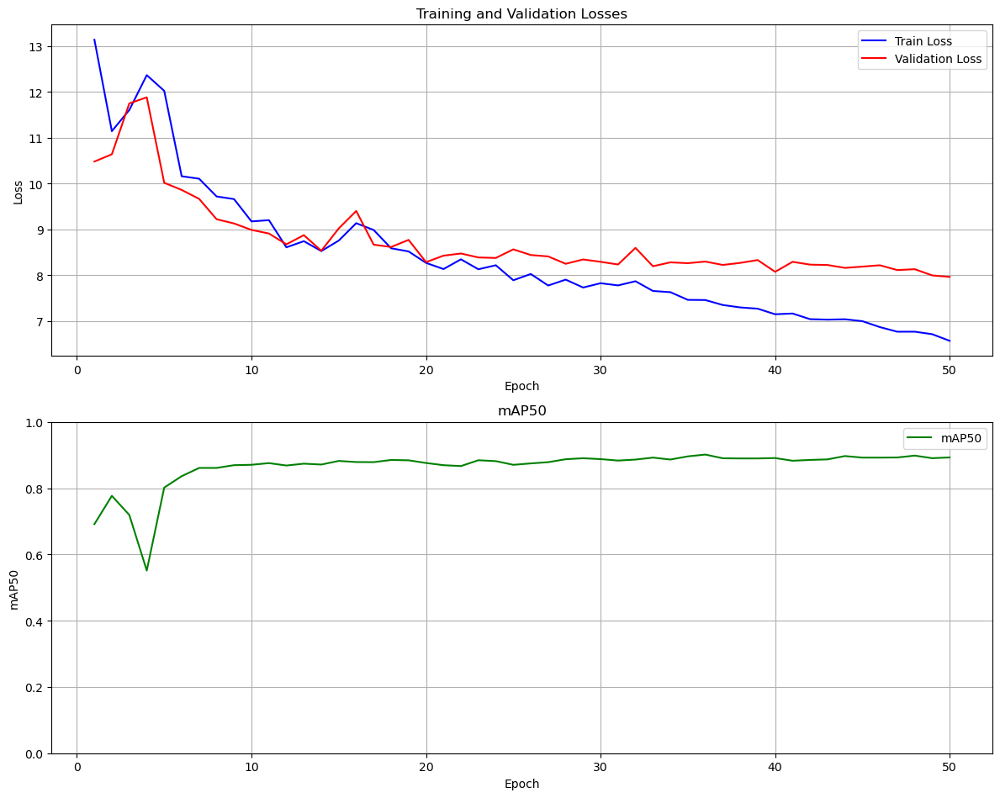

In [ ]:
### Plots
results_path = os.path.join(cwd, "yolo_football_analysis", "yolo9c_dataset_baseline_custom_focal_loss_increased_cls_weight", "results.csv")
data = pd.read_csv(results_path)
plot_metrics(data, cls_weight=4.0)

#### Quantitative test

In [ ]:
# Test the model on the test set
model = YOLO(r"yolo_football_analysis\yolo9c_dataset_baseline_custom_focal_loss_increased_cls_weight\weights\best.pt")
model = model.cuda()
model.val(data=os.path.join(dataset_path, "data.yaml"), split="test", project="yolo_football_test", name="yolo9c_dataset_baseline_custom_focal_loss_increased_cls_weight")

YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


val: Scanning C:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\dataset\v0\test\labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [01:03<00:00, 15.75s/it]


                   all         60       1452       0.97      0.871       0.91      0.661
                  ball         52         53      0.951      0.566      0.685      0.336
            goalkeeper         40         41      0.966      0.951      0.971       0.74
                player         60       1202      0.989      0.991      0.994      0.818
               referee         60        156      0.974      0.974       0.99       0.75
Speed: 2.3ms preprocess, 897.2ms inference, 0.0ms loss, 95.8ms postprocess per image
Results saved to yolo_football_test\yolo9c_custom_loss_no_cp


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001D408C0B0A0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

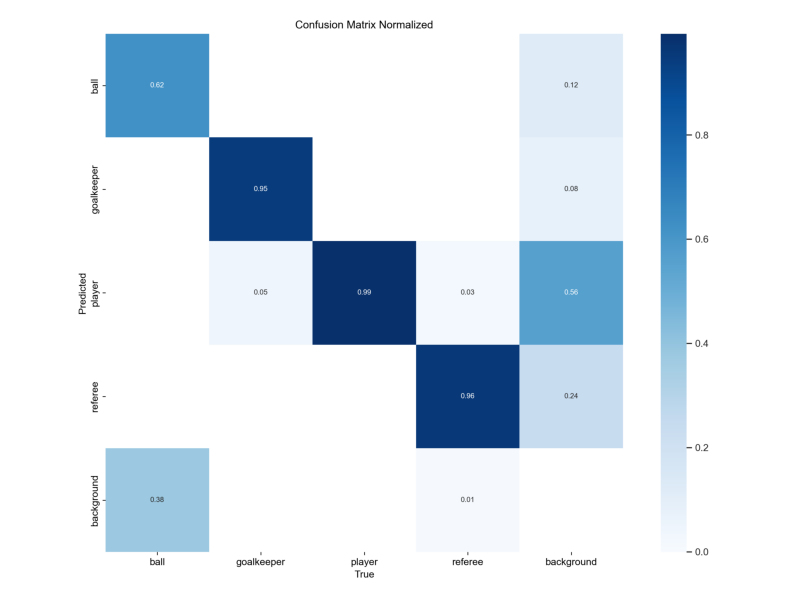

In [ ]:
# load and show confusion matrix
matrix_path = os.path.join(cwd, "yolo_football_test", "yolo9c_dataset_baseline_custom_focal_loss_increased_cls_weight", "confusion_matrix_normalized.png")
plot_confusion_matrix(matrix_path)


#### Qualitative Analysis on Challenging Samples

The qualitative analysis is based on three distinct samples:  
1. The first shows a stretched ball.  
2. The second features the ball under dim lighting conditions.  
3. The third depicts the ball partially occluded by a player.  

The purpose of this qualitative test is to assess the model’s performance under difficult conditions.


image 1/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\538438_1_10_png_jpg.rf.f0585e46a9ae3f1d0f64c24aaf7704b8.jpg: 736x1280 1 ball, 20 players, 2 referees, 110.7ms
image 2/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\Screenshot-2025-01-03-112748_png.rf.763a7d889601c8b79d673b84cdc4ae64.jpg: 736x1280 1 ball, 1 goalkeeper, 19 players, 2 referees, 68.9ms
image 3/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\c01561_1_6_png_jpg.rf.260b489d60904fa09f43dfb8daa38056.jpg: 736x1280 1 goalkeeper, 20 players, 2 referees, 68.5ms
Speed: 8.4ms preprocess, 82.7ms inference, 49.9ms postprocess per image at shape (1, 3, 736, 1280)


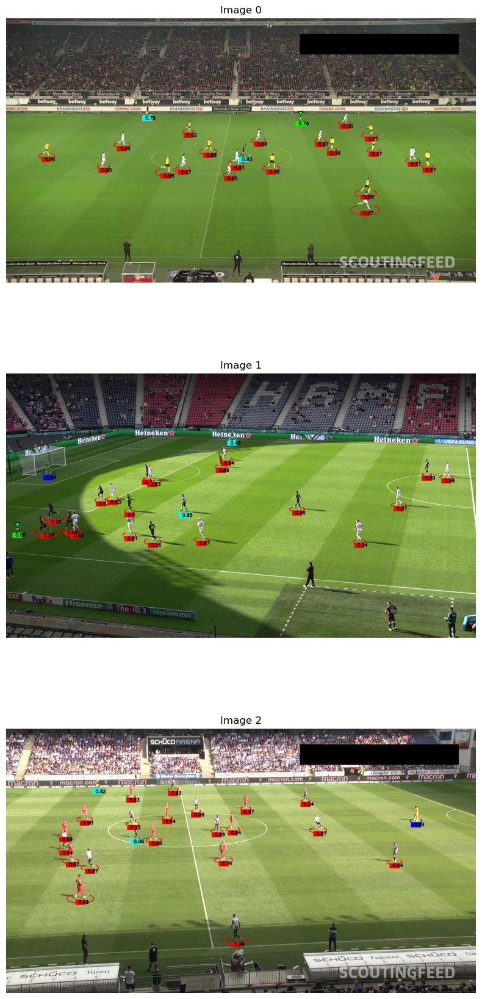

In [ ]:
detect_images(images_to_test_path, r"yolo_football_analysis\yolo9c_dataset_baseline_custom_focal_loss_increased_cls_weight\weights\best.pt")

Result: 
1. Detected with 0.74 confidence
2. Detected with 0.68 confidence
3. Undetected

# Finetuning

As the final step of our research, we investigated the influence of learning rate fine-tuning on model performance. This experiment was intentionally deferred to the end, since earlier phases involved a wide variety of models and training approaches, making stable hyperparameter tuning impractical.

We focused solely on the learning rate, since epochs were kept constants for all experiments while bath_size was constrained by GPU VRAM.
Two values were tested: **0.0001** (0.1× default) and **0.01** (10× default). The number of training epochs remained constant, and the batch size was limited by GPU memory constraints.

The fine-tuning was conducted on the **baseline dataset** using the best-performing configuration from our previous experiments — the model with **custom focal loss**. This setup allowed us to isolate the effect of learning rate variations and better understand their impact on both training stability and final accuracy.


## Learning Rate == 0.01

In [5]:
## Custom Focal Loss with bigger cls_weight
mp.freeze_support()  # Necessario su Windows
model = YOLO("yolov9c.pt")
model = model.cuda()
dataset_path = os.path.join(dataset_root_folder, "yolov9", "baseline")

In [ ]:
model.train(data=os.path.join(dataset_path, "data.yaml"), epochs=100, imgsz=1280, cls=4, lr0=0.01, optimizer="Adam", save=True, project="yolo_football_analysis", 
            name="yolo9c_dataset_baseline_custom_loss_increased_cls_weight_lr_0_01", batch=4)
wandb.finish()

New https://pypi.org/project/ultralytics/8.3.162 available  Update with 'pip install -U ultralytics'
engine\trainer: task=detect, mode=train, model=yolov9c.pt, data=c:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\code\training\..\..\dataset\v0\data.yaml, epochs=100, time=None, patience=100, batch=4, imgsz=1280, save=True, save_period=-1, cache=False, device=cuda:0, workers=8, project=yolo_football_analysis, name=yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_01_100ep, exist_ok=False, pretrained=True, optimizer=Adam, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, au

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: sianiemanuele (sianiemanuele_07) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed 


train: Scanning C:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\dataset\v0\train\labels.cache... 510 images, 0 backgrounds, 0 corrupt: 100%|██████████| 510/510 [00:00<?, ?it/s]
val: Scanning C:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\dataset\v0\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]


Plotting labels to yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_01_100ep\labels.jpg... 
optimizer: Adam(lr=0.01, momentum=0.937) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 1280 train, 1280 val
Using 8 dataloader workers
Logging results to yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_01_100ep
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/128 [00:00<?, ?it/s]

[INFO] Using Custom Focal Loss...............


      1/100      11.4G      1.456      2.053     0.9852         47       1280: 100%|██████████| 128/128 [32:54<00:00, 15.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/10 [00:00<?, ?it/s]

[INFO] Using Custom Focal Loss...............


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.47s/it]

                   all         75       1796      0.372     0.0314     0.0393     0.0224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      11.2G      1.543      0.942      1.028         76       1280: 100%|██████████| 128/128 [26:04<00:00, 12.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.56s/it]

                   all         75       1796     0.0707    0.00357     0.0357     0.0159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      11.3G      1.564     0.9339      1.024         43       1280: 100%|██████████| 128/128 [23:46<00:00, 11.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:07<00:00,  6.79s/it]

                   all         75       1796      0.456      0.213      0.224      0.099



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      11.4G      1.506     0.9199     0.9977         88       1280: 100%|██████████| 128/128 [24:30<00:00, 11.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:58<00:00,  5.88s/it]

                   all         75       1796      0.271        0.3      0.292       0.18



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      11.4G      1.363     0.8628     0.9562         87       1280: 100%|██████████| 128/128 [24:22<00:00, 11.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:08<00:00,  6.89s/it]

                   all         75       1796      0.466      0.213      0.228      0.148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      11.4G      1.274     0.8902     0.9578         98       1280: 100%|██████████| 128/128 [27:01<00:00, 12.67s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.98s/it]

                   all         75       1796      0.639      0.357      0.387      0.235



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      11.2G      1.183     0.7772     0.9304         51       1280: 100%|██████████| 128/128 [28:12<00:00, 13.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.33s/it]

                   all         75       1796      0.576       0.32      0.333      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      11.3G      1.159      0.707     0.9143        103       1280: 100%|██████████| 128/128 [26:16<00:00, 12.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.72s/it]

                   all         75       1796      0.906      0.355      0.395      0.255



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      11.4G      1.132     0.6875     0.9147         65       1280: 100%|██████████| 128/128 [24:49<00:00, 11.64s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.08s/it]

                   all         75       1796      0.929      0.409       0.55      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      11.4G      1.148      0.641     0.9065         96       1280: 100%|██████████| 128/128 [24:30<00:00, 11.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.55s/it]

                   all         75       1796      0.735      0.529      0.584      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      11.3G      1.059     0.5952     0.8969         69       1280: 100%|██████████| 128/128 [28:26<00:00, 13.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.17s/it]

                   all         75       1796      0.756      0.477      0.591      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      11.3G      1.031     0.5726     0.8854        114       1280: 100%|██████████| 128/128 [25:20<00:00, 11.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.03s/it]

                   all         75       1796      0.736      0.603      0.661      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      11.3G      1.089     0.6218     0.8901         91       1280: 100%|██████████| 128/128 [24:37<00:00, 11.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.42s/it]

                   all         75       1796      0.504      0.589      0.458      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      11.3G      1.029     0.5643     0.8855         97       1280: 100%|██████████| 128/128 [24:40<00:00, 11.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:02<00:00,  6.30s/it]

                   all         75       1796        0.8      0.621      0.741      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      11.4G      1.027     0.5332     0.8784         34       1280: 100%|██████████| 128/128 [25:25<00:00, 11.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:01<00:00,  6.18s/it]

                   all         75       1796      0.747      0.604      0.667       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      11.4G     0.9726     0.4984     0.8723        107       1280: 100%|██████████| 128/128 [25:49<00:00, 12.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.12s/it]

                   all         75       1796      0.789      0.637      0.738      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      11.4G     0.9907     0.4811      0.868        116       1280: 100%|██████████| 128/128 [25:17<00:00, 11.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:07<00:00,  6.70s/it]

                   all         75       1796      0.837      0.706      0.767      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      11.4G     0.9947     0.4811      0.875        129       1280: 100%|██████████| 128/128 [23:47<00:00, 11.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:56<00:00,  5.61s/it]

                   all         75       1796      0.748      0.693      0.717      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      11.2G      0.994     0.4821     0.8824         34       1280: 100%|██████████| 128/128 [26:53<00:00, 12.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.40s/it]

                   all         75       1796      0.845      0.689      0.782      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      11.3G     0.9653     0.4447     0.8676         44       1280: 100%|██████████| 128/128 [24:59<00:00, 11.71s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:58<00:00,  5.81s/it]

                   all         75       1796      0.885      0.576      0.773      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      11.3G     0.9451     0.4592     0.8647         83       1280: 100%|██████████| 128/128 [25:53<00:00, 12.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:56<00:00,  5.68s/it]

                   all         75       1796      0.923      0.632      0.804      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      11.3G     0.9845      0.446     0.8692         98       1280: 100%|██████████| 128/128 [24:53<00:00, 11.67s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.40s/it]

                   all         75       1796      0.896      0.597       0.74      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      11.3G     0.9839     0.4874     0.8728         30       1280: 100%|██████████| 128/128 [24:37<00:00, 11.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.71s/it]

                   all         75       1796      0.829      0.627      0.736       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      11.4G     0.9572     0.4448     0.8644         60       1280: 100%|██████████| 128/128 [26:28<00:00, 12.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:56<00:00,  5.62s/it]

                   all         75       1796       0.79      0.713      0.776      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      11.2G     0.9507     0.4368     0.8621         87       1280: 100%|██████████| 128/128 [26:37<00:00, 12.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.43s/it]

                   all         75       1796      0.833      0.684      0.788      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      11.2G     0.9319     0.4112      0.862         57       1280: 100%|██████████| 128/128 [26:05<00:00, 12.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:57<00:00,  5.79s/it]

                   all         75       1796      0.873      0.791      0.817      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      11.2G     0.9118     0.3958     0.8605         68       1280: 100%|██████████| 128/128 [25:39<00:00, 12.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:06<00:00,  6.62s/it]

                   all         75       1796      0.818      0.716       0.79      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      11.3G     0.9274     0.4239     0.8633         71       1280: 100%|██████████| 128/128 [23:58<00:00, 11.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.34s/it]

                   all         75       1796      0.815       0.76      0.793      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      11.3G     0.9547     0.4021      0.866         75       1280: 100%|██████████| 128/128 [24:39<00:00, 11.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.62s/it]

                   all         75       1796      0.803      0.694      0.779      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      11.3G     0.9417     0.4211     0.8636         59       1280: 100%|██████████| 128/128 [26:35<00:00, 12.46s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:01<00:00,  6.18s/it]

                   all         75       1796      0.913      0.624      0.815      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      11.4G     0.9263     0.3824     0.8566         72       1280: 100%|██████████| 128/128 [21:59<00:00, 10.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.06s/it]

                   all         75       1796      0.841      0.746      0.809      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      11.4G     0.9267     0.3871     0.8623         55       1280: 100%|██████████| 128/128 [27:21<00:00, 12.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.53s/it]

                   all         75       1796      0.837      0.747      0.788      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      11.3G     0.9282     0.3849     0.8629         60       1280: 100%|██████████| 128/128 [25:57<00:00, 12.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.82s/it]

                   all         75       1796      0.758      0.724      0.769      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      11.4G     0.9311     0.3863     0.8599         53       1280: 100%|██████████| 128/128 [25:51<00:00, 12.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.25s/it]

                   all         75       1796      0.835      0.752      0.814      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      11.4G     0.8892     0.3585     0.8545        101       1280: 100%|██████████| 128/128 [23:04<00:00, 10.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.57s/it]

                   all         75       1796      0.876       0.77      0.834      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      11.3G     0.8846     0.3585     0.8514         55       1280: 100%|██████████| 128/128 [25:01<00:00, 11.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:00<00:00,  6.05s/it]

                   all         75       1796      0.826      0.764      0.857      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      11.4G     0.8934     0.3637     0.8553        143       1280: 100%|██████████| 128/128 [25:09<00:00, 11.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.23s/it]

                   all         75       1796      0.893      0.774      0.838      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      11.3G     0.9035     0.3627     0.8541         42       1280: 100%|██████████| 128/128 [28:55<00:00, 13.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.93s/it]

                   all         75       1796       0.84      0.743      0.816      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      11.4G     0.9435      0.385     0.8571         87       1280: 100%|██████████| 128/128 [25:59<00:00, 12.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.31s/it]

                   all         75       1796      0.835      0.736      0.788      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      11.4G     0.9282      0.384     0.8558        178       1280: 100%|██████████| 128/128 [23:38<00:00, 11.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.12s/it]

                   all         75       1796      0.854      0.761      0.813      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      11.4G     0.9028     0.3839     0.8549         45       1280: 100%|██████████| 128/128 [27:00<00:00, 12.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.10s/it]

                   all         75       1796      0.812      0.712      0.791      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      11.4G     0.8954     0.3457     0.8517         99       1280: 100%|██████████| 128/128 [23:21<00:00, 10.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:56<00:00,  5.66s/it]

                   all         75       1796      0.862      0.775      0.822      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      11.4G     0.8905      0.341     0.8498         42       1280: 100%|██████████| 128/128 [25:58<00:00, 12.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.70s/it]

                   all         75       1796      0.881      0.771      0.839      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      11.3G     0.8559     0.3354     0.8463         91       1280: 100%|██████████| 128/128 [28:13<00:00, 13.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.48s/it]

                   all         75       1796      0.883       0.76       0.84      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      11.4G      0.876     0.3296     0.8518         78       1280: 100%|██████████| 128/128 [24:45<00:00, 11.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.44s/it]

                   all         75       1796      0.832      0.762      0.806      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      11.4G      0.872      0.332     0.8477         71       1280: 100%|██████████| 128/128 [26:51<00:00, 12.59s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:07<00:00,  6.77s/it]

                   all         75       1796      0.828       0.77      0.815      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      11.2G      0.854     0.3252     0.8505         41       1280: 100%|██████████| 128/128 [24:52<00:00, 11.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.76s/it]

                   all         75       1796      0.891      0.786      0.841      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      11.3G     0.8835     0.3294      0.853         81       1280: 100%|██████████| 128/128 [23:48<00:00, 11.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.69s/it]

                   all         75       1796      0.932      0.765       0.84      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      11.4G     0.8743     0.3145     0.8523         85       1280: 100%|██████████| 128/128 [23:42<00:00, 11.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.53s/it]

                   all         75       1796      0.831      0.804      0.851      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      11.4G     0.8742     0.3165     0.8491        102       1280: 100%|██████████| 128/128 [23:46<00:00, 11.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:07<00:00,  6.76s/it]

                   all         75       1796      0.857      0.781      0.836      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      11.3G     0.8748      0.332     0.8438        117       1280: 100%|██████████| 128/128 [27:16<00:00, 12.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:13<00:00,  7.30s/it]

                   all         75       1796      0.834      0.817       0.84      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      11.3G     0.8487     0.3099      0.848         53       1280: 100%|██████████| 128/128 [25:31<00:00, 11.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.58s/it]

                   all         75       1796      0.853      0.803      0.833      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      11.3G     0.8911      0.334      0.847         54       1280: 100%|██████████| 128/128 [27:38<00:00, 12.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:01<00:00,  6.20s/it]

                   all         75       1796      0.859      0.775      0.826      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      11.3G     0.8428      0.303     0.8419         68       1280: 100%|██████████| 128/128 [26:13<00:00, 12.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.23s/it]

                   all         75       1796      0.887      0.795      0.834       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      11.3G     0.8451     0.3061      0.845        103       1280: 100%|██████████| 128/128 [25:40<00:00, 12.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.07s/it]

                   all         75       1796      0.902      0.817      0.849       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      11.3G     0.8734     0.3242     0.8526         70       1280: 100%|██████████| 128/128 [28:44<00:00, 13.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:56<00:00,  5.64s/it]

                   all         75       1796      0.881      0.768      0.822      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      11.3G     0.8395     0.3099     0.8443         72       1280: 100%|██████████| 128/128 [27:34<00:00, 12.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.60s/it]

                   all         75       1796       0.75      0.804       0.82      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      11.4G     0.8613     0.3099      0.844         64       1280: 100%|██████████| 128/128 [21:27<00:00, 10.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.43s/it]

                   all         75       1796      0.904      0.789      0.842      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      11.4G     0.8447     0.2959     0.8429        124       1280: 100%|██████████| 128/128 [25:03<00:00, 11.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.44s/it]

                   all         75       1796      0.887      0.813      0.847      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      11.4G     0.8549     0.3004     0.8396         56       1280: 100%|██████████| 128/128 [29:45<00:00, 13.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:12<00:00,  7.24s/it]

                   all         75       1796      0.909      0.791      0.842      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      11.3G     0.8379     0.2825     0.8407         59       1280: 100%|██████████| 128/128 [27:41<00:00, 12.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:58<00:00,  5.85s/it]

                   all         75       1796      0.902      0.821       0.85      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      11.3G     0.8108     0.2741     0.8364        102       1280: 100%|██████████| 128/128 [26:42<00:00, 12.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.43s/it]

                   all         75       1796      0.925      0.794      0.839      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      11.4G     0.8295     0.2779     0.8383        120       1280: 100%|██████████| 128/128 [25:05<00:00, 11.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:05<00:00,  6.56s/it]

                   all         75       1796      0.904      0.799       0.84      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      11.4G     0.8251     0.2674     0.8384         69       1280: 100%|██████████| 128/128 [26:33<00:00, 12.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.38s/it]

                   all         75       1796      0.895      0.823      0.862      0.588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      11.4G     0.8166     0.2699     0.8395         38       1280: 100%|██████████| 128/128 [23:21<00:00, 10.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.50s/it]

                   all         75       1796      0.884      0.785      0.846      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      11.3G      0.841      0.278     0.8403         73       1280: 100%|██████████| 128/128 [27:27<00:00, 12.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.38s/it]

                   all         75       1796      0.934      0.748      0.825      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      11.3G     0.8293     0.2656      0.838         91       1280: 100%|██████████| 128/128 [26:41<00:00, 12.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.24s/it]

                   all         75       1796      0.904      0.818      0.849      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      11.3G     0.8017      0.259     0.8316        107       1280: 100%|██████████| 128/128 [30:03<00:00, 14.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.28s/it]

                   all         75       1796      0.929      0.796      0.844      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      11.3G     0.8232     0.2709     0.8365        129       1280: 100%|██████████| 128/128 [25:09<00:00, 11.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.94s/it]

                   all         75       1796      0.847      0.798       0.84      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      11.3G     0.8485     0.2703     0.8416         68       1280: 100%|██████████| 128/128 [25:11<00:00, 11.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.65s/it]

                   all         75       1796        0.9      0.807      0.841      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      11.3G     0.8242     0.2712     0.8409        140       1280: 100%|██████████| 128/128 [26:00<00:00, 12.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.30s/it]

                   all         75       1796      0.894      0.824       0.85      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      11.3G     0.8059     0.2584     0.8358         68       1280: 100%|██████████| 128/128 [25:35<00:00, 11.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.55s/it]

                   all         75       1796      0.874      0.819      0.845      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      11.4G     0.7915     0.2495     0.8322         63       1280: 100%|██████████| 128/128 [22:23<00:00, 10.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.08s/it]

                   all         75       1796      0.817       0.76      0.803      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      11.3G     0.7899     0.2426     0.8292        139       1280: 100%|██████████| 128/128 [24:51<00:00, 11.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.04s/it]

                   all         75       1796      0.891      0.803      0.853      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      11.4G     0.7953     0.2437     0.8292         94       1280: 100%|██████████| 128/128 [25:54<00:00, 12.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.46s/it]

                   all         75       1796      0.862      0.812      0.859      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      11.3G     0.7952     0.2408     0.8334        133       1280: 100%|██████████| 128/128 [24:03<00:00, 11.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.88s/it]

                   all         75       1796      0.873      0.825      0.866      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      11.3G     0.7891      0.243     0.8305         53       1280: 100%|██████████| 128/128 [24:34<00:00, 11.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.82s/it]

                   all         75       1796      0.934      0.839      0.871      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      11.4G     0.7983     0.2399      0.836         98       1280: 100%|██████████| 128/128 [29:53<00:00, 14.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:11<00:00,  7.18s/it]

                   all         75       1796      0.938      0.836      0.855       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      11.3G     0.8049     0.2377      0.832         82       1280: 100%|██████████| 128/128 [27:07<00:00, 12.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:11<00:00,  7.16s/it]

                   all         75       1796       0.89      0.827      0.868      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      11.2G     0.7912     0.2429     0.8276         87       1280: 100%|██████████| 128/128 [28:21<00:00, 13.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.59s/it]

                   all         75       1796      0.865      0.838      0.846      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      11.3G     0.8091     0.2547     0.8345        108       1280: 100%|██████████| 128/128 [26:39<00:00, 12.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.45s/it]

                   all         75       1796      0.884        0.8      0.852      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      11.2G     0.7769     0.2344     0.8298         94       1280: 100%|██████████| 128/128 [28:08<00:00, 13.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.45s/it]

                   all         75       1796      0.905      0.828      0.856      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      11.3G     0.7783     0.2257      0.829        123       1280: 100%|██████████| 128/128 [25:34<00:00, 11.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.49s/it]

                   all         75       1796      0.908      0.816      0.849      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      11.4G     0.7809     0.2249     0.8274         66       1280: 100%|██████████| 128/128 [23:45<00:00, 11.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.77s/it]

                   all         75       1796       0.92      0.829      0.858       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      11.4G      0.784     0.2178     0.8288         72       1280: 100%|██████████| 128/128 [24:49<00:00, 11.64s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.84s/it]

                   all         75       1796      0.921      0.812       0.86      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      11.4G     0.7822     0.2225     0.8273         55       1280: 100%|██████████| 128/128 [24:55<00:00, 11.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:07<00:00,  6.73s/it]

                   all         75       1796      0.877      0.819      0.848      0.576



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      11.4G     0.7705     0.2246     0.8287         48       1280: 100%|██████████| 128/128 [25:36<00:00, 12.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.02s/it]

                   all         75       1796      0.912      0.847      0.856      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      11.4G     0.7626      0.217     0.8275         64       1280: 100%|██████████| 128/128 [26:31<00:00, 12.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.40s/it]

                   all         75       1796      0.881      0.848      0.873      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      11.4G     0.7496     0.2094     0.8222         45       1280: 100%|██████████| 128/128 [21:52<00:00, 10.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.83s/it]

                   all         75       1796      0.945      0.836      0.875       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      11.3G     0.7532     0.2098     0.8276         92       1280: 100%|██████████| 128/128 [24:00<00:00, 11.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.69s/it]

                   all         75       1796       0.92      0.826      0.864      0.583


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      10.8G      0.738     0.2009      0.827         44       1280: 100%|██████████| 128/128 [28:39<00:00, 13.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.34s/it]

                   all         75       1796      0.923      0.839      0.871      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      10.8G     0.7414     0.2012     0.8277         46       1280: 100%|██████████| 128/128 [30:22<00:00, 14.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.08s/it]

                   all         75       1796      0.891      0.835      0.863      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      10.9G      0.738      0.198     0.8296         49       1280: 100%|██████████| 128/128 [29:13<00:00, 13.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.14s/it]

                   all         75       1796      0.915      0.833      0.863       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      6.33G      0.735      0.194     0.8274         47       1280: 100%|██████████| 128/128 [27:05<00:00, 12.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:19<00:00,  1.92s/it]

                   all         75       1796       0.91      0.833      0.873      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      10.9G     0.7315     0.1922     0.8272         49       1280: 100%|██████████| 128/128 [27:03<00:00, 12.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:02<00:00,  6.21s/it]

                   all         75       1796      0.936      0.833      0.876      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      6.49G     0.7256     0.1845     0.8276         49       1280: 100%|██████████| 128/128 [24:45<00:00, 11.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:26<00:00,  2.64s/it]

                   all         75       1796      0.941      0.847      0.876      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      6.18G     0.7319      0.187     0.8291         48       1280: 100%|██████████| 128/128 [25:50<00:00, 12.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:20<00:00,  2.07s/it]

                   all         75       1796      0.921      0.828      0.866      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      10.9G     0.7226     0.1887      0.825         47       1280: 100%|██████████| 128/128 [28:40<00:00, 13.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.12s/it]

                   all         75       1796      0.923      0.837      0.873      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      10.8G     0.7159      0.179     0.8253         48       1280: 100%|██████████| 128/128 [31:30<00:00, 14.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.44s/it]

                   all         75       1796      0.942      0.849      0.878      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      10.8G     0.7118     0.1784     0.8273         41       1280: 100%|██████████| 128/128 [31:26<00:00, 14.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.28s/it]

                   all         75       1796      0.947       0.85      0.878        0.6



100 epochs completed in 44.973 hours.
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_01_100ep\weights\last.pt, 51.7MB
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_01_100ep\weights\best.pt, 51.7MB

Validating yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_01_100ep\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:19<00:00,  1.94s/it]


                   all         75       1796      0.947       0.85      0.878      0.599
                  ball         73         73          1      0.512      0.623      0.255
            goalkeeper         50         50      0.851       0.92      0.906      0.654
                player         75       1493      0.979      0.991      0.993       0.78
               referee         75        180      0.958      0.978       0.99      0.708
Speed: 1.0ms preprocess, 182.6ms inference, 0.0ms loss, 63.4ms postprocess per image
Results saved to yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_01_100ep


wandb: Network error (ConnectionError), entering retry loop.
wandb: Network error (ConnectionError), entering retry loop.
wandb: Network error (ConnectionError), entering retry loop.
wandb: Network error (ConnectionError), entering retry loop.
wandb: Network error (ConnectionError), entering retry loop.


lr/pg0,█▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁
lr/pg1,███▇▇▇▇▇▇▇▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▁▁▁▁
lr/pg2,▆████▇▇▇▇▇▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▂▂▁▁
metrics/mAP50(B),▁▁▃▃▄▆▇▇▇▇▇▇▇█▇▇████████████████████████
metrics/mAP50-95(B),▁▂▅▆▆▆▇▆▇▇▇▇▇▇▇█▇█▇██▇▇█████████████████
metrics/precision(B),▃▁▄▅█▆▆▇▆█▇▇▇▇▇▇▇▇█▇▇▇████▇█▇███████████
metrics/recall(B),▁▃▃▄▄▅▆▆▆▇▇▆▆▇▇▇▇▇▇▇██████▇█████████████
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,██▇▅▄▄▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁


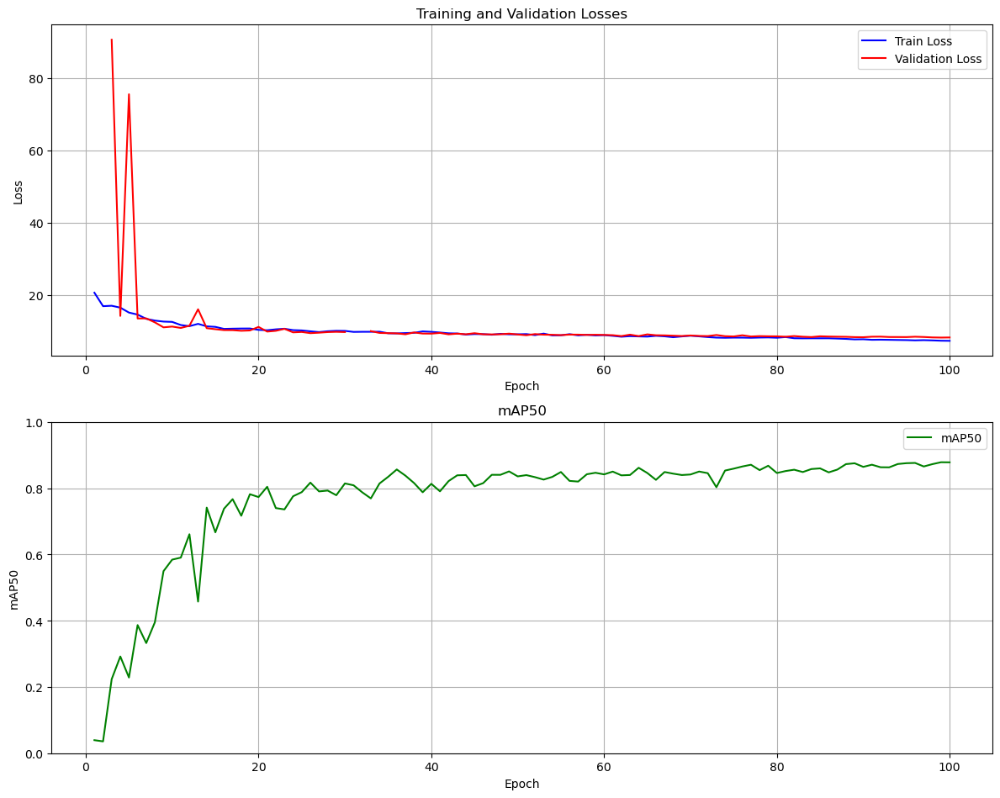

In [ ]:
# Plots
results_path = os.path.join(cwd, "yolo_football_analysis", "yolo9c_dataset_baseline_custom_loss_increased_cls_weight_lr_0_01", "results.csv")
data = pd.read_csv(results_path)
plot_metrics(data, cls_weight=4.0)

**N.B**: The greater learning rate brought to instability during train in terms of loss.
cutting after sixth epoch....


In [10]:
def truncated_plot_metrics(data, figsize=(12, 10), cls_weight=0.5, box_weight=7.5, dfl_weight=1.5, starting_epoch=4):
    """
    Funzione per creare un plot delle perdite (Losses) di training e validazione su una griglia 2x2.

    Args:
        data (DataFrame): Pandas dataframe
        figsize (tuple): Figure size (width, height).
        cls_weight (float): Weight for classification loss.
        box_weight (float): Weight for box loss.
        dfl_weight (float): Weight for distribution focal loss.
        starting_epoch (int): Epoch from which to start plotting.
    """
    # Graphs configuration
    
    # Truncate the data to start from the specified epoch
    data = data[data['epoch'] >= starting_epoch]

    train_loss = box_weight * data['train/box_loss'] + cls_weight * data['train/cls_loss'] + dfl_weight * data['train/dfl_loss']
    val_loss = box_weight * data['val/box_loss'] + cls_weight * data['val/cls_loss'] + dfl_weight * data['val/dfl_loss']
    map50 = data['metrics/mAP50(B)']

    fig, axes = plt.subplots(2, 1, figsize=figsize)

    # Plot training and validation losses
    axes[0].plot(data['epoch'], train_loss, label='Train Loss', color='blue')
    axes[0].plot(data['epoch'], val_loss, label='Validation Loss', color='red')
    axes[0].set_title('Training and Validation Losses')
    axes[0].set_xlabel('Epoch')
    axes[0].set_ylabel('Loss')
    axes[0].legend()
    axes[0].grid(True)
    
    # Plot mAP50
    axes[1].plot(data['epoch'], map50, label='mAP50', color='green')
    axes[1].set_title('mAP50')
    axes[1].set_xlabel('Epoch')
    axes[1].set_ylabel('mAP50')
    axes[1].legend()
    axes[1].grid(True)
    axes[1].set_ylim(0, 1)  


    # Layout
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

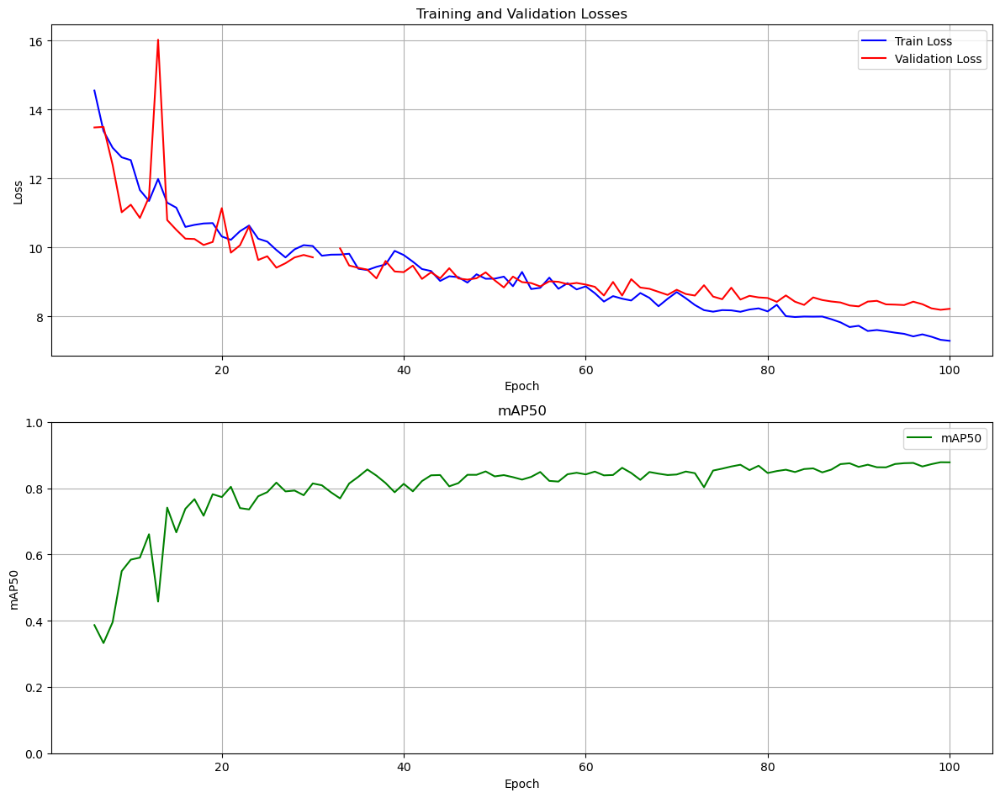

In [ ]:
truncated_plot_metrics(data, cls_weight=4.0, starting_epoch=6)

### Quantitative Test

In [6]:
model = YOLO(r"yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_increased_cls_weight_lr_0_01\weights\best.pt")
model = model.cuda()
model.val(data=os.path.join(dataset_path, "data.yaml"), split="test", project="yolo_football_test", name="yolo9c_dataset_baseline_custom_loss_increased_cls_weight_lr_0_01")

YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


val: Scanning C:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\dataset\yolov9\baseline\test\labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:37<00:00,  9.41s/it]


                   all         60       1452      0.899      0.856      0.859       0.62
                  ball         52         53      0.807      0.528      0.494      0.207
            goalkeeper         40         41      0.897      0.951      0.968      0.734
                player         60       1202      0.978      0.991      0.994      0.804
               referee         60        156      0.915      0.955      0.981      0.734
Speed: 8.8ms preprocess, 368.2ms inference, 0.0ms loss, 75.3ms postprocess per image
Results saved to yolo_football_test\yolo9c_dataset_baseline_custom_loss_increased_cls_weight_lr_0_01


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001FD767FD8D0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

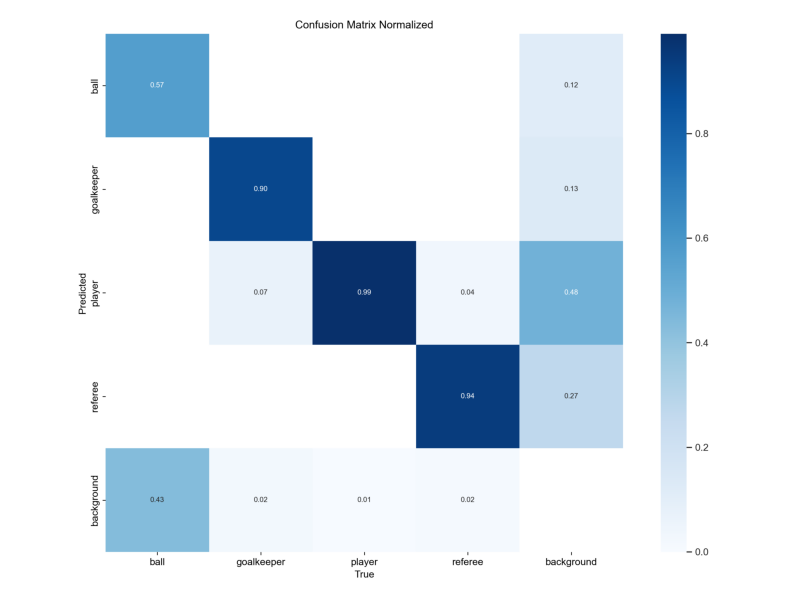

In [7]:
# load and show confusion matrix
matrix_path = os.path.join(cwd, "yolo_football_test", "yolo9c_dataset_baseline_custom_loss_increased_cls_weight_lr_0_01", "confusion_matrix_normalized.png")
plot_confusion_matrix(matrix_path)


### Qualitative Analysis on Challenging Samples

The qualitative analysis is based on three distinct samples:  
1. The first shows a stretched ball.  
2. The second features the ball under dim lighting conditions.  
3. The third depicts the ball partially occluded by a player.  

The purpose of this qualitative test is to assess the model’s performance under difficult conditions.



image 1/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\538438_1_10_png_jpg.rf.f0585e46a9ae3f1d0f64c24aaf7704b8.jpg: 736x1280 1 ball, 20 players, 2 referees, 679.8ms
image 2/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\Screenshot-2025-01-03-112748_png.rf.763a7d889601c8b79d673b84cdc4ae64.jpg: 736x1280 1 ball, 1 goalkeeper, 22 players, 2 referees, 474.9ms
image 3/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\c01561_1_6_png_jpg.rf.260b489d60904fa09f43dfb8daa38056.jpg: 736x1280 1 goalkeeper, 20 players, 2 referees, 483.6ms
Speed: 19.7ms preprocess, 546.1ms inference, 34.2ms postprocess per image at shape (1, 3, 736, 1280)


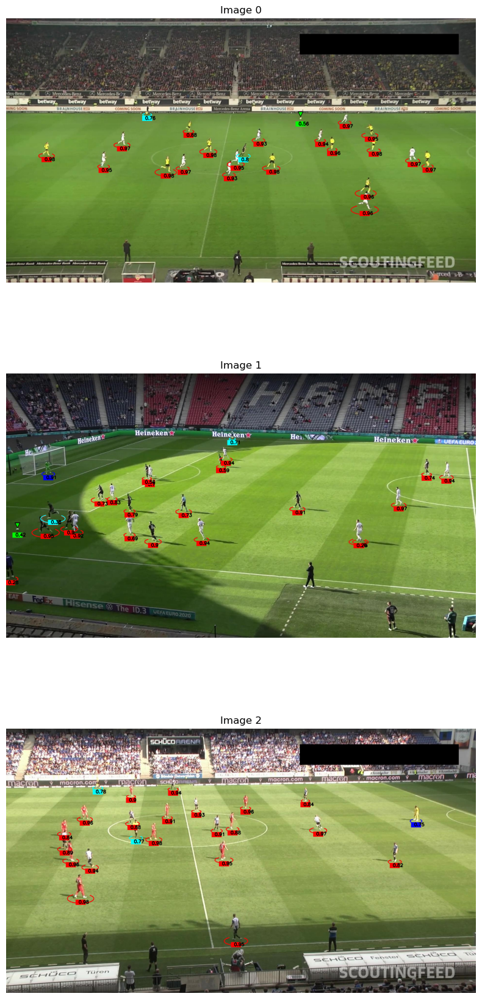

In [8]:
detect_images(images_to_test_path, r"yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_increased_cls_weight_lr_0_01\weights\best.pt")

Result: 
1. Detected with 0.56 confidence
2. Detected with 0.42 confidence
3. Undetected

## Learning Rate == 0.001

This section contains the code for training and evaluation on the model with custom focal loss using the augmented dataset and a weight for the class loss of 4 instead of 0.5 and a learning rate equal to 0.0001

In [ ]:
mp.freeze_support()  # Necessario su Windows
model = YOLO("yolov9c.pt")
model = model.cuda()
dataset_path = os.path.join(dataset_root_folder, "yolov9", "baseline")
model.train(data=os.path.join(dataset_path, "data.yaml"), epochs=50, imgsz=1280, cls=4, optimizer="Adam", lr0=0.0001, save=True, project="yolo_football_analysis", 
            name="yolo9c_dataset_baseline_custom_loss_increased_cls_weight_lr_0_0001", batch=4)
wandb.finish()

New https://pypi.org/project/ultralytics/8.3.162 available  Update with 'pip install -U ultralytics'
engine\trainer: task=detect, mode=train, model=yolov9c.pt, data=c:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\code\training\..\..\dataset\v0\data.yaml, epochs=50, time=None, patience=100, batch=4, imgsz=1280, save=True, save_period=-1, cache=False, device=cuda:0, workers=8, project=yolo_football_analysis, name=yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_0001, exist_ok=False, pretrained=True, optimizer=Adam, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: sianiemanuele (sianiemanuele_07) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed 


train: Scanning C:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\dataset\v0\train\labels.cache... 510 images, 0 backgrounds, 0 corrupt: 100%|██████████| 510/510 [00:00<?, ?it/s]
val: Scanning C:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\dataset\v0\valid\labels.cache... 75 images, 0 backgrounds, 0 corrupt: 100%|██████████| 75/75 [00:00<?, ?it/s]


Plotting labels to yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_0001\labels.jpg... 
optimizer: Adam(lr=0.0001, momentum=0.937) with parameter groups 154 weight(decay=0.0), 161 weight(decay=0.0005), 160 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 1280 train, 1280 val
Using 8 dataloader workers
Logging results to yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_0001
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/128 [00:00<?, ?it/s]

[INFO] Using Custom Focal Loss...............


       1/50      11.3G      0.955     0.9007     0.8596         47       1280: 100%|██████████| 128/128 [31:19<00:00, 14.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/10 [00:00<?, ?it/s]

[INFO] Using Custom Focal Loss...............


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:02<00:00,  6.25s/it]

                   all         75       1796      0.814      0.542      0.609      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      11.1G     0.8763      0.424     0.8494         76       1280: 100%|██████████| 128/128 [26:06<00:00, 12.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:58<00:00,  5.88s/it]

                   all         75       1796      0.834      0.714      0.779        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      11.2G     0.8393     0.3517     0.8441         43       1280: 100%|██████████| 128/128 [27:20<00:00, 12.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:05<00:00,  6.50s/it]

                   all         75       1796      0.842      0.787      0.838      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      11.3G       0.82     0.3043     0.8342         88       1280: 100%|██████████| 128/128 [25:15<00:00, 11.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:55<00:00,  5.56s/it]

                   all         75       1796      0.857      0.821      0.852      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      11.3G     0.8185     0.2987     0.8335         87       1280: 100%|██████████| 128/128 [24:00<00:00, 11.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.26s/it]

                   all         75       1796      0.913      0.803      0.859      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      11.3G     0.7924     0.2653     0.8329         98       1280: 100%|██████████| 128/128 [25:46<00:00, 12.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.45s/it]

                   all         75       1796      0.902      0.821      0.865       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      11.1G     0.7905     0.2538     0.8332         51       1280: 100%|██████████| 128/128 [23:15<00:00, 10.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.40s/it]

                   all         75       1796      0.931      0.793      0.869       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      11.2G     0.7882     0.2469     0.8271        103       1280: 100%|██████████| 128/128 [27:14<00:00, 12.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:46<00:00,  4.69s/it]

                   all         75       1796      0.942      0.815      0.873      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      11.3G     0.7801     0.2402     0.8303         65       1280: 100%|██████████| 128/128 [26:28<00:00, 12.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.79s/it]

                   all         75       1796      0.934      0.822      0.869      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      11.3G     0.7795     0.2334     0.8222         96       1280: 100%|██████████| 128/128 [25:25<00:00, 11.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.48s/it]

                   all         75       1796      0.929      0.837      0.878      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      11.2G     0.7611     0.2211      0.826         69       1280: 100%|██████████| 128/128 [25:10<00:00, 11.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:42<00:00,  4.30s/it]

                   all         75       1796      0.924      0.832      0.868      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      11.2G     0.7498     0.2258     0.8225        114       1280: 100%|██████████| 128/128 [25:08<00:00, 11.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:39<00:00,  3.99s/it]

                   all         75       1796      0.919      0.837      0.879      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      11.2G     0.7639     0.2147     0.8235         91       1280: 100%|██████████| 128/128 [25:03<00:00, 11.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.11s/it]

                   all         75       1796      0.898      0.853      0.891       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      11.2G     0.7352     0.2051     0.8208         97       1280: 100%|██████████| 128/128 [24:09<00:00, 11.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:10<00:00,  7.04s/it]

                   all         75       1796      0.885      0.848      0.877        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      11.3G     0.7484     0.2074     0.8209         34       1280: 100%|██████████| 128/128 [27:04<00:00, 12.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:02<00:00,  6.30s/it]

                   all         75       1796      0.909      0.844      0.886       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      11.3G     0.7421     0.2013     0.8227        107       1280: 100%|██████████| 128/128 [22:29<00:00, 10.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:56<00:00,  5.68s/it]

                   all         75       1796      0.903      0.866      0.885      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      11.3G     0.7336     0.1978     0.8173        116       1280: 100%|██████████| 128/128 [26:07<00:00, 12.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.74s/it]

                   all         75       1796      0.899      0.872      0.888      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      11.3G     0.7426     0.1968     0.8231        129       1280: 100%|██████████| 128/128 [23:57<00:00, 11.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.84s/it]

                   all         75       1796      0.915      0.844      0.875      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      11.1G     0.7499     0.2005     0.8259         34       1280: 100%|██████████| 128/128 [26:26<00:00, 12.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.35s/it]

                   all         75       1796      0.914      0.865      0.892      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      11.2G     0.7336     0.1861     0.8177         44       1280: 100%|██████████| 128/128 [27:31<00:00, 12.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:54<00:00,  5.45s/it]

                   all         75       1796      0.883      0.876       0.89       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      11.2G     0.7095     0.1751     0.8154         83       1280: 100%|██████████| 128/128 [25:06<00:00, 11.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:50<00:00,  5.02s/it]

                   all         75       1796      0.889      0.849      0.881      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      11.2G     0.7204     0.1773     0.8173         98       1280: 100%|██████████| 128/128 [23:58<00:00, 11.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.56s/it]

                   all         75       1796      0.887      0.856       0.89      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      11.2G     0.7207     0.1749     0.8169         30       1280: 100%|██████████| 128/128 [23:44<00:00, 11.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:48<00:00,  4.85s/it]

                   all         75       1796      0.911      0.856      0.888      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      11.3G      0.729     0.1812      0.817         60       1280: 100%|██████████| 128/128 [24:30<00:00, 11.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:44<00:00,  4.50s/it]

                   all         75       1796      0.902      0.871        0.9      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      11.1G      0.711      0.178     0.8138         87       1280: 100%|██████████| 128/128 [26:07<00:00, 12.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.19s/it]

                   all         75       1796      0.932      0.846      0.892      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      11.1G     0.7199     0.1715     0.8191         57       1280: 100%|██████████| 128/128 [28:37<00:00, 13.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.49s/it]

                   all         75       1796      0.925      0.858      0.893      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      11.2G     0.6975     0.1613      0.815         68       1280: 100%|██████████| 128/128 [23:31<00:00, 11.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:10<00:00,  7.04s/it]

                   all         75       1796      0.917      0.863      0.891      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      11.2G     0.6996      0.162     0.8178         71       1280: 100%|██████████| 128/128 [24:07<00:00, 11.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:07<00:00,  6.76s/it]

                   all         75       1796      0.921      0.878      0.891      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      11.2G     0.6959      0.162     0.8144         75       1280: 100%|██████████| 128/128 [22:24<00:00, 10.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.11s/it]

                   all         75       1796       0.89      0.864      0.886      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      11.2G     0.6959     0.1601     0.8134         59       1280: 100%|██████████| 128/128 [27:41<00:00, 12.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:08<00:00,  6.90s/it]

                   all         75       1796      0.888      0.863      0.885      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      11.3G     0.6933     0.1556     0.8132         72       1280: 100%|██████████| 128/128 [20:40<00:00,  9.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  5.00s/it]

                   all         75       1796      0.899      0.852       0.89      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      11.3G     0.6986     0.1574     0.8157         55       1280: 100%|██████████| 128/128 [27:14<00:00, 12.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.15s/it]

                   all         75       1796      0.895      0.861      0.891      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      11.2G     0.6865     0.1528     0.8118         60       1280: 100%|██████████| 128/128 [26:39<00:00, 12.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:53<00:00,  5.33s/it]

                   all         75       1796      0.901      0.856      0.884      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      11.3G     0.6985     0.1546     0.8148         53       1280: 100%|██████████| 128/128 [26:16<00:00, 12.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:51<00:00,  5.14s/it]

                   all         75       1796      0.926      0.862      0.896      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      11.3G     0.6836      0.149      0.812        101       1280: 100%|██████████| 128/128 [24:40<00:00, 11.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:39<00:00,  3.93s/it]

                   all         75       1796      0.899      0.882      0.898      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      11.2G     0.6825     0.1527     0.8121         55       1280: 100%|██████████| 128/128 [26:09<00:00, 12.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.28s/it]

                   all         75       1796      0.892      0.877      0.896      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      11.3G     0.6699     0.1456     0.8114        143       1280: 100%|██████████| 128/128 [25:46<00:00, 12.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:49<00:00,  4.94s/it]

                   all         75       1796      0.908      0.871      0.893      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      11.2G     0.6688     0.1439     0.8085         42       1280: 100%|██████████| 128/128 [25:26<00:00, 11.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.59s/it]

                   all         75       1796      0.901      0.875      0.899      0.626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      11.3G     0.6647     0.1464     0.8083         87       1280: 100%|██████████| 128/128 [22:49<00:00, 10.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.12s/it]

                   all         75       1796      0.907      0.851      0.893      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      11.3G     0.6574     0.1367      0.808        178       1280: 100%|██████████| 128/128 [25:54<00:00, 12.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:45<00:00,  4.60s/it]

                   all         75       1796      0.904      0.864      0.895       0.62


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      11.1G      0.656     0.1331     0.8116         48       1280: 100%|██████████| 128/128 [24:15<00:00, 11.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:04<00:00,  6.47s/it]

                   all         75       1796      0.888      0.868      0.891      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      11.1G     0.6528     0.1257     0.8122         46       1280: 100%|██████████| 128/128 [27:02<00:00, 12.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:41<00:00,  4.13s/it]

                   all         75       1796      0.906      0.874      0.895      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.44G     0.6515     0.1275     0.8088         49       1280: 100%|██████████| 128/128 [26:08<00:00, 12.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:14<00:00,  1.49s/it]

                   all         75       1796      0.898      0.886        0.9      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      11.1G     0.6485     0.1246      0.808         46       1280: 100%|██████████| 128/128 [26:34<00:00, 12.46s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:38<00:00,  3.89s/it]

                   all         75       1796       0.92      0.869      0.898      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      11.1G     0.6411     0.1169     0.8129         44       1280: 100%|██████████| 128/128 [23:49<00:00, 11.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:52<00:00,  5.27s/it]

                   all         75       1796      0.921      0.883      0.907      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.46G     0.6382     0.1201     0.8099         48       1280: 100%|██████████| 128/128 [28:51<00:00, 13.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:21<00:00,  2.18s/it]

                   all         75       1796      0.915      0.882      0.905      0.627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.38G      0.629     0.1191     0.8071         46       1280: 100%|██████████| 128/128 [24:53<00:00, 11.67s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:09<00:00,  1.01it/s]

                   all         75       1796      0.912      0.887      0.906      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      11.1G     0.6298     0.1174     0.8068         48       1280: 100%|██████████| 128/128 [26:30<00:00, 12.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:36<00:00,  3.66s/it]

                   all         75       1796      0.913      0.886      0.906      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      11.1G     0.6289     0.1165     0.8084         49       1280: 100%|██████████| 128/128 [21:51<00:00, 10.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:47<00:00,  4.71s/it]

                   all         75       1796       0.91       0.88      0.909      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      11.1G     0.6254     0.1134     0.8088         47       1280: 100%|██████████| 128/128 [23:52<00:00, 11.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:57<00:00,  5.70s/it]

                   all         75       1796      0.901       0.89      0.903      0.627



50 epochs completed in 21.911 hours.
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_0001\weights\last.pt, 51.7MB
Optimizer stripped from yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_0001\weights\best.pt, 51.7MB

Validating yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_0001\weights\best.pt...
Ultralytics 8.3.31  Python-3.10.0 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:14<00:00,  1.45s/it]


                   all         75       1796       0.91       0.88      0.909      0.631
                  ball         73         73       0.86      0.588      0.695      0.331
            goalkeeper         50         50      0.856       0.95      0.957      0.696
                player         75       1493      0.983      0.994      0.995      0.788
               referee         75        180      0.942      0.989       0.99       0.71
Speed: 1.4ms preprocess, 110.4ms inference, 0.0ms loss, 71.5ms postprocess per image
Results saved to yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_0001


lr/pg0,█▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr/pg1,▃████▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▂▁▁▁
lr/pg2,▃▆███▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁
metrics/mAP50(B),▁▆▇▇▇▇▇▇▇▇▇▇▇█▇█▇█▇████▇▇█▇█████████████
metrics/mAP50-95(B),▁▄▆▆▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇███▇▇█████████▇█████
metrics/precision(B),▁▂▃▃▆██▇▇▆▆▆▆▇▆▅▅▆▆▇▇▇▅▅▆▆▇▆▅▆▆▆▅▆▆▇▇▆▆▆
metrics/recall(B),▁▄▆▇▆▆▇▇▇▇▇▇▇████▇▇▇▇████▇████▇█████████
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,█▆▆▅▅▅▄▄▄▄▄▃▄▃▃▃▃▃▃▃▃▃▃▂▂▃▂▃▂▂▂▂▂▂▂▁▁▁▁▁


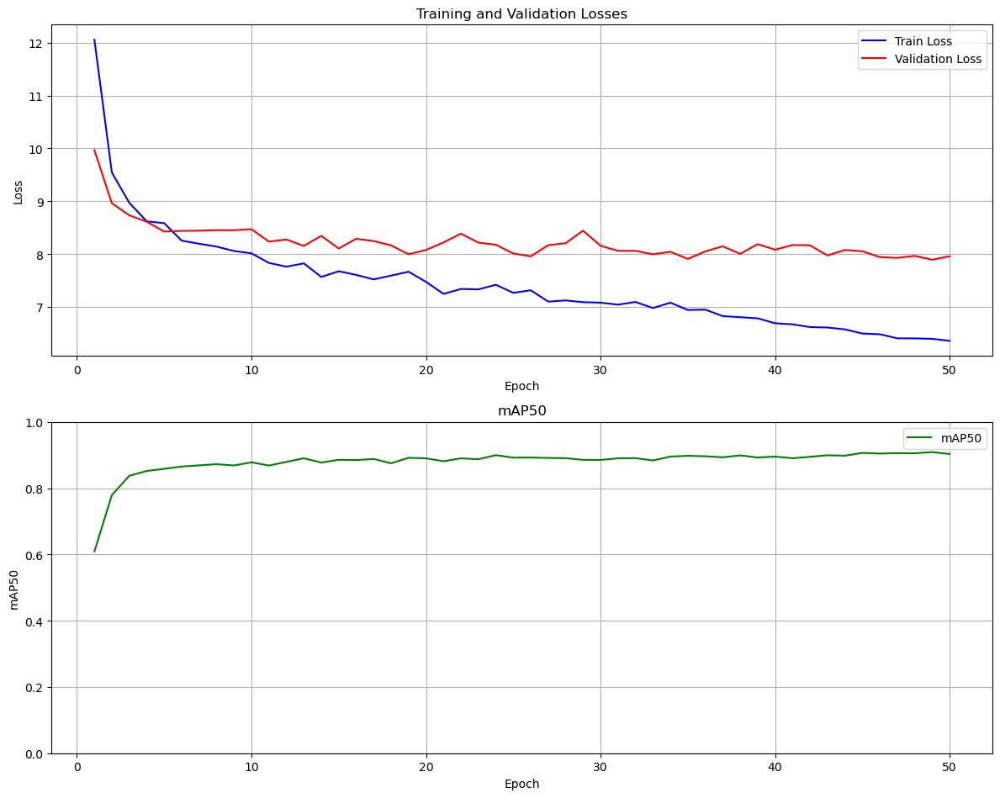

In [ ]:
### Plots
results_path = os.path.join(cwd, "yolo_football_analysis", "yolo9c_dataset_baseline_custom_loss_increased_cls_weight_lr_0_0001", "results.csv")
data = pd.read_csv(results_path)
plot_metrics(data, cls_weight=4.0)

### Quantitative test

In [ ]:
# Test the model on the test set
model = YOLO(r"yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_increased_cls_weight_lr_0_0001\weights\best.pt")
model = model.cuda()
model.val(data=os.path.join(dataset_path, "data.yaml"), split="test", project="yolo_football_test", name="yolo9c_dataset_baseline_custom_loss_increased_cls_weight_lr_0_0001")


YOLOv9c summary (fused): 384 layers, 25,322,332 parameters, 0 gradients, 102.3 GFLOPs


val: Scanning C:\Users\laura\OneDrive\Desktop\Magistrale\Machine_learning_for_vision\YOLOSoccerDetection\dataset\v0\test\labels.cache... 60 images, 0 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:23<00:00,  5.91s/it]


                   all         60       1452      0.922      0.862      0.892      0.651
                  ball         52         53      0.842      0.502      0.608      0.285
            goalkeeper         40         41      0.927      0.976      0.976      0.749
                player         60       1202      0.981      0.994      0.994      0.818
               referee         60        156      0.938      0.975      0.989      0.751
Speed: 6.9ms preprocess, 87.8ms inference, 0.0ms loss, 114.5ms postprocess per image
Results saved to yolo_football_test\yolo9c_dataset_baseline_custom_loss_new_parameters_lr_0_0001


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001E603FB4C10>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
       

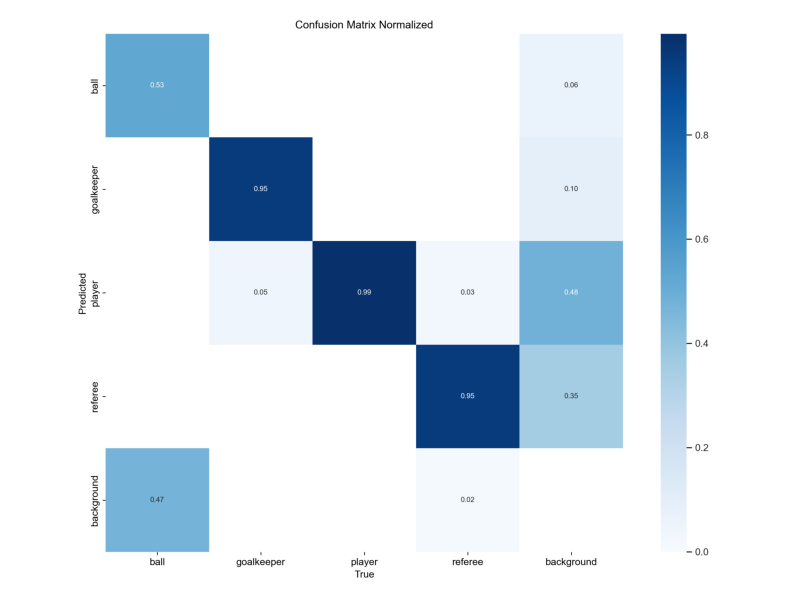

In [ ]:
# load and show confusion matrix
matrix_path = os.path.join(cwd, "yolo_football_test", "yolo9c_dataset_baseline_custom_loss_increased_cls_weight_lr_0_0001", "confusion_matrix_normalized.png")
plot_confusion_matrix(matrix_path)

### Qualitative Analysis on Challenging Samples

The qualitative analysis is based on three distinct samples:  
1. The first shows a stretched ball.  
2. The second features the ball under dim lighting conditions.  
3. The third depicts the ball partially occluded by a player.  

The purpose of this qualitative test is to assess the model’s performance under difficult conditions.


image 1/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\538438_1_10_png_jpg.rf.f0585e46a9ae3f1d0f64c24aaf7704b8.jpg: 736x1280 1 ball, 21 players, 2 referees, 78.7ms
image 2/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\Screenshot-2025-01-03-112748_png.rf.763a7d889601c8b79d673b84cdc4ae64.jpg: 736x1280 1 ball, 1 goalkeeper, 20 players, 2 referees, 65.6ms
image 3/3 c:\Users\siani\OneDrive\Desktop\Magistrale\ML4VMM\Project\YOLOSoccerDetection\code\training\..\..\dataset\yolov9\qualitative_analysis\input\c01561_1_6_png_jpg.rf.260b489d60904fa09f43dfb8daa38056.jpg: 736x1280 1 goalkeeper, 20 players, 2 referees, 70.3ms
Speed: 7.4ms preprocess, 71.5ms inference, 2.8ms postprocess per image at shape (1, 3, 736, 1280)


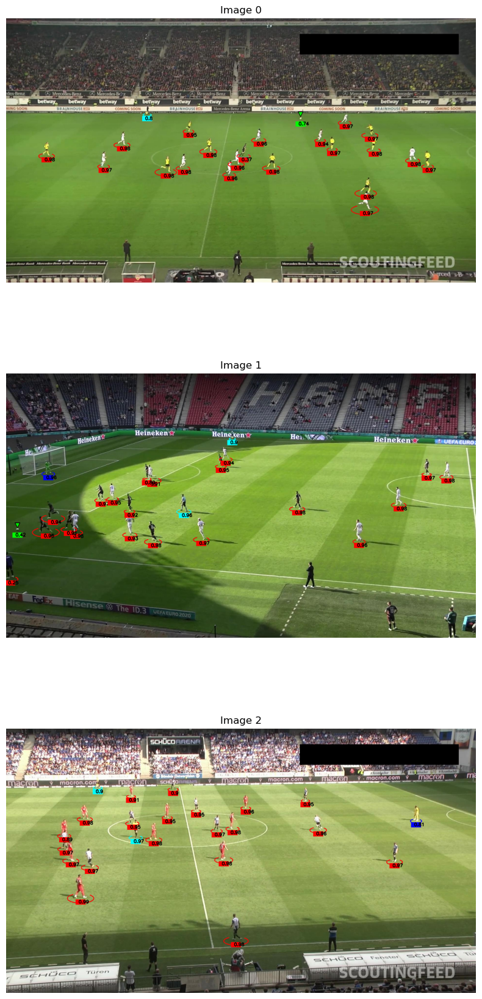

In [ ]:
detect_images(images_to_test_path, r"yolo_football_analysis\yolo9c_dataset_baseline_custom_loss_increased_cls_weight_lr_0_0001\weights\best.pt")

Result: 
1. Detected with 0.74 confidence
2. Detected with 0.42 confidence
3. Undetected